In [1]:
import psycopg2
import pandas as pd
from pandas import DataFrame
from pandas import concat
from pandas import Series

import matplotlib.pyplot as plt
import geopandas as gpd
import numpy as np
import itertools

import numpy
from numpy import concatenate
from numpy import array

import seaborn as sns

import math
from math import sqrt

# ARIMA AND LSTM STUFF
from statsmodels.tsa.arima_model import ARIMA
from statsmodels.tools.eval_measures import rmse

from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from keras.preprocessing.sequence import TimeseriesGenerator
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM
from keras.layers import Dropout

import time
import statsmodels.api as sm
import warnings

Using TensorFlow backend.


In [2]:
connection = psycopg2.connect(user = "equipo7",
                            password = "DLgndXy2m4hbWH-qn-Co",
                            host= "ds4a-demo-instance.cssn41frspmj.us-east-1.rds.amazonaws.com",
                            port = "5432",
                            database = "anahuac")
cursor = connection.cursor()
def runquery(query):
    df=pd.read_sql(query,connection)
    return df


def pivot_by_factor(df, index_table, column_table, value_table):
    df = pd.pivot_table(df, index = index_table, columns = column_table, values = value_table)
    df = df.sort_index(axis=1, level=1)
    df.columns = [f'{b}_{a}' for a, b in df.columns]
    df = df.reset_index()
    return df



## Load data from database

It was decided to take **2012 to 2018** as training data, **2019** as test and **january to february 2020** 
as validation for models, For base model **ARIMA**, it was decided to take **2015 to 2018** as trainig.

In [3]:
where_date_clause = " WHERE date >= '2012-01-01' AND date <= '2020-03-01 00:00:00' ORDER BY date"; 

sqlQuery_radiacion = "select * from processed_metrics.radiacion " + where_date_clause
df_radiacion = pd.DataFrame(runquery(sqlQuery_radiacion))

sqlQuery_rama = "select * from processed_metrics.rama " + where_date_clause
df_rama = pd.DataFrame(runquery(sqlQuery_rama))

sqlQuery_redmet = "select * from processed_metrics.redmet " + where_date_clause
df_redmet = pd.DataFrame(runquery(sqlQuery_redmet))

sqlQuery_presion = "select * from processed_metrics.presion " + where_date_clause
df_presion = pd.DataFrame(runquery(sqlQuery_presion))

sqlQuery_weather = "select date,fecha,hora,dewp_c AS dew_point_st,rh_st AS rain_st from processed_metrics.weather_fix  " + where_date_clause
df_weather = pd.DataFrame(runquery(sqlQuery_weather))

In [4]:
#radiation only has data until 2019-12-31 23:00:00. pressure has one more month but we will not consider it
#process radiation
df_radiacion = pivot_by_factor(df_radiacion,["date","fecha","hora"],["factor"],["st"])

#process pa
df_presion.rename(columns={'st': 'PA_st'}, inplace=True)
del df_presion['factor']

#process pollutants
df_rama = pivot_by_factor(df_rama,["date","fecha","hora"],["factor"],["st0","st1","st2"])

#process redmet
df_redmet = pivot_by_factor(df_redmet,["date","fecha","hora"],["factor"],["st0","st1","st2"])

#weather, we are interested in rain and dewpoint, already cleaned when reading from DB


In [5]:
#df_rama, df_redmet,df_weather 71568
#df_presion                    70824
#df_radiacion                  70128
dfs = [df_presion, df_radiacion, df_rama, df_redmet, df_weather]
for df in dfs:
    print("Shape : {} ".format(df.shape))
    print("NaN : {}\n".format(df.isna().sum()))

Shape : (70824, 4) 
NaN : date     0
fecha    0
hora     0
PA_st    8
dtype: int64

Shape : (70128, 5) 
NaN : date       0
fecha      0
hora       0
UVA_st     0
UVB_st    22
dtype: int64

Shape : (71568, 30) 
NaN : date        0
fecha       0
hora        0
CO_st0      0
CO_st1      0
CO_st2      0
NO_st0      0
NO_st1      0
NO_st2      0
NO2_st0     0
NO2_st1     0
NO2_st2     0
NOX_st0     0
NOX_st1     0
NOX_st2     0
O3_st0      0
O3_st1      0
O3_st2      0
PM10_st0    0
PM10_st1    0
PM10_st2    0
PM25_st0    0
PM25_st1    0
PM25_st2    0
PMCO_st0    0
PMCO_st1    0
PMCO_st2    0
SO2_st0     0
SO2_st1     0
SO2_st2     0
dtype: int64

Shape : (71568, 15) 
NaN : date       0
fecha      0
hora       0
RH_st0     0
RH_st1     0
RH_st2     0
TMP_st0    0
TMP_st1    0
TMP_st2    0
WDR_st0    0
WDR_st1    0
WDR_st2    0
WSP_st0    0
WSP_st1    0
WSP_st2    0
dtype: int64

Shape : (71569, 5) 
NaN : date            0
fecha           0
hora            0
dew_point_st    0
rain_st         

In [6]:
#merge all data as one
from functools import reduce
dfs = [df_rama, df_redmet, df_presion, df_radiacion, df_weather]
df_workspace = reduce(lambda left,right: pd.merge(left,right,on=['date','fecha','hora'], how='left'), dfs)


In [7]:
pd.options.display.max_columns = 999
df_workspace.describe()

,hora,CO_st0,CO_st1,CO_st2,NO_st0,NO_st1,NO_st2,NO2_st0,NO2_st1,NO2_st2,NOX_st0,NOX_st1,NOX_st2,O3_st0,O3_st1,O3_st2,PM10_st0,PM10_st1,PM10_st2,PM25_st0,PM25_st1,PM25_st2,PMCO_st0,PMCO_st1,PMCO_st2,SO2_st0,SO2_st1,SO2_st2,RH_st0,RH_st1,RH_st2,TMP_st0,TMP_st1,TMP_st2,WDR_st0,WDR_st1,WDR_st2,WSP_st0,WSP_st1,WSP_st2,PA_st,UVA_st,UVB_st,dew_point_st,rain_st
count,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,71568.000000,70816.000000,70128.000000,70106.000000,71568.000000,71568.000000
mean,11.500000,2.182823,2.203050,2.081737,18.016768,20.176152,16.649986,21.182147,24.028906,26.303062,37.527822,42.670791,41.453449,26.150818,24.433781,26.526687,42.394069,41.737729,37.421369,21.536756,20.398711,21.329896,24.332201,18.727931,18.767031,4.678177,6.856083,5.269888,49.147826,47.478265,44.913127,16.119404,15.662929,16.231786,145.936296,178.236301,153.656762,3.419663,3.605691,3.703279,584.714499,1.136723,0.794620,6.731408,47.179739
std,6.922235,1.123193,1.099021,0.961933,24.556083,27.079109,21.200509,8.878447,10.739216,11.030540,29.855118,33.650039,27.917166,21.850953,21.753261,24.863987,22.786816,23.083274,18.593995,11.729484,9.858530,11.206853,15.100402,9.768986,10.314238,4.690320,8.250563,5.738544,17.250471,17.572888,16.340480,4.602234,4.775755,4.298233,52.488105,63.454682,66.697521,1.704319,1.791158,1.790861,1.551186,1.593015,1.260779,4.170254,16.810723
min,0.000000,0.014286,0.014286,0.012500,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,0.500000,0.455464,0.250000,0.000000,0.000000,0.000000,0.500000,0.000000,0.875000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.444440,4.833330,5.333330,1.800000,1.966670,2.875000,5.250000,4.500000,5.750000,0.275000,0.300000,0.300000,577.000000,0.000000,0.000000,-10.815000,5.759260
25%,5.750000,1.437500,1.444440,1.400000,4.888890,5.571430,4.500000,14.500000,16.333300,18.571400,18.142900,21.125000,22.333300,8.000000,7.000000,6.714290,26.000000,25.375000,24.000000,13.500000,13.666700,13.500000,15.000000,12.250000,11.666700,2.625000,3.000000,2.750000,35.666700,33.333300,32.000000,12.683300,11.900000,12.900000,110.222000,134.200000,102.400000,1.866670,1.933330,2.075000,583.733000,0.000000,0.000000,4.200000,33.916700
50%,11.500000,2.120900,2.214290,2.128570,8.176190,9.375000,8.000000,20.139400,22.200000,24.777800,27.900000,31.750000,33.500000,19.457100,17.166700,17.333300,38.250000,37.000000,34.428600,19.400000,18.750000,19.312500,21.186400,17.250000,17.000000,3.555560,4.125000,3.714290,50.888900,49.000000,45.428600,16.322200,16.056200,16.500000,140.000000,185.750000,145.800000,3.288890,3.628570,3.566670,584.800000,0.062775,0.011250,6.951380,48.634900
75%,17.250000,2.866670,2.925000,2.744440,19.777800,22.400000,19.833300,26.500000,29.625000,32.333300,46.111100,51.750000,51.964325,40.300000,36.777800,40.262350,54.166700,52.750000,47.571400,27.000000,25.333300,26.857100,30.000000,23.500000,24.000000,4.888890,7.000000,5.250000,63.500000,62.600000,58.166700,19.587500,19.314300,19.520000,177.875000,226.857000,207.750000,4.757140,5.060000,5.140000,585.800000,2.112132,1.272362,9.478927,61.355600
max,23.000000,11.600000,8.700000,7.166670,250.000000,270.000000,281.125000,81.666700,111.000000,101.333000,285.300000,316.571000,314.250000,122.778000,139.000000,149.200000,273.133000,343.250000,317.000000,250.000000,130.667000,224.250000,244.667000,195.000000,249.000000,91.857100,158.833000,151.375000,84.444400,82.142900,82.857100,29.655600,28.314300,28.583300,310.556000,304.429000,300.429000,10.466700,9.943330,9.600000,592.00

In [8]:
df_workspace

,date,fecha,hora,CO_st0,CO_st1,CO_st2,NO_st0,NO_st1,NO_st2,NO2_st0,NO2_st1,NO2_st2,NOX_st0,NOX_st1,NOX_st2,O3_st0,O3_st1,O3_st2,PM10_st0,PM10_st1,PM10_st2,PM25_st0,PM25_st1,PM25_st2,PMCO_st0,PMCO_st1,PMCO_st2,SO2_st0,SO2_st1,SO2_st2,RH_st0,RH_st1,RH_st2,TMP_st0,TMP_st1,TMP_st2,WDR_st0,WDR_st1,WDR_st2,WSP_st0,WSP_st1,WSP_st2,PA_st,UVA_st,UVB_st,dew_point_st,rain_st
0,2012-01-01 00:00:00,2012-01-01,0,1.38000,1.15714,1.06585,25.375,19.75000,28.6872,33.750,37.2500,27.7195,59.125,56.6250,57.9645,5.0,4.42857,5.28571,249.40,110.5000,88.3333,69.4000,58.0000,51.6000,13.0000,15.3333,17.50,7.100,7.750,5.66667,64.875,53.7500,45.7500,8.1000,7.0000,7.7500,116.3350,97.000,148.000,1.06000,0.933333,1.15000,587.000,0.0,0.0,-1.425000,54.7917
1,2012-01-01 01:00:00,2012-01-01,1,1.58000,1.57143,1.63169,24.750,31.75000,43.3743,33.375,35.7500,31.1533,57.750,67.1250,76.0720,6.0,3.28571,2.00000,127.80,132.8330,145.3330,127.2000,77.3333,89.2000,31.3333,19.6667,29.00,8.600,8.000,6.66667,67.500,56.7500,50.2500,7.7500,6.7000,7.5250,72.3367,165.000,111.000,1.44000,1.300000,1.40000,587.000,0.0,0.0,-1.041670,58.1667
2,2012-01-01 02:00:00,2012-01-01,2,1.71000,1.95714,1.72000,28.500,36.75000,31.3333,30.875,35.6250,32.5000,59.000,71.8750,63.5000,5.8,4.71429,1.85714,114.20,170.0000,139.3330,116.8000,76.3333,91.4000,32.6667,18.6667,27.25,7.100,6.875,6.16667,69.000,57.5000,52.7500,7.3875,6.6000,7.3250,165.4000,194.250,183.250,1.44000,1.150000,1.22500,587.000,0.0,0.0,-0.945833,59.7500
3,2012-01-01 03:00:00,2012-01-01,3,2.16000,2.20000,2.20000,45.875,49.37500,36.0000,31.000,33.5000,31.5000,76.500,82.2500,67.0000,5.6,4.14286,2.57143,129.80,153.8330,130.5000,113.2000,84.3333,96.4000,33.6667,20.6667,26.25,6.500,6.125,5.66667,70.375,59.7500,53.0000,6.9625,6.3750,7.2750,151.4000,194.000,149.000,1.40000,1.425000,1.60000,587.000,0.0,0.0,-0.920833,61.0417
4,2012-01-01 04:00:00,2012-01-01,4,2.44000,2.12857,2.72000,62.875,36.12500,51.6667,28.750,30.5000,29.6667,91.375,65.7500,80.8333,5.7,4.14286,2.57143,133.20,127.3330,138.8330,109.8000,58.6667,100.0000,30.6667,14.3333,25.50,5.600,4.875,5.50000,72.750,60.7500,54.0000,6.4875,6.1750,7.3250,109.6000,197.500,175.250,1.48000,1.575000,1.65000,587.000,0.0,0.0,-0.837500,62.5000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
71563,2020-02-29 19:00:00,2020-02-29,19,2.56667,2.42222,2.48889,6.375,5.33333,8.5000,30.400,30.6667,32.3333,33.500,34.3333,38.2500,36.3,26.11110,30.44440,53.25,60.1667,41.3333,23.1429,17.6667,20.2857,24.3333,25.0000,27.60,4.750,6.000,6.11111,25.125,24.0000,19.6667,21.5333,21.5143,22.1714,119.0000,244.429,224.143,4.70000,4.342860,4.62857,585.217,NaN,NaN,6.325780,22.9306
71564,2020-02-29 20:00:00,2020-02-29,20,2.72222,2.68889,2.76667,5.375,8.77778,5.3750,31.400,38.6667,37.8889,33.250,44.8889,41.1250,41.4,20.22220,35.00000,70.25,77.6667,63.0000,31.0000,20.6667,28.7143,39.0000,34.0000,40.00,5.125,6.400,4.77778,30.750,30.0000,27.6667,20.1444,19.8429,20.5857,115.6360,182.857,95.000,4.52727,4.042860,4.31429,585.883,NaN,NaN,6.085450,29.4722
71565,2020-02-29 21:00:00,2020-02-29,21,2.95556,3.06667,2.92222,5.125,14.33330,3.7500,35.600,46.4444,39.8889,37.125,58.3333,42.1250,38.5,12.77780,32.22220,71.00,59.5000,64.6667,35.4286,24.3333,30.7143,40.3333,36.0000,38.20,5.125,6.500,4.88889,34.000,34.8571,31.8333,19.2222,18.7857,19.5286,134.7270,174.571,129.286,4.50000,3.914290,4.38571,586.317,NaN,NaN,9.600000,33.5635
71566,2020-02-29 22:00:00,2020-02-29,22,3.04444,3.30000,2.95556,5.375,26.55560,4.0000,33.300,49.4444,34.8889,37.250,73.5556,36.5000,39.9,8.55556,33.66670,63.00,63.0000,60.5000,31.2857,24.6667,30.4286,35.6667,34.3333,35.60,5.375,7.000,5.00000,36.250,39.4286,34.1667,18.4111,17.5571,18.6857,142.9090,208.000,133.714,4.20909,3.942860,4.40000,586.417,NaN,NaN,5.540990,36.6151


In [9]:
df_workspace.columns

Index(['date', 'fecha', 'hora', 'CO_st0', 'CO_st1', 'CO_st2', 'NO_st0',
       'NO_st1', 'NO_st2', 'NO2_st0', 'NO2_st1', 'NO2_st2', 'NOX_st0',
       'NOX_st1', 'NOX_st2', 'O3_st0', 'O3_st1', 'O3_st2', 'PM10_st0',
       'PM10_st1', 'PM10_st2', 'PM25_st0', 'PM25_st1', 'PM25_st2', 'PMCO_st0',
       'PMCO_st1', 'PMCO_st2', 'SO2_st0', 'SO2_st1', 'SO2_st2', 'RH_st0',
       'RH_st1', 'RH_st2', 'TMP_st0', 'TMP_st1', 'TMP_st2', 'WDR_st0',
       'WDR_st1', 'WDR_st2', 'WSP_st0', 'WSP_st1', 'WSP_st2', 'PA_st',
       'UVA_st', 'UVB_st', 'dew_point_st', 'rain_st'],
      dtype='object')

In [10]:
df_workspace.fillna(method='ffill', inplace=True)

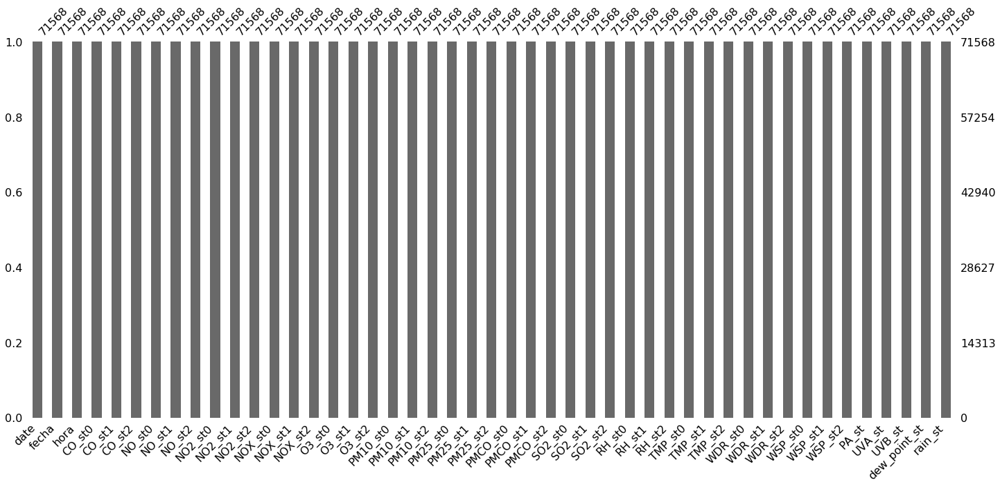

In [11]:
import missingno as msno 
#msno.matrix(df_workspace)  
msno.bar(df_workspace) 

In [12]:
def plot_resample_date(df,start_date,end_date, cols, resample_by):
    df[start_date:end_date][cols].resample(resample_by).mean().plot(figsize=(15, 6))
    plt.show()

In [13]:
# set date as index
df_workspace.set_index('date', inplace=True)

In [14]:
train_u_lstm      = df_workspace['2012-01-01':'2018-12-31']
test_u_lstm       = df_workspace['2019-01-01':'2019-12-31']
validation_u_lstm = df_workspace['2020-01-01':'2020-02-29']

train_hours_u_lstm      = len(train_u_lstm)
test_hours_u_lstm       = len(test_u_lstm)
validation_hours_u_lstm = len(validation_u_lstm)


print(train_u_lstm.shape)
print(test_u_lstm.shape)
print(validation_u_lstm.shape)


(61368, 46)
(8760, 46)
(1440, 46)


# Univariate LSTM

We used 7 years of training **(2012-01-01 to 2018-12-31)** and one year of training **(2019-09-01 to 2019-12-31)**.

We then evaluated train dataset and compared predicted values against the true values of year 2019 
(2557 total hours in 2019). 

We tried different combinations of hyperparameters for LSTM univariate model.
The best configuration we got is 
batch size = 1
epochs     = 30
neurons    = 4

In this case the average execution time to get all the models for all features was 1 hour. 
We ran 4 experiements varying how data is sampled. First experiment dataset is sampled by hour, the second experiment
data is sampled by 24 hrs.

We executed this cases varying the number of neurons having 4 and 8.  


In [15]:
from funcy import print_durations

# frame a sequence as a supervised learning problem
def timeseries_to_supervised(data, lag=1):
    df = DataFrame(data)
    columns = [df.shift(i) for i in range(1, lag+1)]
    columns.append(df)
    df = concat(columns, axis=1)
    df.fillna(0, inplace=True)
    return df
 
# create a differenced series
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
 
# invert differenced value
def inverse_difference(history, yhat, interval=1):
    return yhat + history[-interval]
 
# scale train and test data to [-1, 1]
def scale(train, test):
    # fit scaler
    scaler = MinMaxScaler(feature_range=(-1, 1))
    scaler = scaler.fit(train)
    # transform train
    train = train.reshape(train.shape[0], train.shape[1])
    train_scaled = scaler.transform(train)
    # transform test
    test = test.reshape(test.shape[0], test.shape[1])
    test_scaled = scaler.transform(test)
    return scaler, train_scaled, test_scaled
 
# inverse scaling for a forecasted value
def invert_scale(scaler, X, value):
    new_row = [x for x in X] + [value]
    array = numpy.array(new_row)
    array = array.reshape(1, len(array))
    inverted = scaler.inverse_transform(array)
    return inverted[0, -1]
 
# fit an LSTM network to training data
def fit_lstm(train, batch_size, nb_epoch, neurons):
    X, y = train[:, 0:-1], train[:, -1]
    X = X.reshape(X.shape[0], 1, X.shape[1])
    #initializing the neural network
    model = Sequential()
    #Long Short-Term Memory layer
    model.add(LSTM(
        neurons, 
        batch_input_shape = (batch_size, X.shape[1], X.shape[2]), 
        stateful=True)
             )
    #Dense is a layer type (fully connected layer)
    model.add(Dense(1))
    model.compile(loss='mean_squared_error', optimizer='adam')
    model.fit(X, y, epochs=nb_epoch, batch_size=batch_size, verbose=0, shuffle=False)
    #for i in range(nb_epoch):
    #    model.fit(X, y, epochs=1, batch_size=batch_size, verbose=0, shuffle=False)
    #    model.reset_states()
    return model
 
# make a one-step forecast
def forecast_lstm(model, batch_size, X):
    X = X.reshape(1, 1, len(X))
    yhat = model.predict(X, batch_size=batch_size)
    return yhat[0,0]
 
@print_durations()
def evaluate_lst_model(data, training_hours, test_hours, name_model):
    # transform data to be stationary
    raw_values = data.values
    diff_values = difference(raw_values, 1)
    # transform data to be supervised learning
    supervised = timeseries_to_supervised(diff_values, 1)
    supervised_values = supervised.values
    # split data into train start:training_hours and test training_hours:end  sets
    train = supervised_values[0:training_hours]
    test  = supervised_values[training_hours: training_hours + test_hours]
    # transform the scale of the data
    scaler, train_scaled, test_scaled = scale(train, test)
    # fit the model
    # 1 batch size
    '''
    Online Learning (Batch Size = 1 hour),network weights are updated after each training example 
    This can have the effect of faster learning, but also adds instability to the learning process as the weights
    widely vary with each batch.
    Nevertheless, this will allow us to make one-step forecasts on the problem, that is what we want.
    '''
    # 30 epochs, 60
    #  4 neurons, 8
    lstm_model = fit_lstm(train_scaled, 1, 30, 4)
    # forecast the entire training dataset to build up state for forecasting
    train_reshaped = train_scaled[:, 0].reshape(len(train_scaled), 1, 1)
    lstm_model.predict(train_reshaped, batch_size=1)

    #save results
    f = open("results_lstm_u_model_"+name_model+".txt","w+")
    f.write("id\t Predicted\t Expected\n")
    
    # walk-forward validation on the test data
    predictions = list()
    for i in range(len(test_scaled)):
        # make one-step forecast
        X, y = test_scaled[i, 0:-1], test_scaled[i, -1]
        yhat = forecast_lstm(lstm_model, 1, X)
        # invert scaling
        yhat = invert_scale(scaler, X, yhat)
        # invert differencing
        yhat = inverse_difference(raw_values, yhat, len(test_scaled)+1-i)
        # store forecast
        predictions.append(yhat)
        expected = raw_values[len(train) + i + 1]
        f.write('%d\t %f\t %f\n' % (i+1, yhat, expected))        
    # report performance
    mse = mean_squared_error(raw_values[training_hours: training_hours + test_hours], predictions)
    f.write('MSE for test data: %.3f' % mse)
    print('MSE for test data: %.3f' % mse)
    print('Saving model')
    lstm_model.save("lstm_u_model_"+name_model+".pkl")
   


In [16]:
from joblib import Parallel, delayed
import multiprocessing
cpus = multiprocessing.cpu_count()
print("available processors: ", cpus )

available processors:  8


In [23]:
#lstm_univariate_models = ['CO_st0','NO_st0','NO2_st0', 'NOX_st0', 'O3_st0', 'PM10_st0', 'PM25_st0','PMCO_st0',
#                         'SO2_st0', 'RH_st0','TMP_st0', 'WDR_st0', 'WSP_st0',   'PA_st', 'UVA_st',   'UVB_st']       
#Parallel(n_jobs=multiprocessing.cpu_count())(delayed(evaluate_lst_model)(df_workspace[m], train_hours_u_lstm,test_hours_u_lstm, m) for m in lstm_univariate_models)        


In [ ]:
resample_by = 'D'
train_u_lstm_d      = df_workspace['2012-01-01':'2018-12-31'].resample(resample_by).mean()
test_u_lstm_d       = df_workspace['2019-01-01':'2019-12-31'].resample(resample_by).mean()
validation_u_lstm_d = df_workspace['2020-01-01':'2020-02-29'].resample(resample_by).mean()
df_workspace_d      = df_workspace.resample(resample_by).mean()   
train_hours_u_lstm_d      = len(train_u_lstm_d)
test_hours_u_lstm_d       = len(test_u_lstm_d)
validation_hours_u_lstm_d = len(validation_u_lstm_d)

In [ ]:
print(train_u_lstm_d.shape)
print(test_u_lstm_d.shape)
print(validation_u_lstm_d.shape)
print(df_workspace_d.shape)

In [ ]:
#lstm_univariate_models = ['CO_st0','NO_st0','NO2_st0', 'NOX_st0', 'O3_st0', 'PM10_st0', 'PM25_st0','PMCO_st0',
#                         'SO2_st0', 'RH_st0','TMP_st0', 'WDR_st0', 'WSP_st0',   'PA_st', 'UVA_st',   'UVB_st']       
#Parallel(n_jobs=multiprocessing.cpu_count())(delayed(evaluate_lst_model)(df_workspace_d[m], train_hours_u_lstm_d,test_hours_u_lstm_d, m) for m in lstm_univariate_models)        


# Results

batch1-epochs30-neurons-4/results_lstm_u_model_CO_st0.txt (8760, 3)
shown RMSE: 1.114


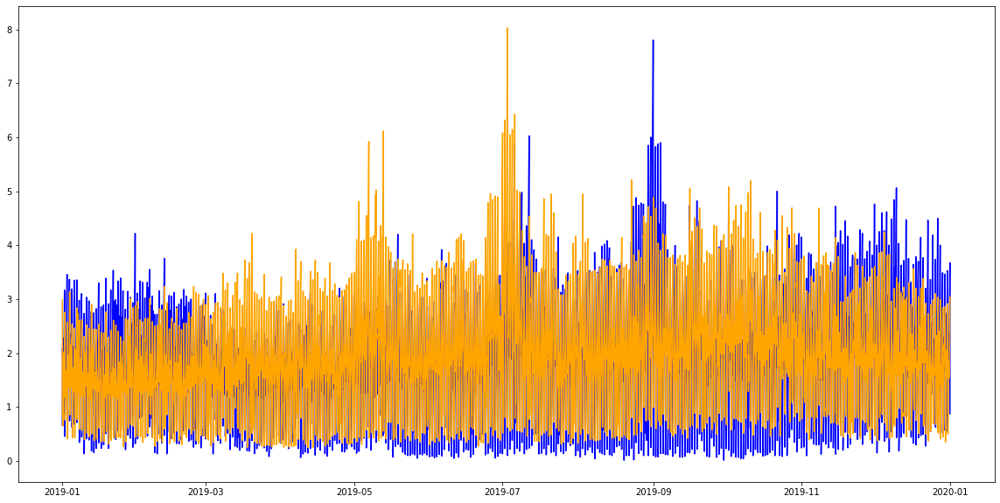

SAMPLED BY:  W


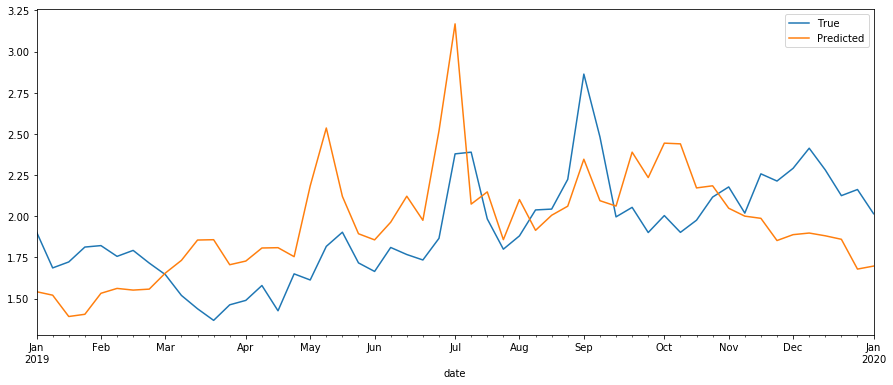

SAMPLED BY:  MS


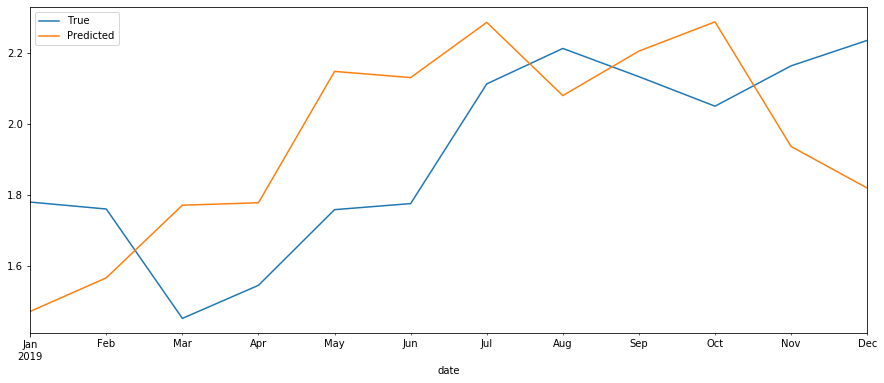

SAMPLED BY:  Q


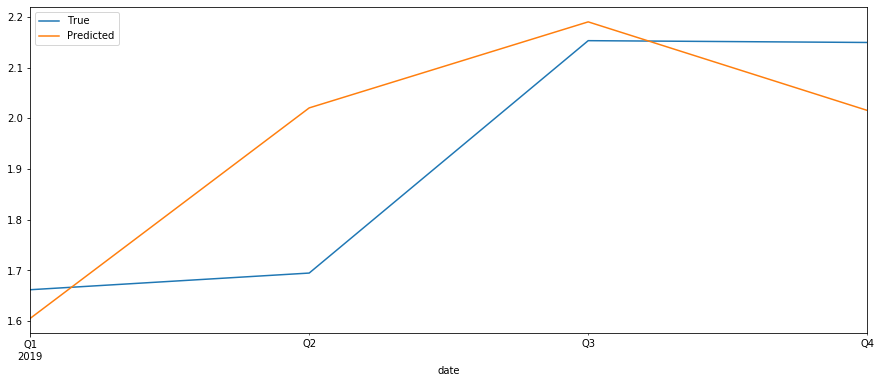

batch1-epochs30-neurons-4/results_lstm_u_model_NO_st0.txt (8760, 3)
shown RMSE: 23.978


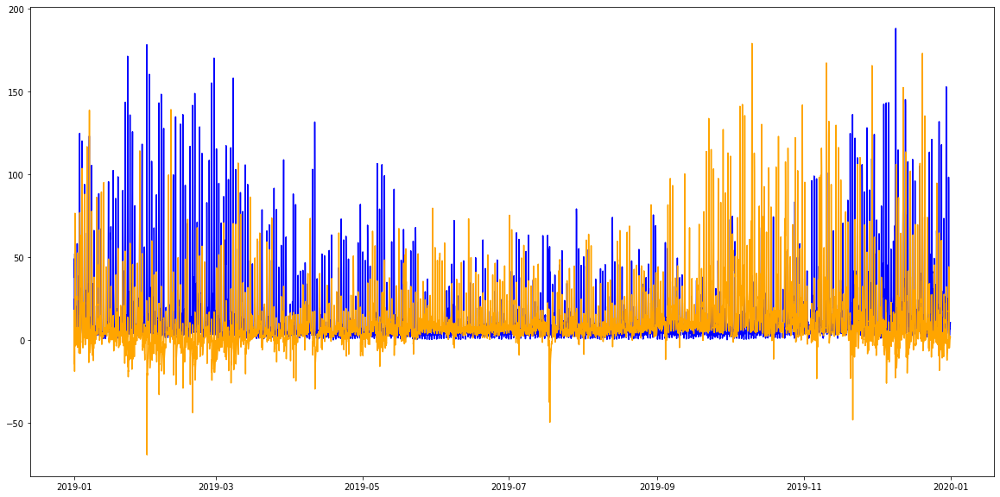

SAMPLED BY:  W


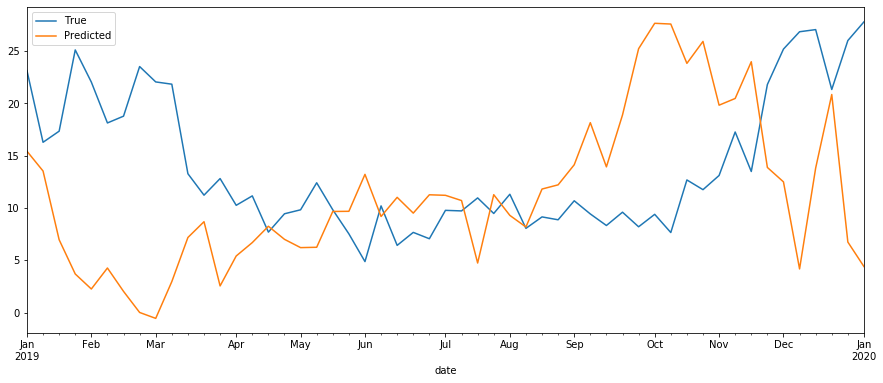

SAMPLED BY:  MS


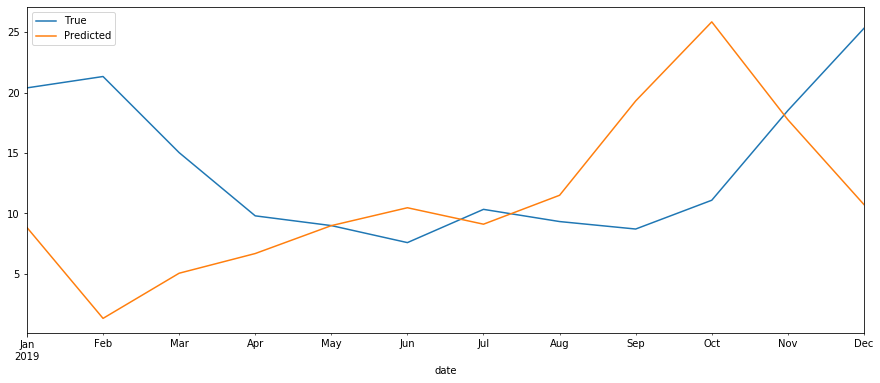

SAMPLED BY:  Q


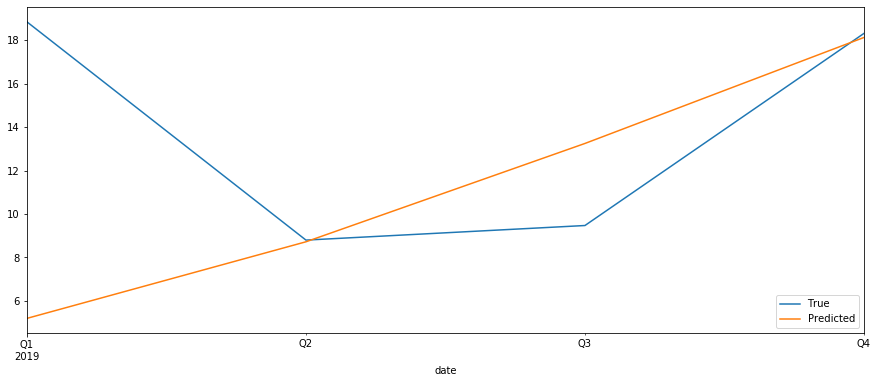

batch1-epochs30-neurons-4/results_lstm_u_model_NO2_st0.txt (8760, 3)
shown RMSE: 10.810


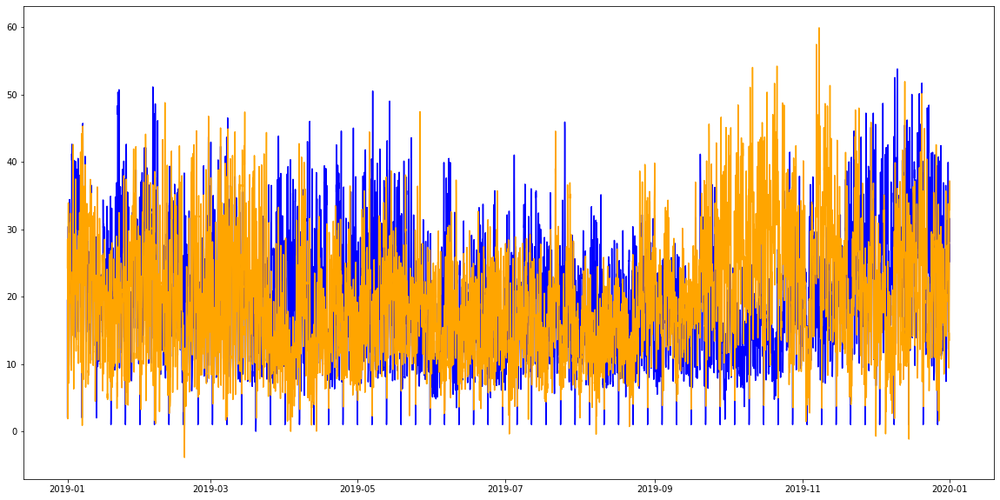

SAMPLED BY:  W


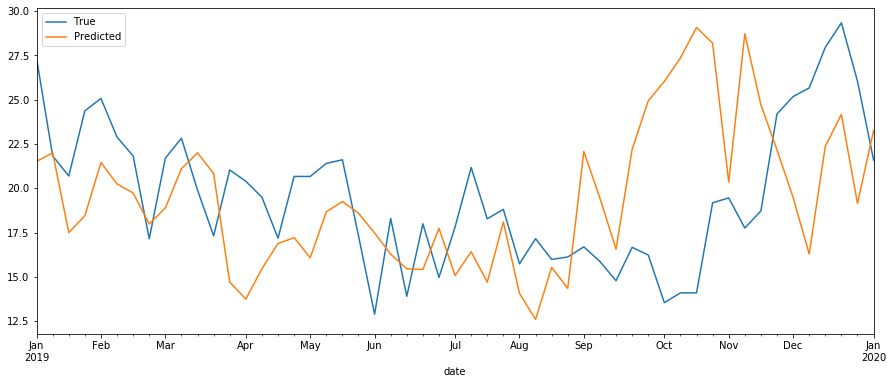

SAMPLED BY:  MS


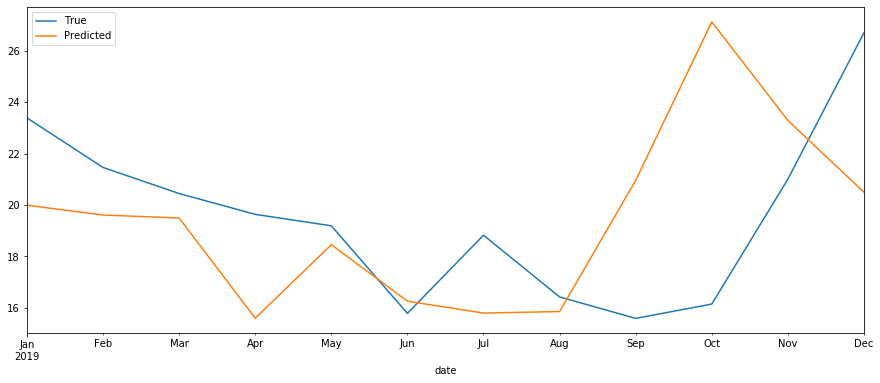

SAMPLED BY:  Q


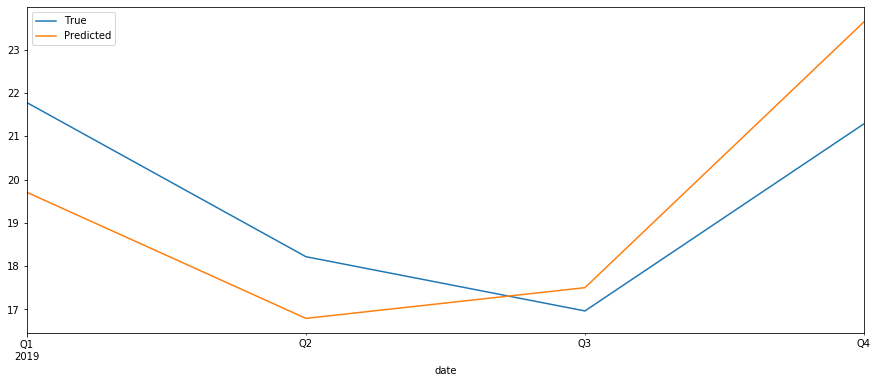

batch1-epochs30-neurons-4/results_lstm_u_model_NOX_st0.txt (8760, 3)
shown RMSE: 27.736


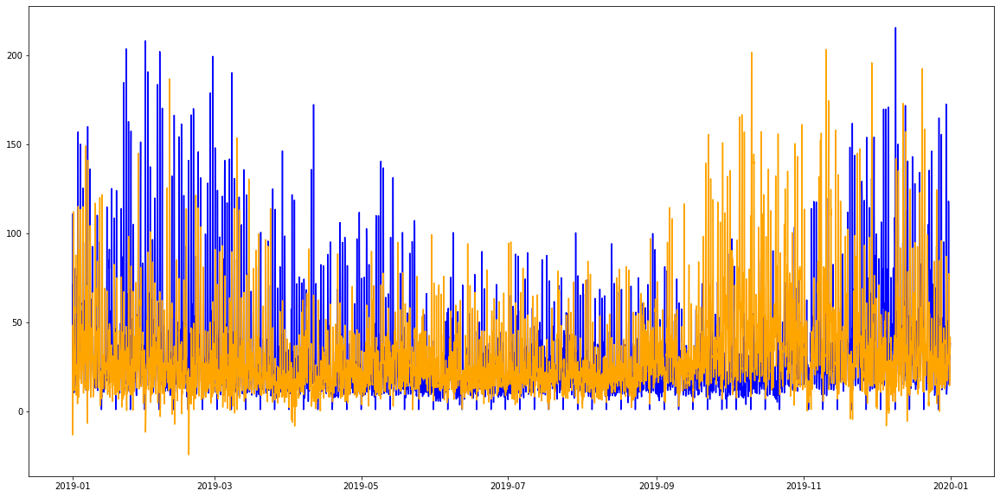

SAMPLED BY:  W


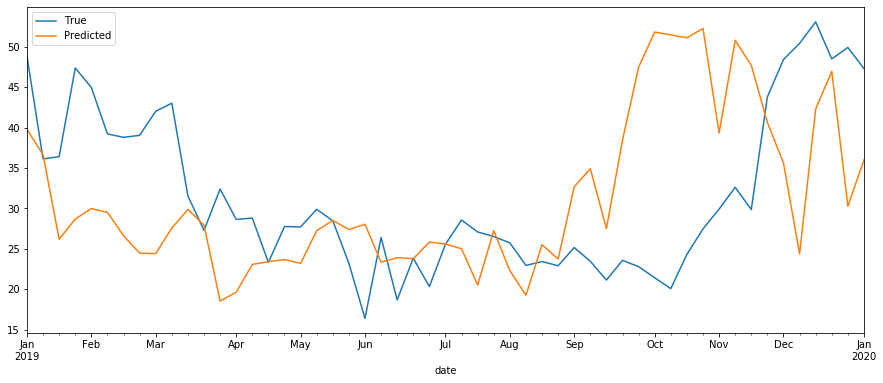

SAMPLED BY:  MS


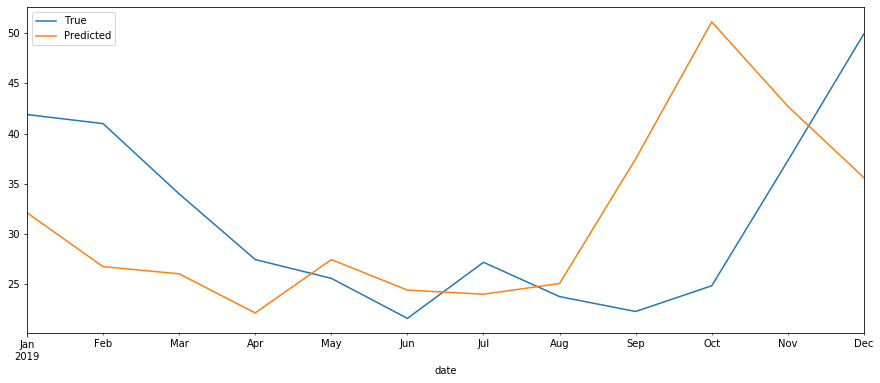

SAMPLED BY:  Q


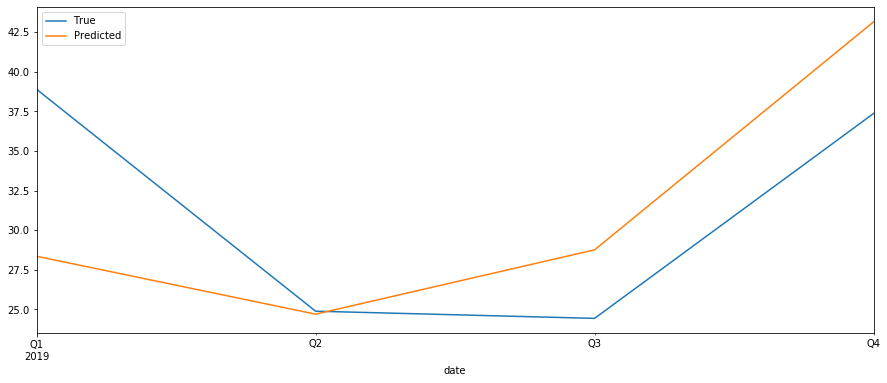

batch1-epochs30-neurons-4/results_lstm_u_model_O3_st0.txt (8760, 3)
shown RMSE: 16.627


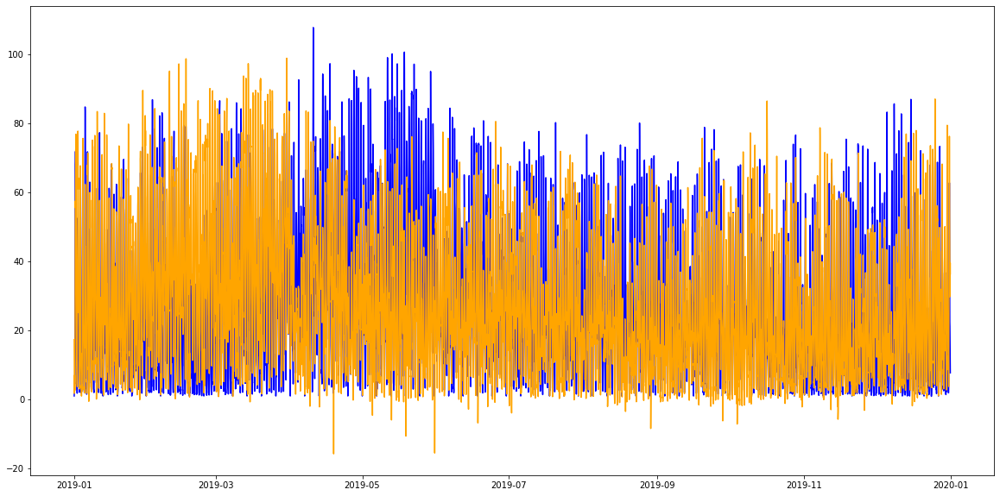

SAMPLED BY:  W


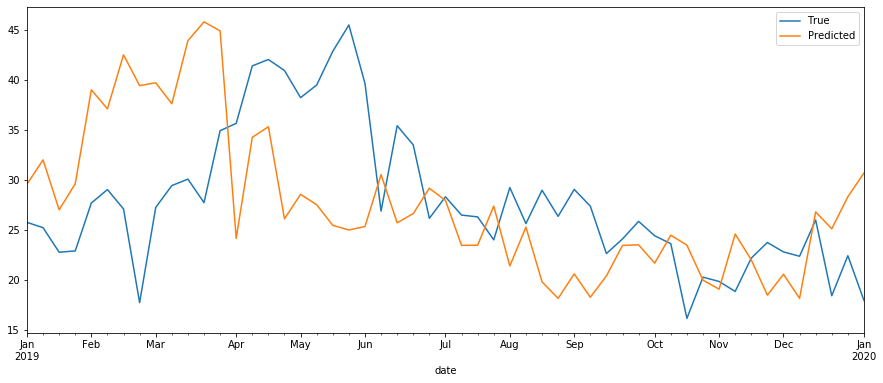

SAMPLED BY:  MS


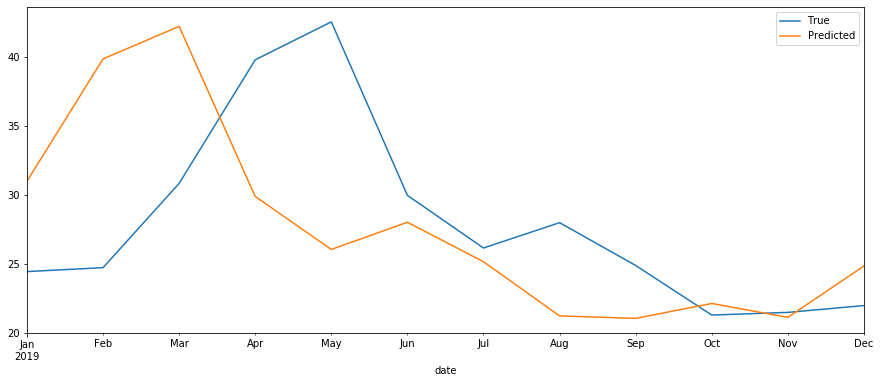

SAMPLED BY:  Q


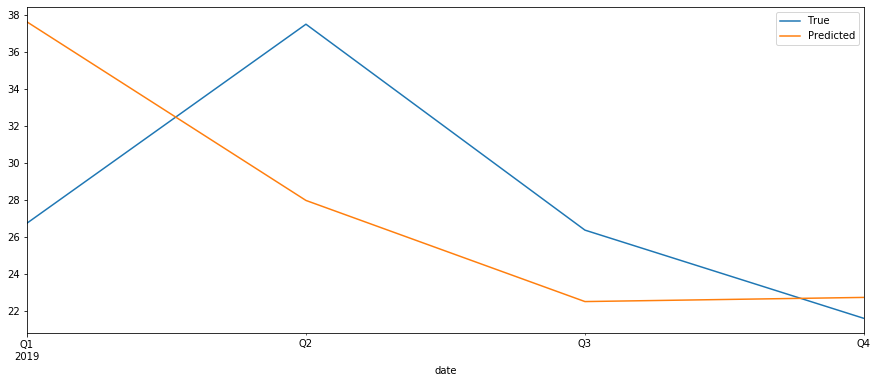

batch1-epochs30-neurons-4/results_lstm_u_model_PM10_st0.txt (8760, 3)
shown RMSE: 27.758


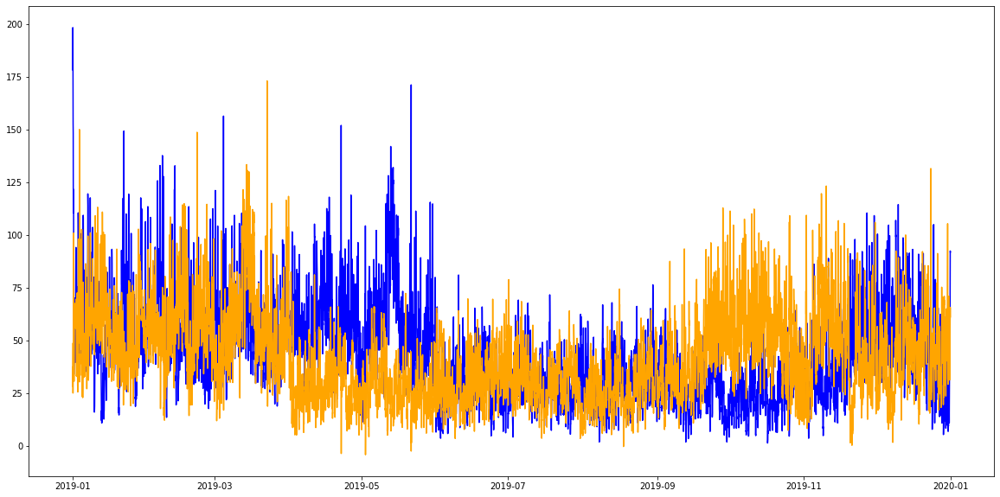

SAMPLED BY:  W


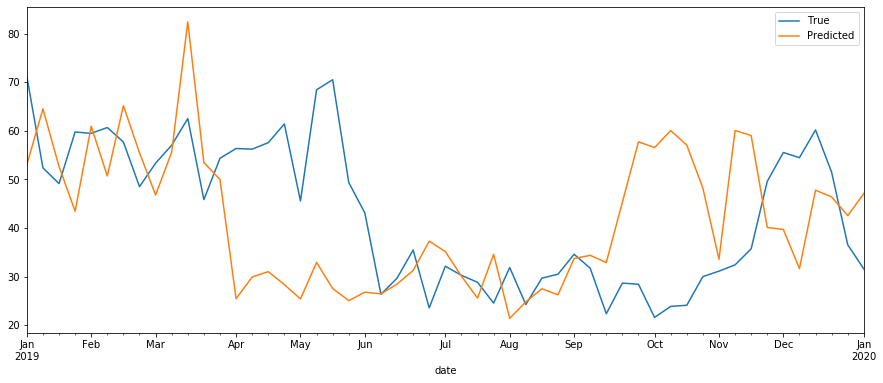

SAMPLED BY:  MS


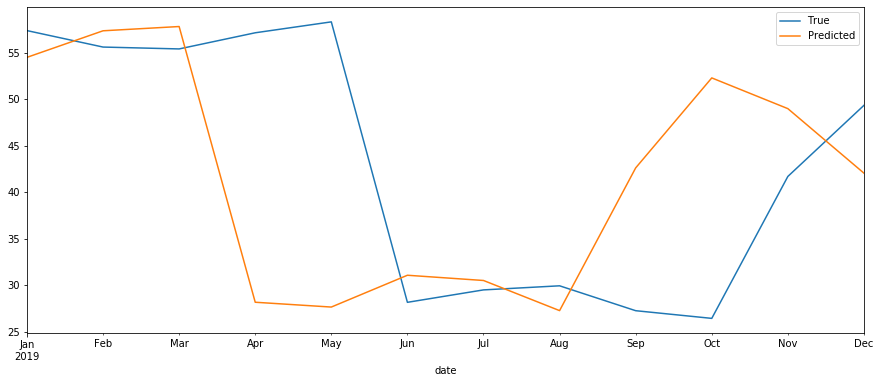

SAMPLED BY:  Q


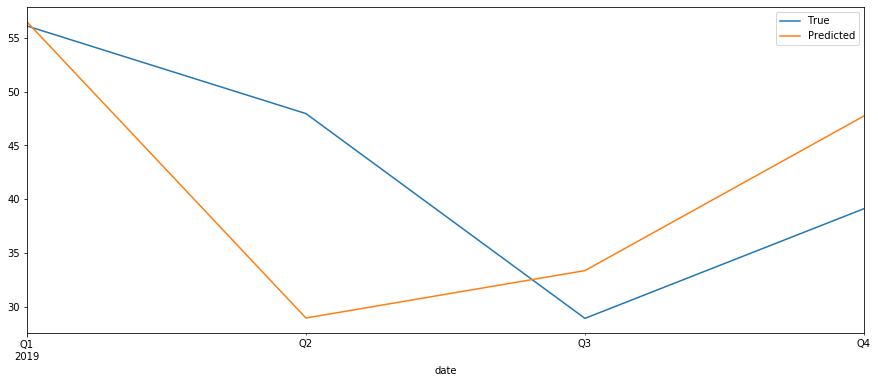

batch1-epochs30-neurons-4/results_lstm_u_model_PM25_st0.txt (8760, 3)
shown RMSE: 16.593


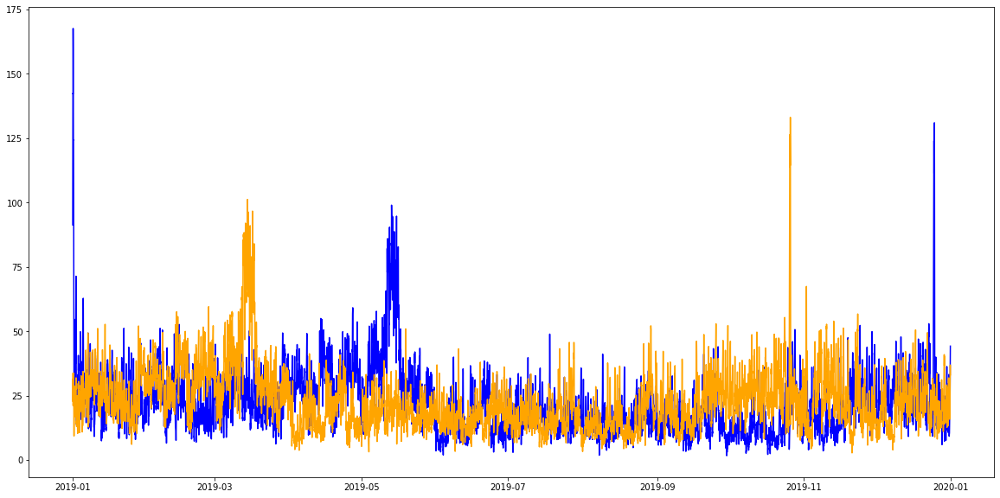

SAMPLED BY:  W


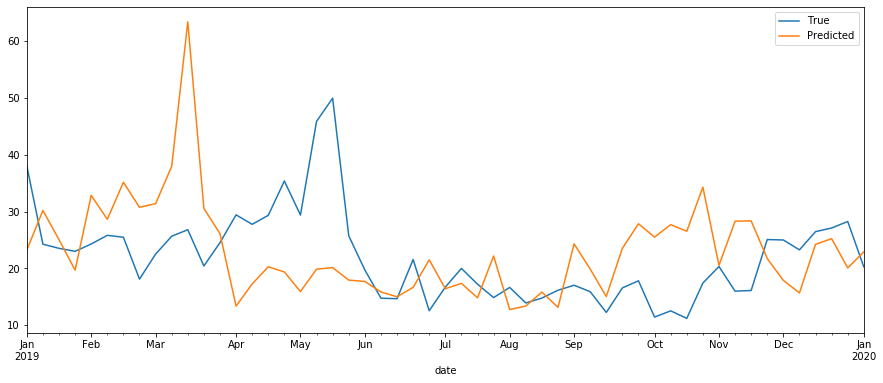

SAMPLED BY:  MS


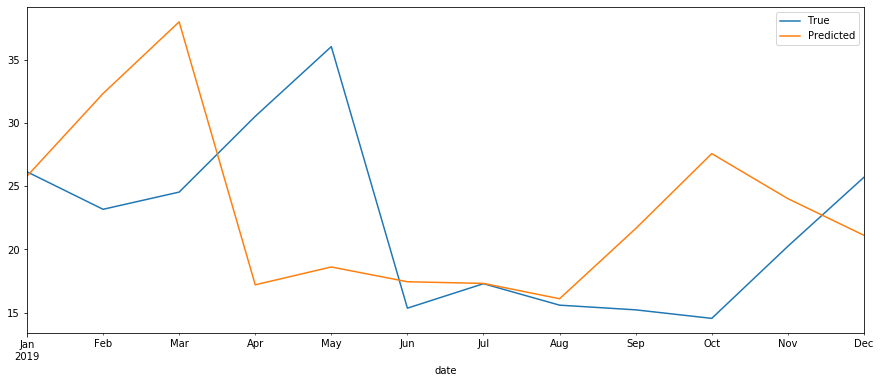

SAMPLED BY:  Q


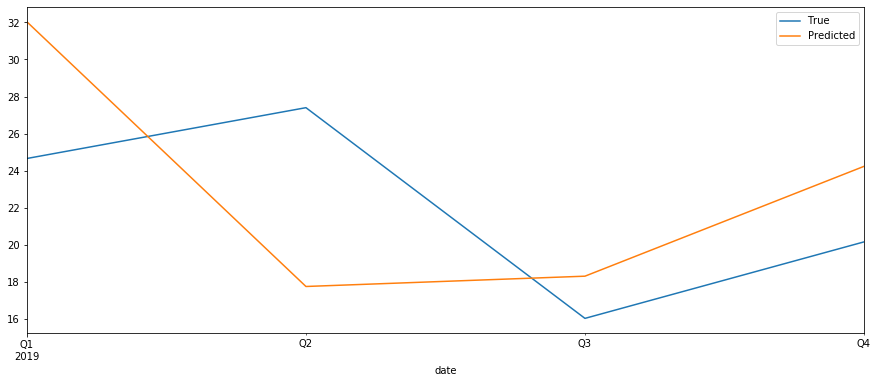

batch1-epochs30-neurons-4/results_lstm_u_model_PMCO_st0.txt (8760, 3)
shown RMSE: 17.366


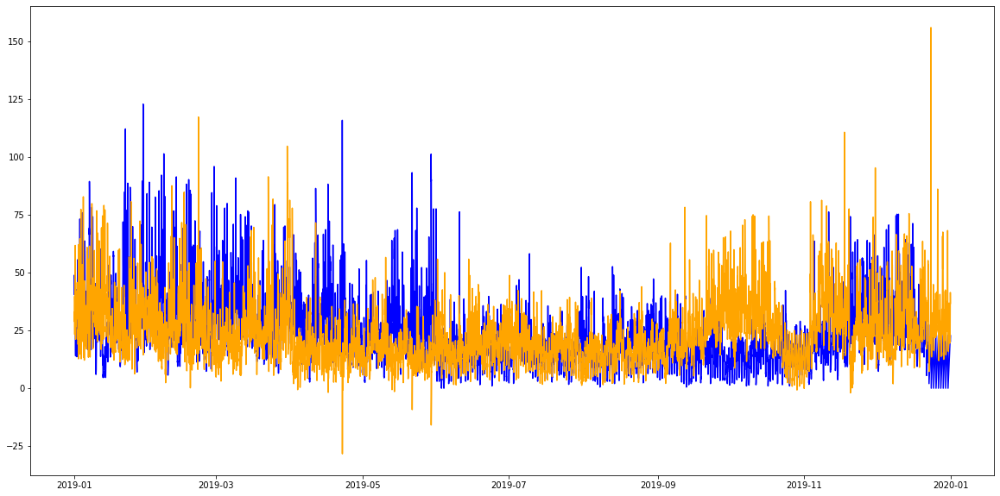

SAMPLED BY:  W


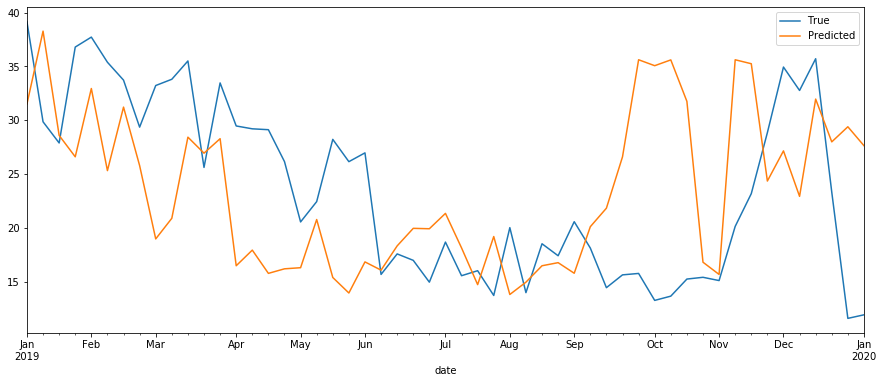

SAMPLED BY:  MS


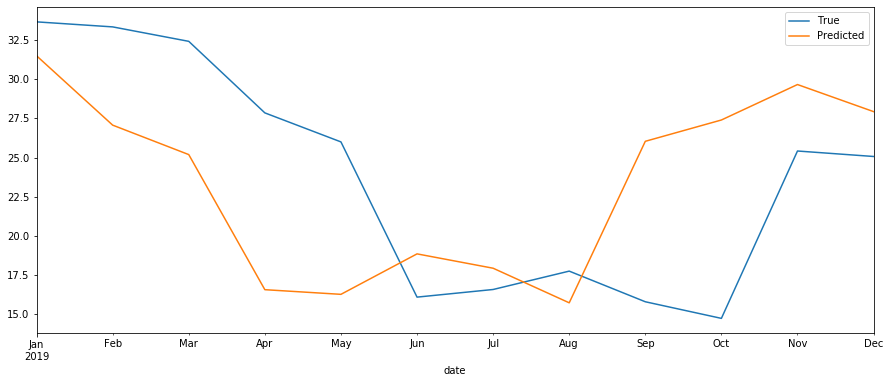

SAMPLED BY:  Q


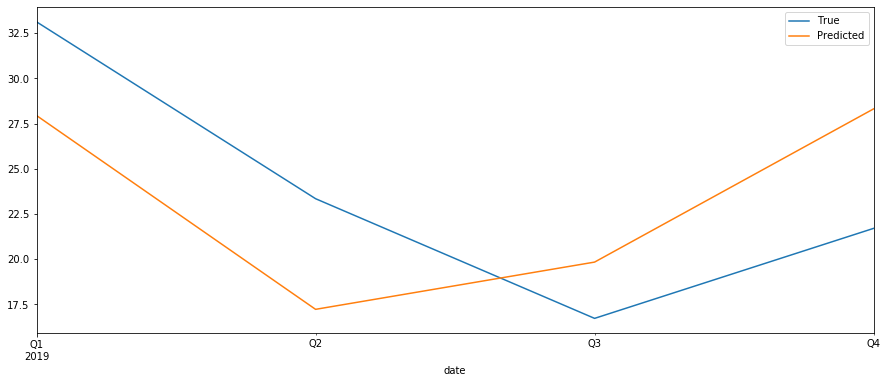

batch1-epochs30-neurons-4/results_lstm_u_model_SO2_st0.txt (8760, 3)
shown RMSE: 4.430


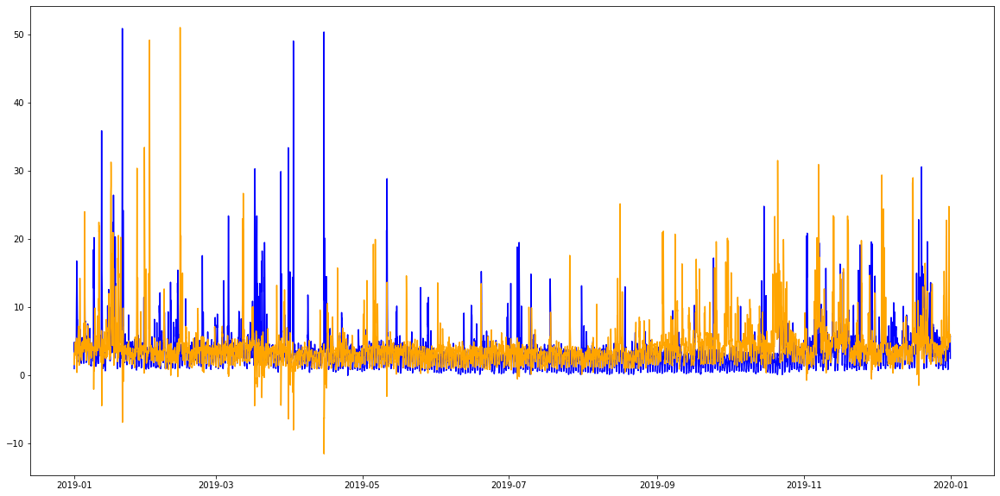

SAMPLED BY:  W


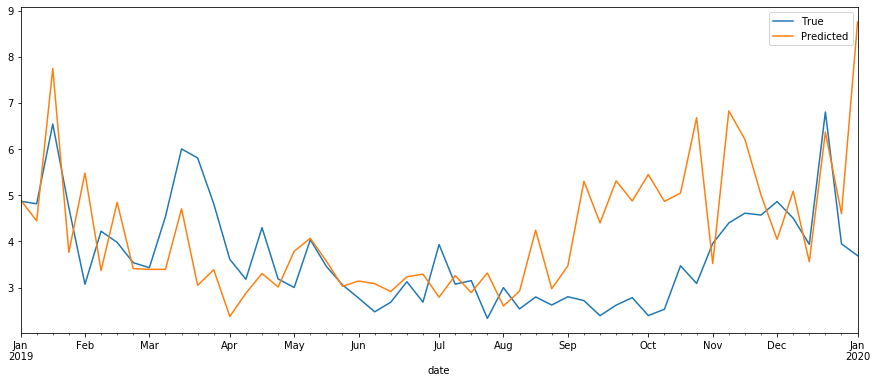

SAMPLED BY:  MS


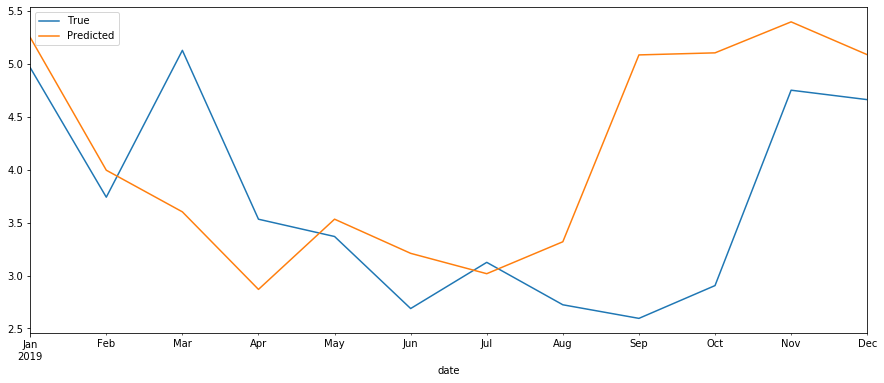

SAMPLED BY:  Q


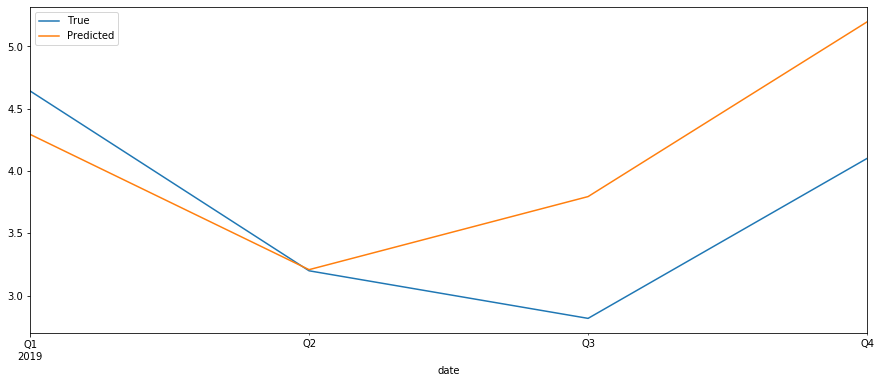

batch1-epochs30-neurons-4/results_lstm_u_model_RH_st0.txt (8760, 3)
shown RMSE: 16.527


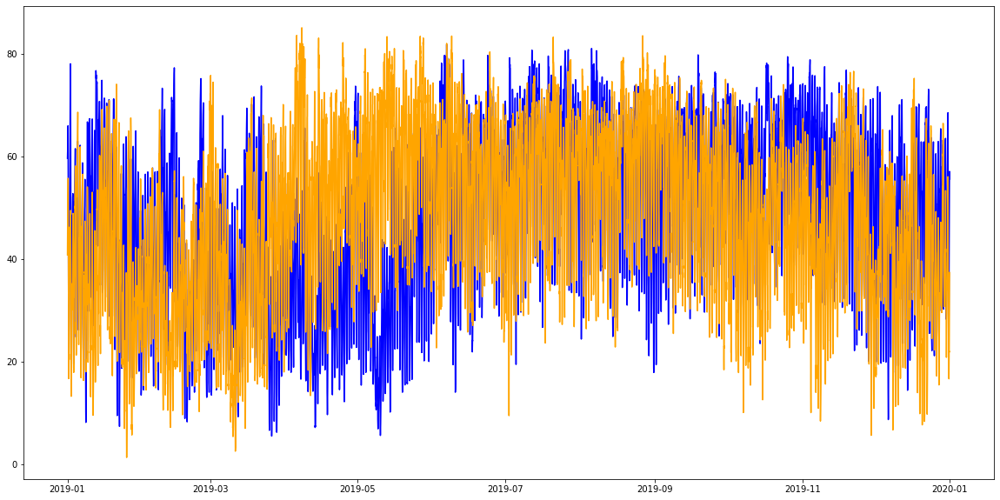

SAMPLED BY:  W


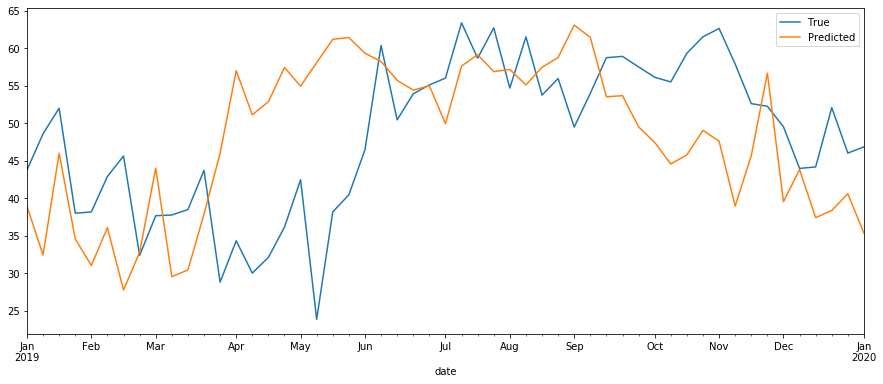

SAMPLED BY:  MS


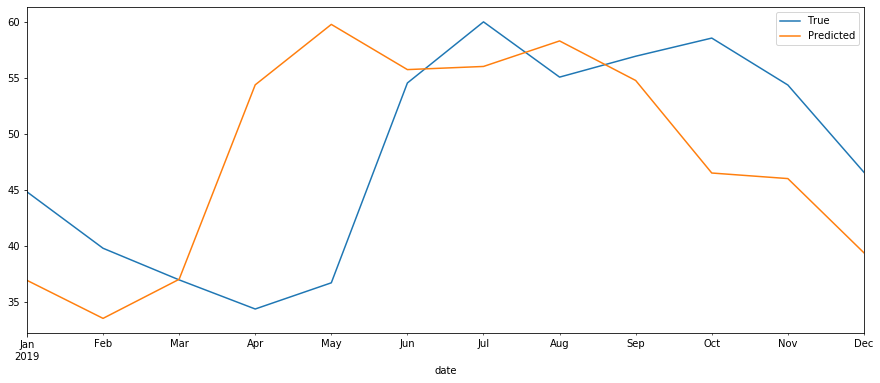

SAMPLED BY:  Q


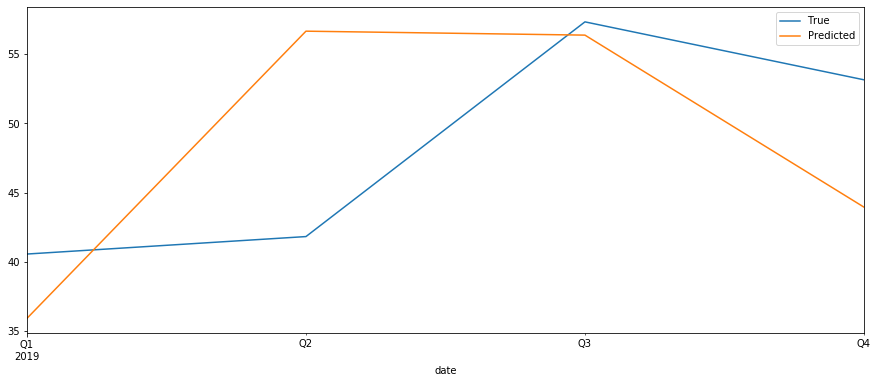

batch1-epochs30-neurons-4/results_lstm_u_model_TMP_st0.txt (8760, 3)
shown RMSE: 3.267


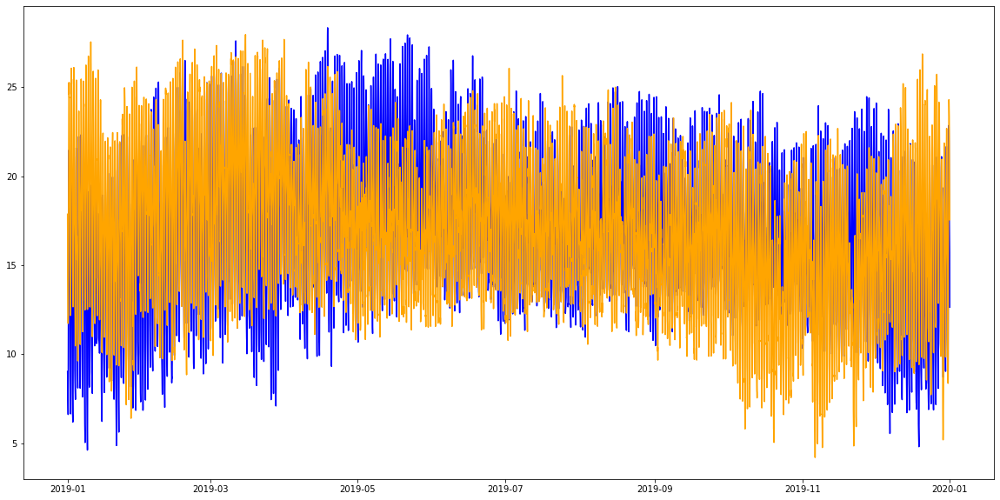

SAMPLED BY:  W


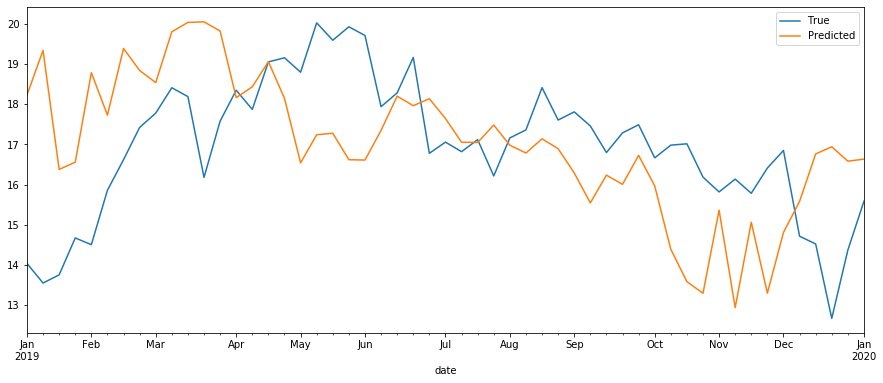

SAMPLED BY:  MS


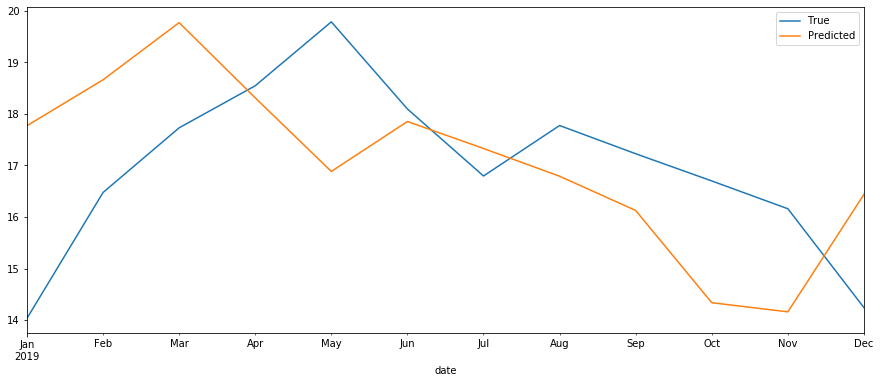

SAMPLED BY:  Q


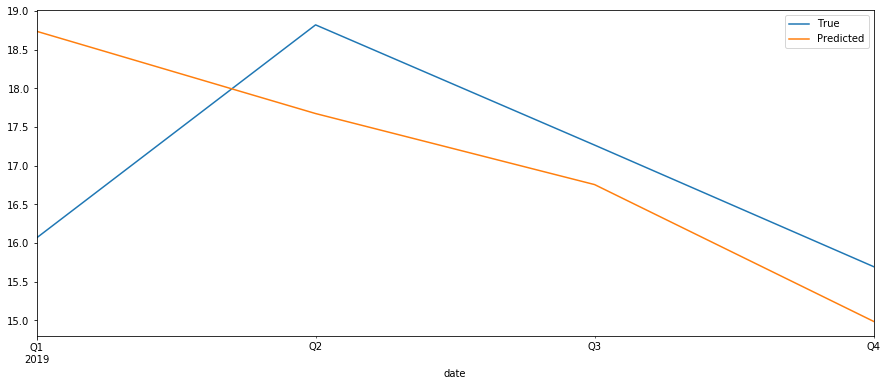

batch1-epochs30-neurons-4/results_lstm_u_model_WDR_st0.txt (8760, 3)
shown RMSE: 234.585


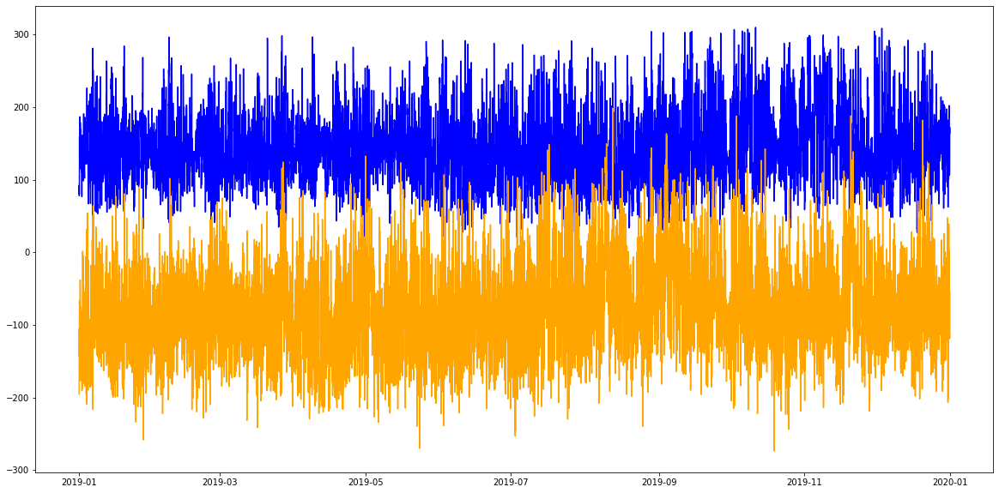

SAMPLED BY:  W


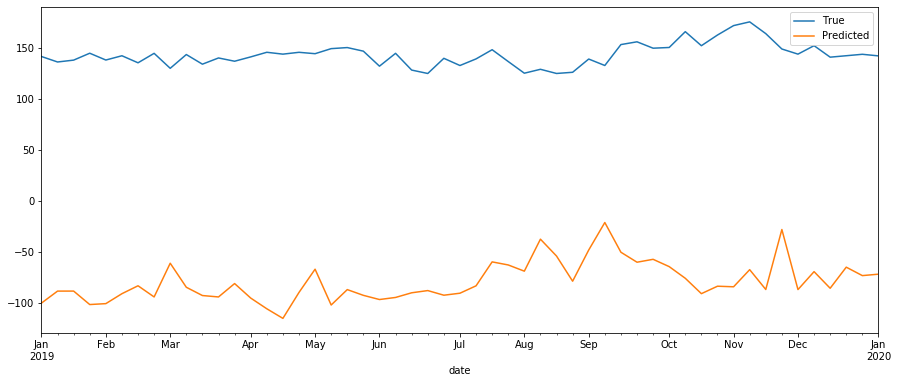

SAMPLED BY:  MS


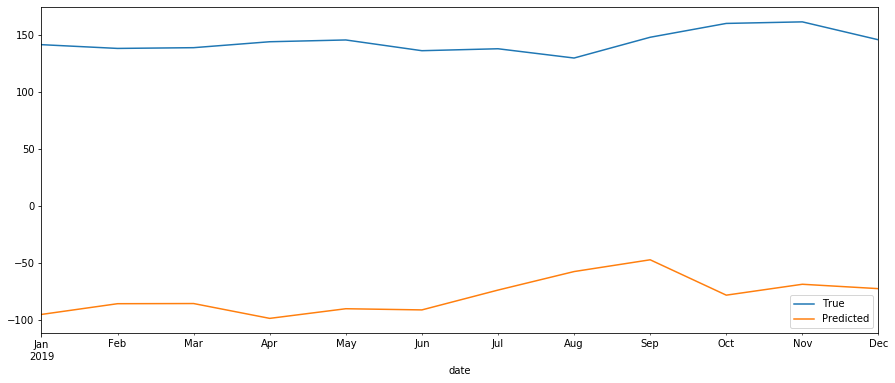

SAMPLED BY:  Q


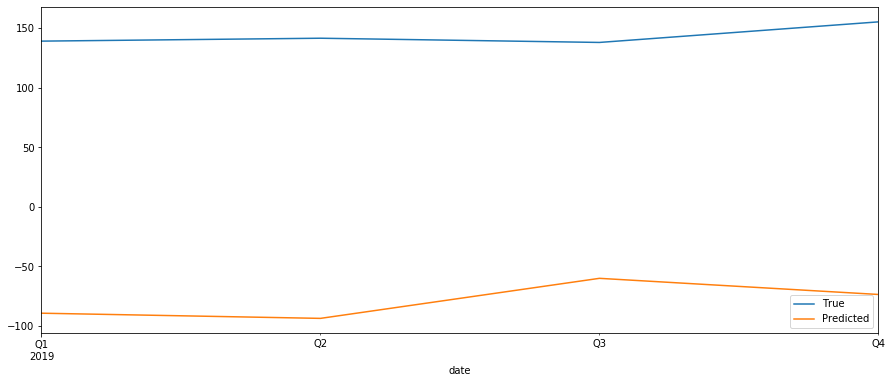

batch1-epochs30-neurons-4/results_lstm_u_model_WSP_st0.txt (8760, 3)
shown RMSE: 1.240


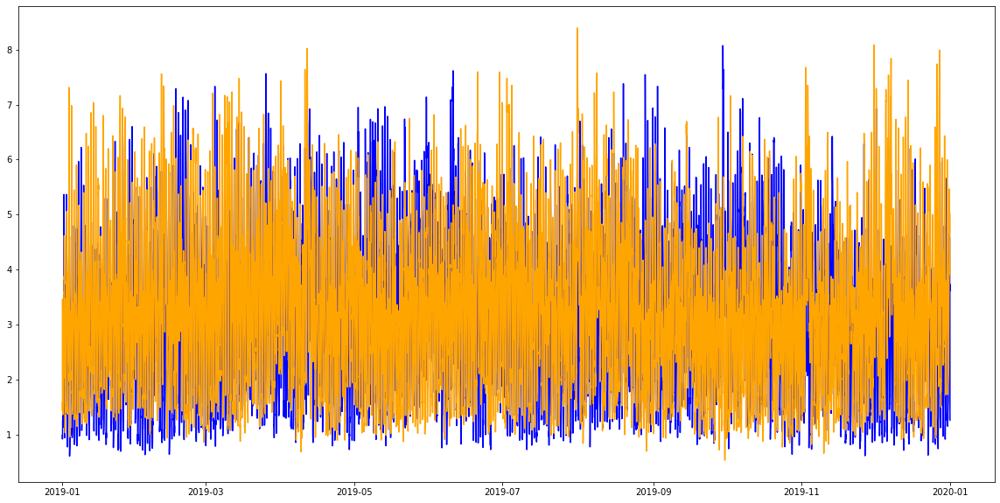

SAMPLED BY:  W


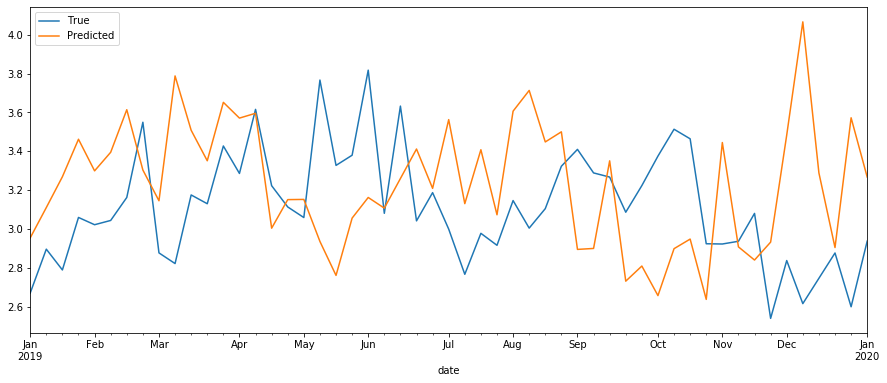

SAMPLED BY:  MS


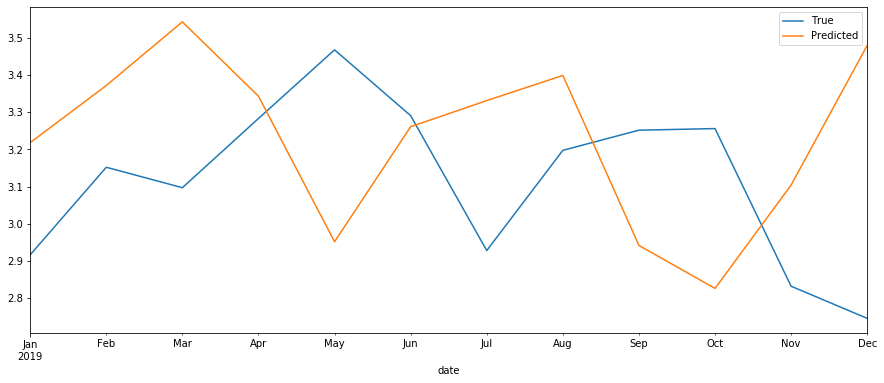

SAMPLED BY:  Q


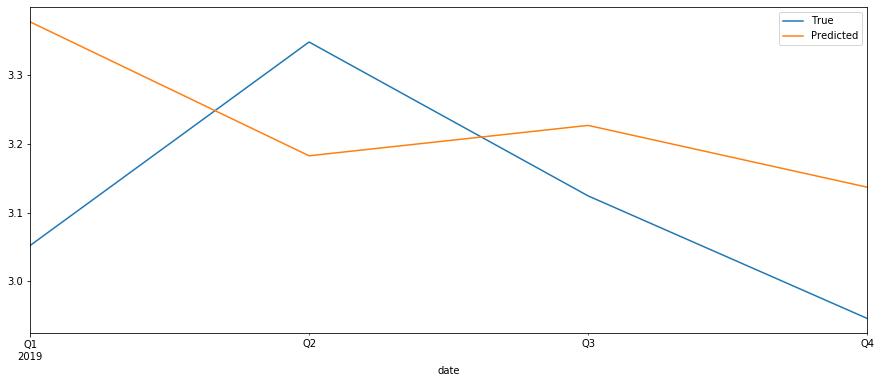

batch1-epochs30-neurons-4/results_lstm_u_model_PA_st.txt (8760, 3)
shown RMSE: 1.919


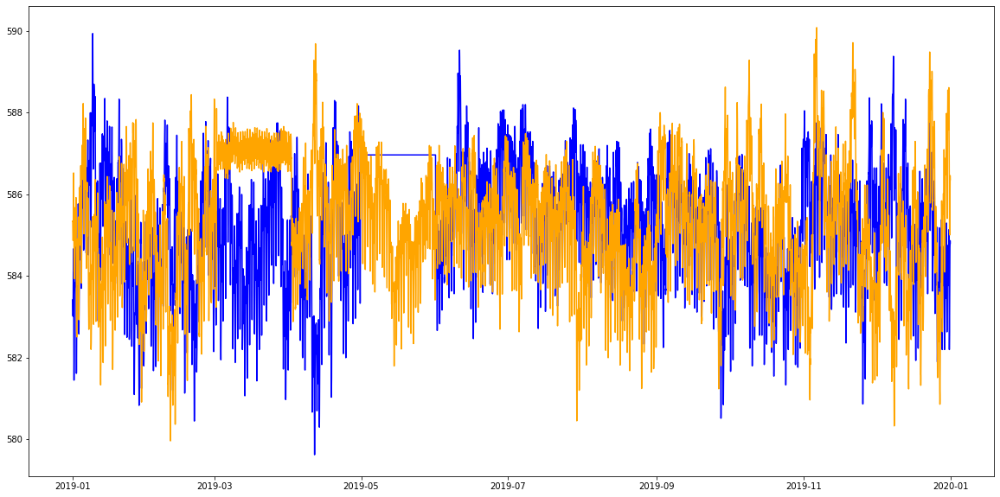

SAMPLED BY:  W


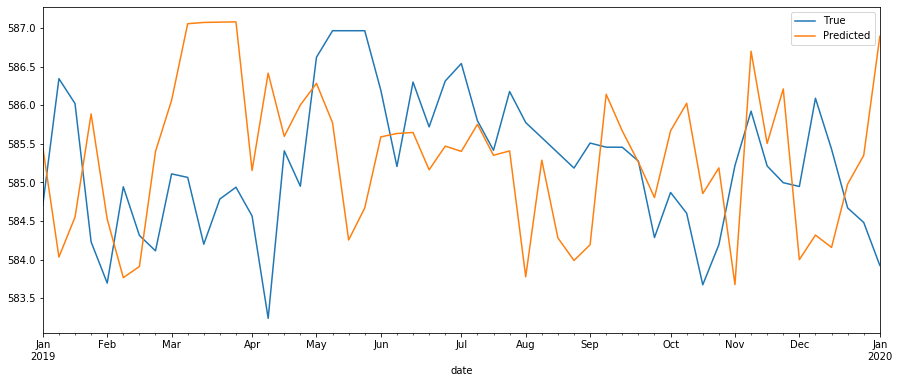

SAMPLED BY:  MS


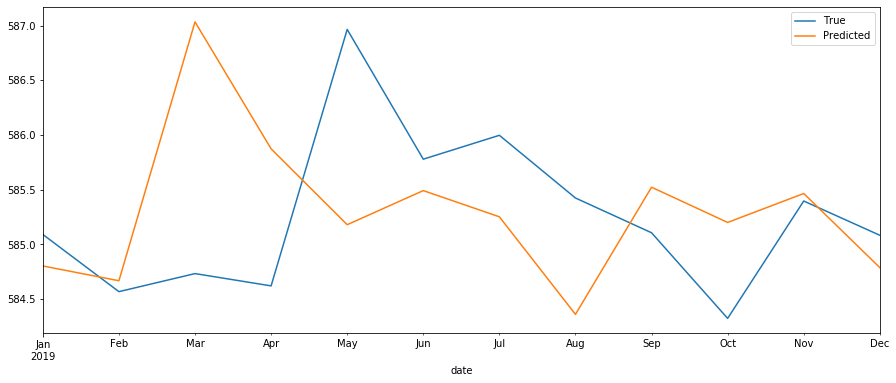

SAMPLED BY:  Q


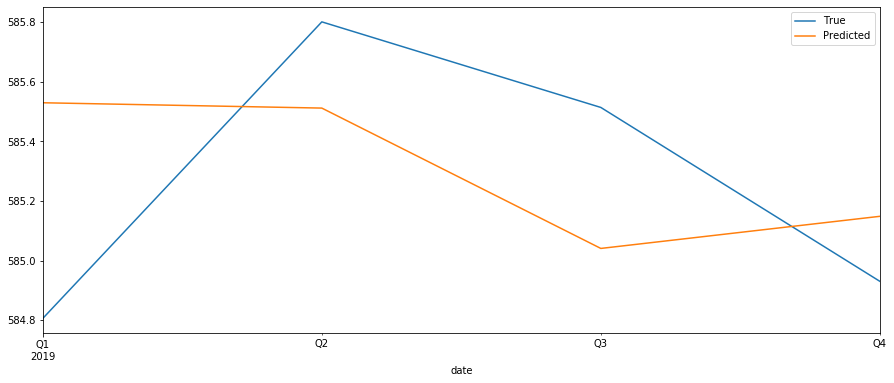

batch1-epochs30-neurons-4/results_lstm_u_model_UVA_st.txt (8760, 3)
shown RMSE: 1.010


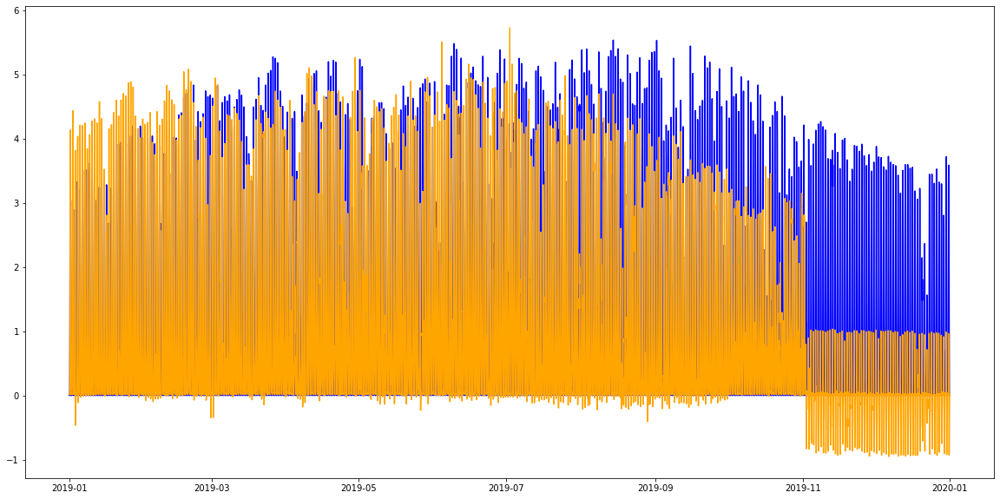

SAMPLED BY:  W


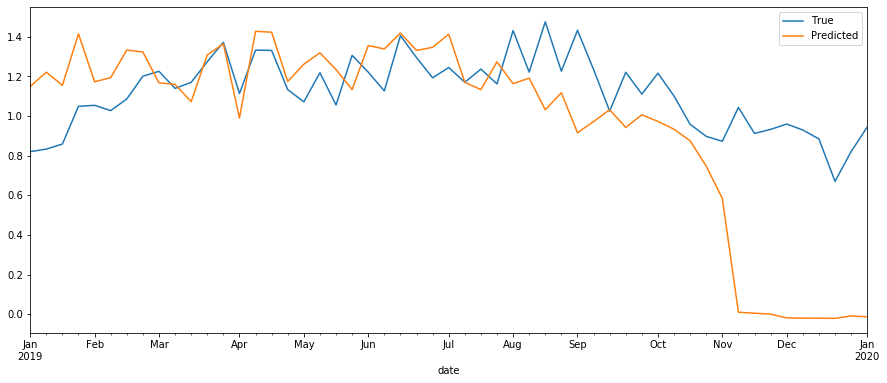

SAMPLED BY:  MS


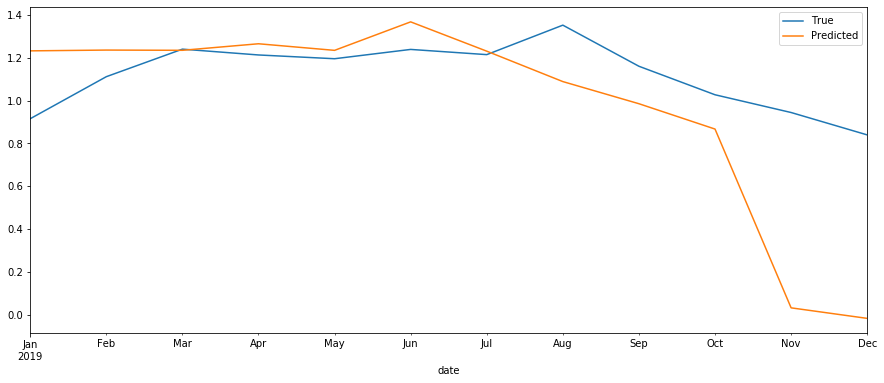

SAMPLED BY:  Q


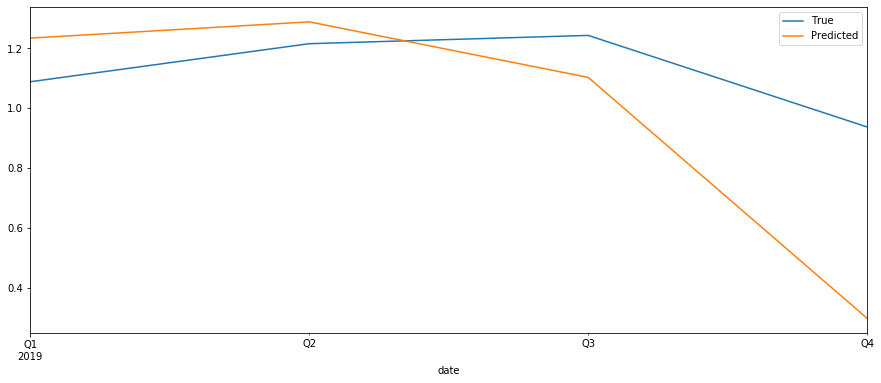

batch1-epochs30-neurons-4/results_lstm_u_model_UVB_st.txt (8760, 3)
shown RMSE: 0.933


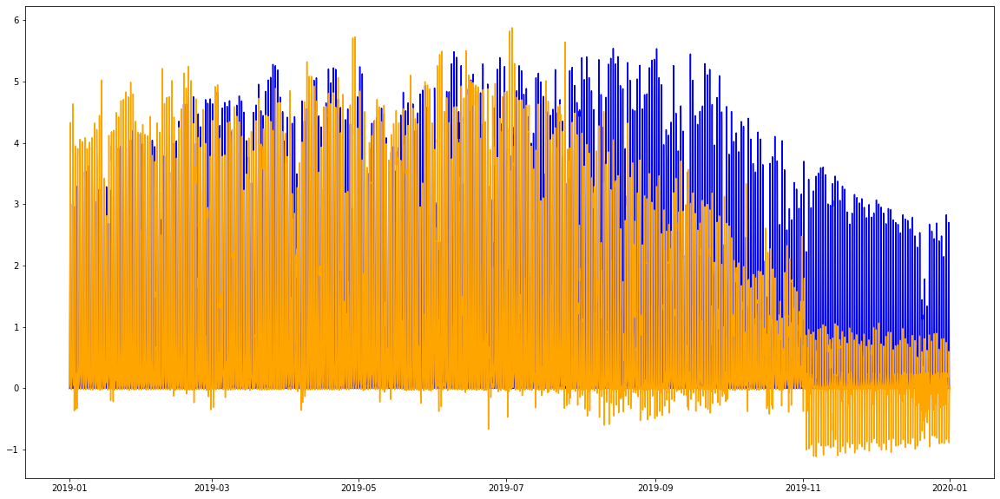

SAMPLED BY:  W


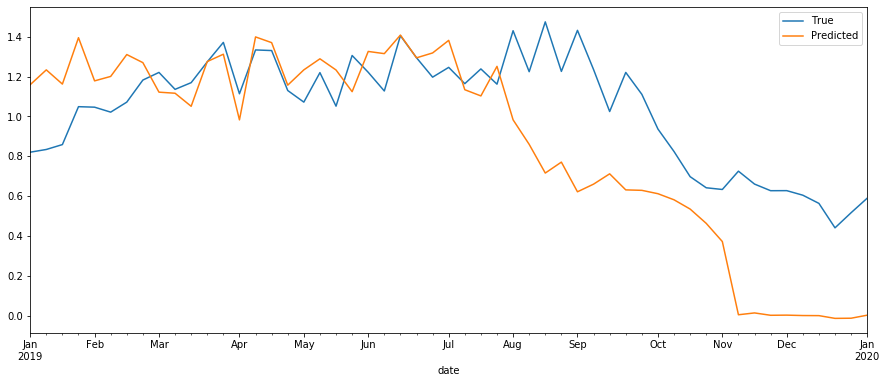

SAMPLED BY:  MS


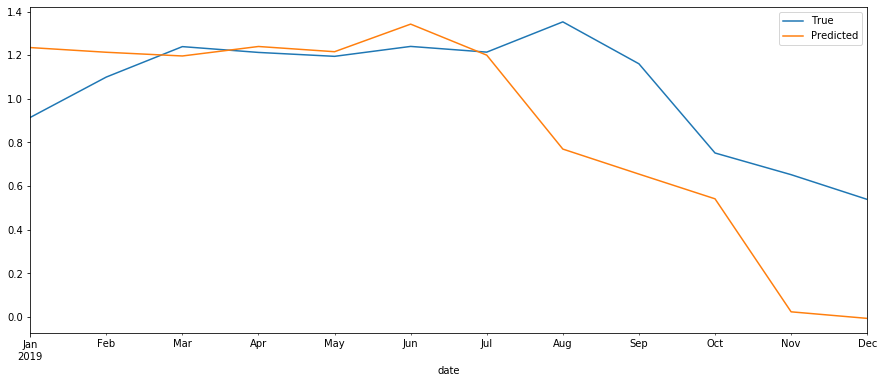

SAMPLED BY:  Q


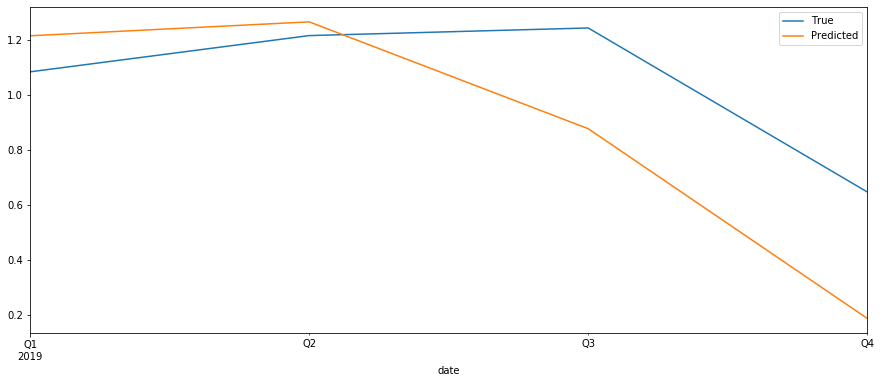

batch1-epochs30-neurons-4-resampledDay/results_lstm_u_model_CO_st0.txt (365, 3)
shown RMSE: 0.438


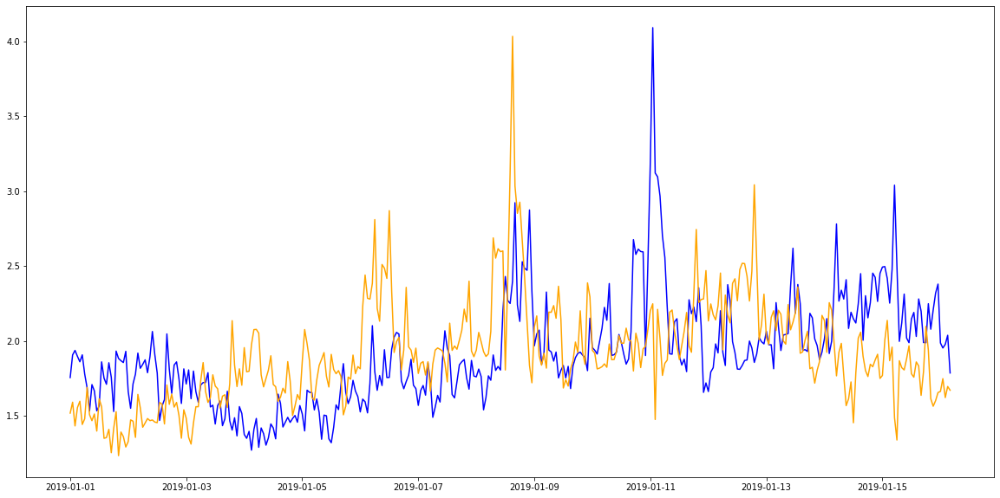

SAMPLED BY:  W


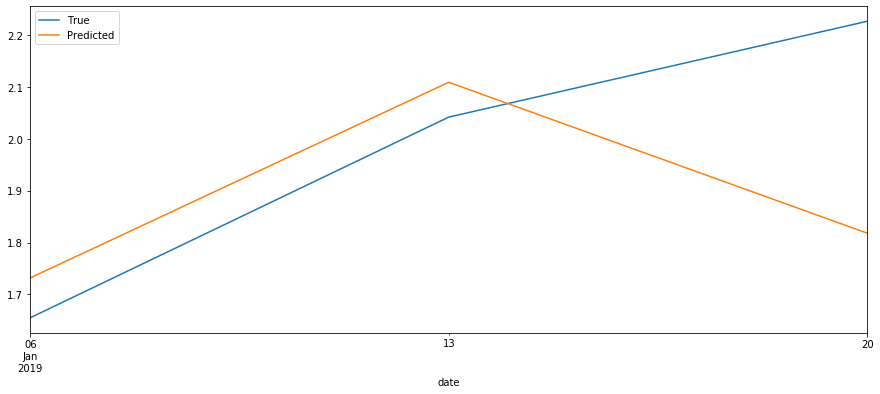

SAMPLED BY:  MS


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


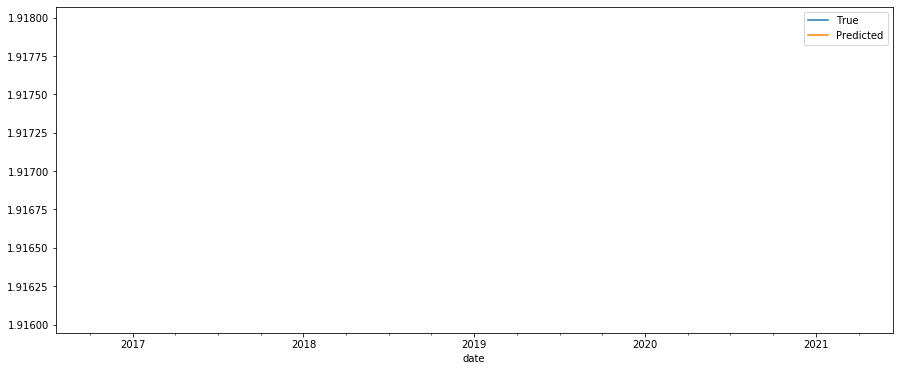

SAMPLED BY:  Q


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


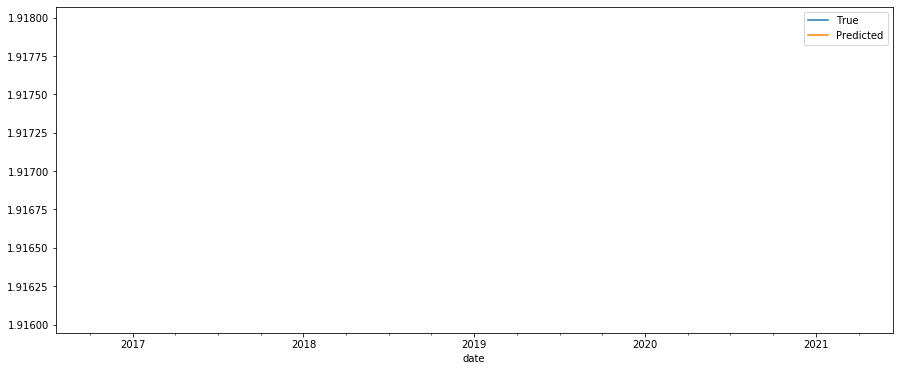

batch1-epochs30-neurons-4-resampledDay/results_lstm_u_model_NO_st0.txt (365, 3)
shown RMSE: 11.856


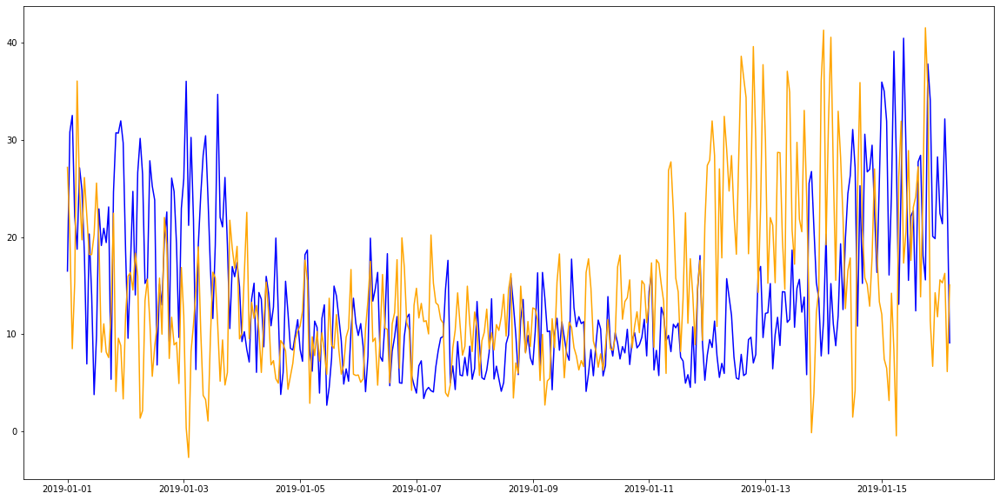

SAMPLED BY:  W


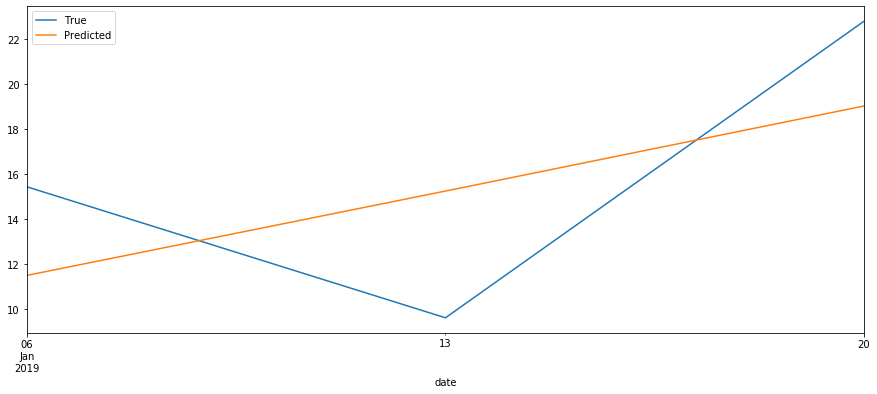

SAMPLED BY:  MS


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


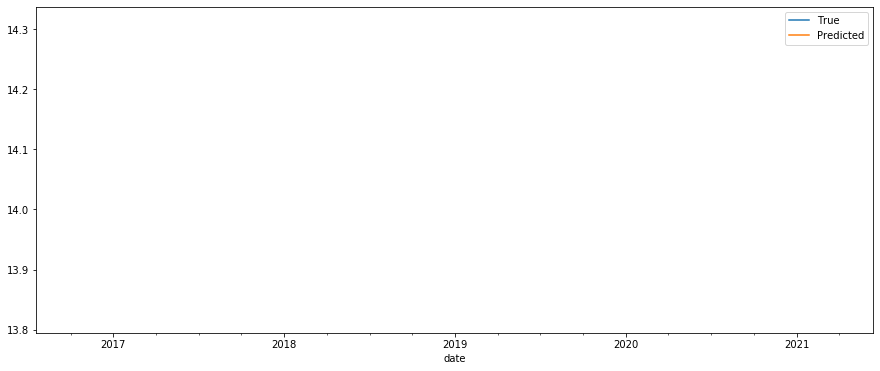

SAMPLED BY:  Q


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


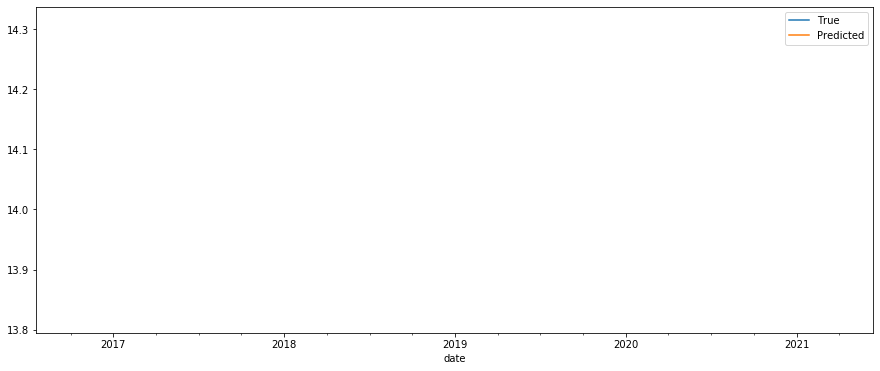

batch1-epochs30-neurons-4-resampledDay/results_lstm_u_model_NO2_st0.txt (365, 3)
shown RMSE: 7.444


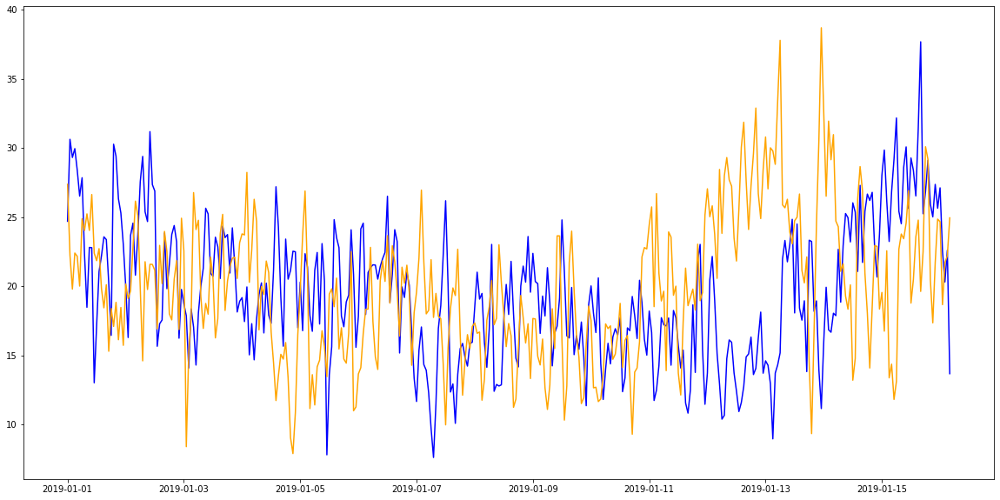

SAMPLED BY:  W


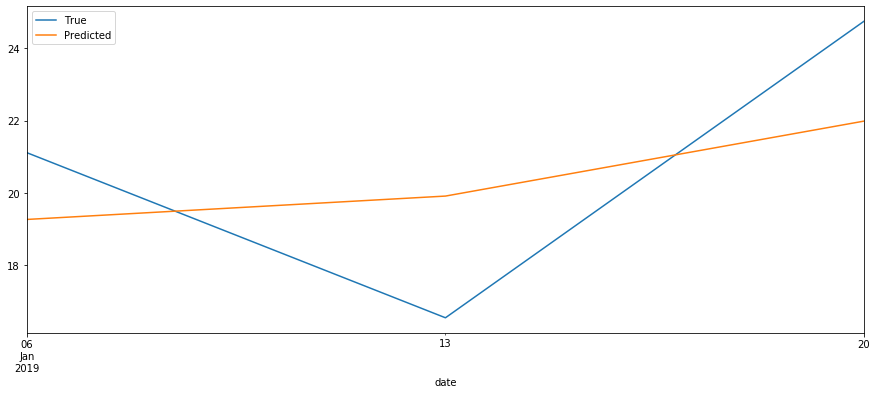

SAMPLED BY:  MS


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


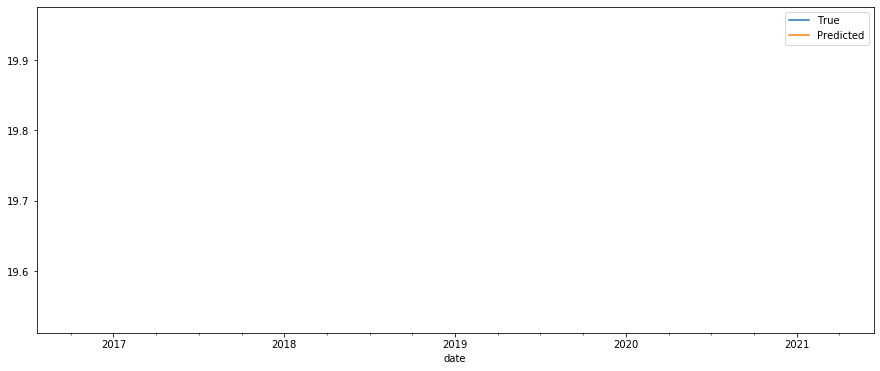

SAMPLED BY:  Q


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


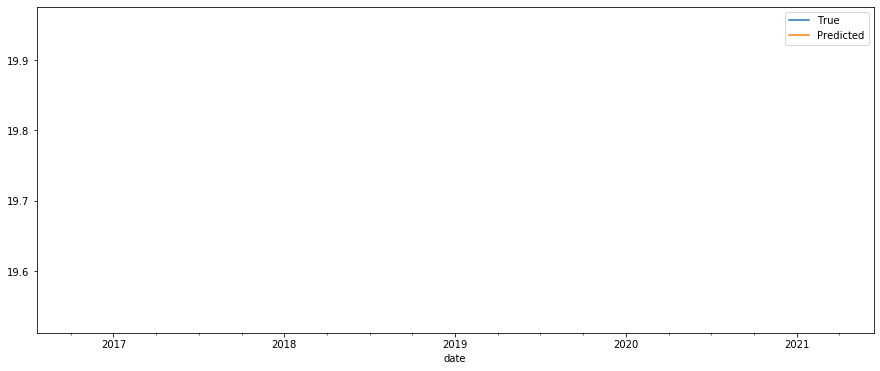

batch1-epochs30-neurons-4-resampledDay/results_lstm_u_model_NOX_st0.txt (365, 3)
shown RMSE: 17.362


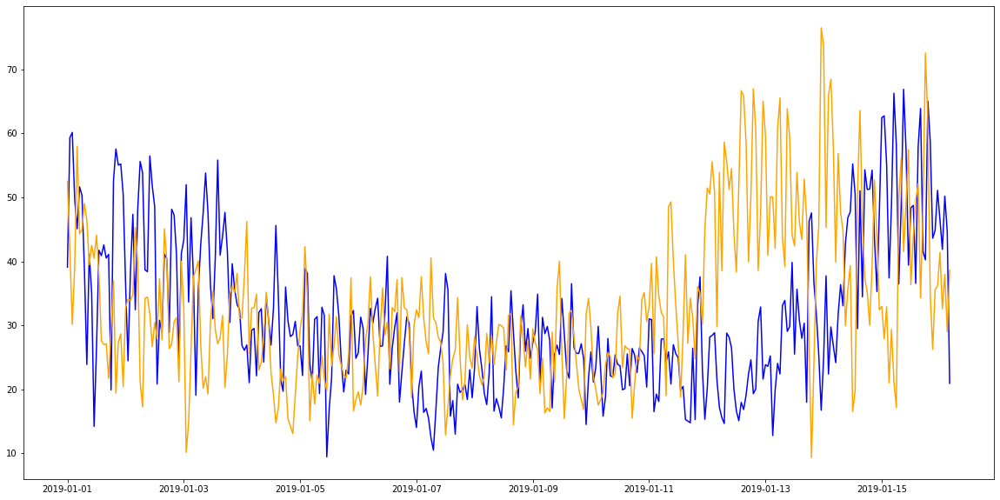

SAMPLED BY:  W


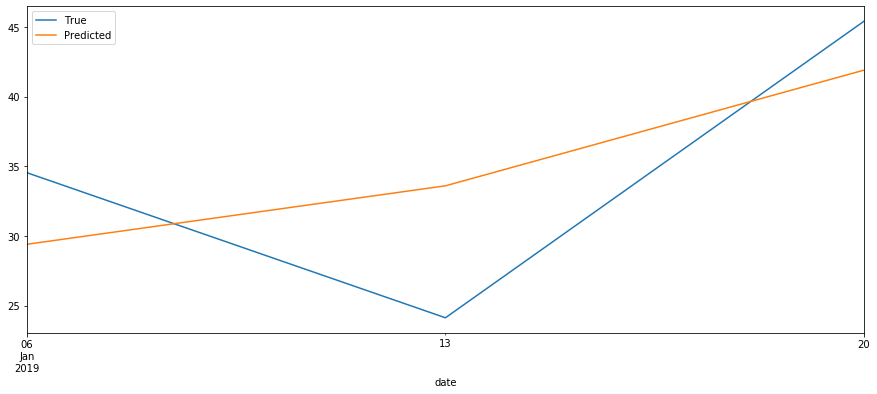

SAMPLED BY:  MS


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


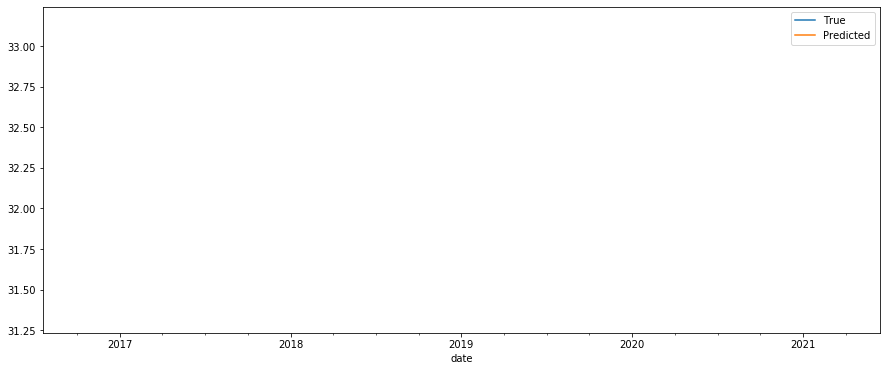

SAMPLED BY:  Q


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


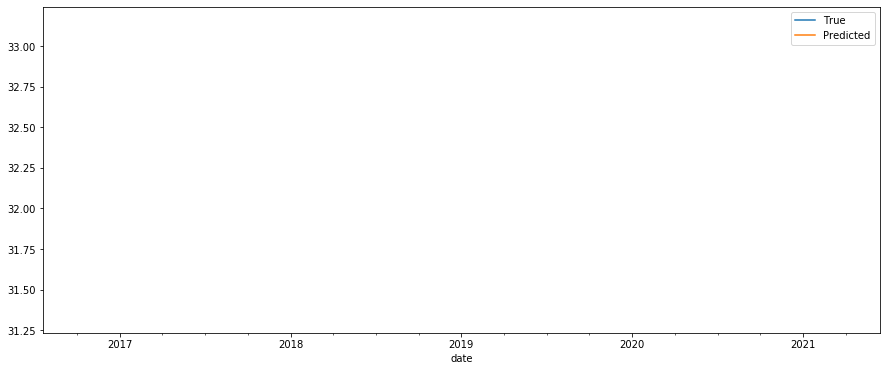

batch1-epochs30-neurons-4-resampledDay/results_lstm_u_model_O3_st0.txt (365, 3)
shown RMSE: 11.092


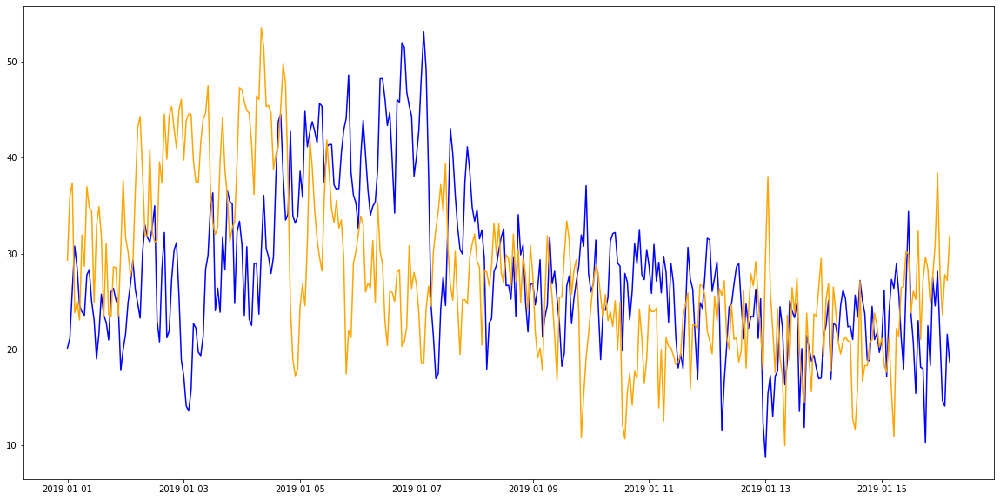

SAMPLED BY:  W


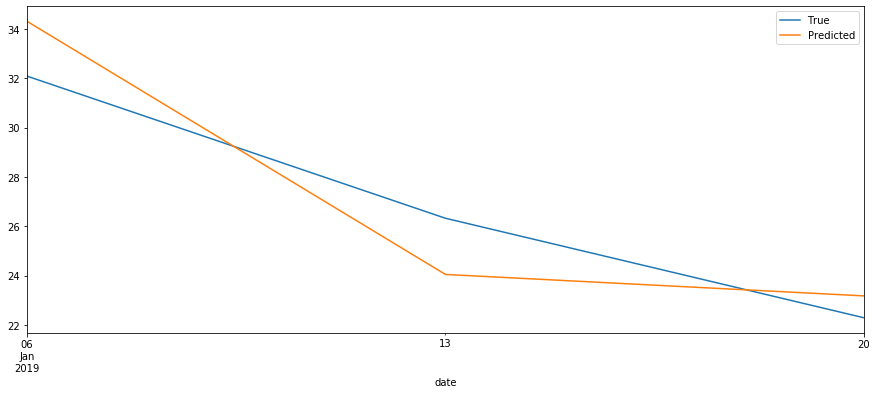

SAMPLED BY:  MS


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


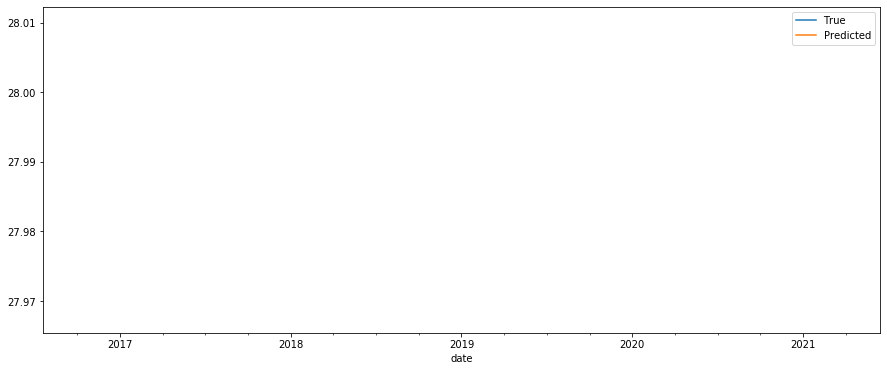

C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


SAMPLED BY:  Q


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


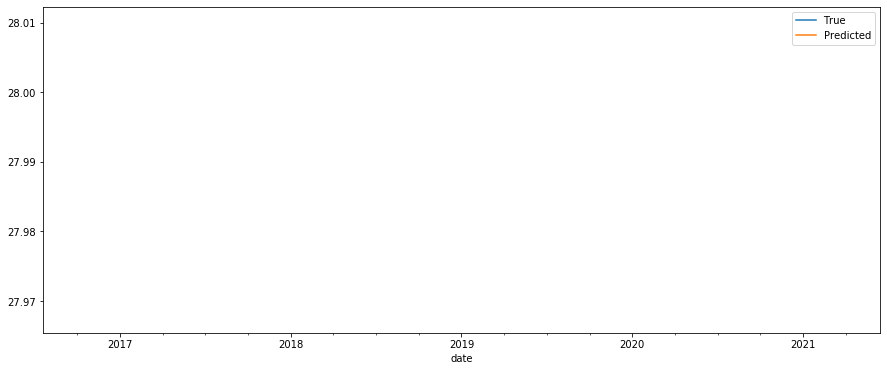

batch1-epochs30-neurons-4-resampledDay/results_lstm_u_model_PM10_st0.txt (365, 3)
shown RMSE: 21.959


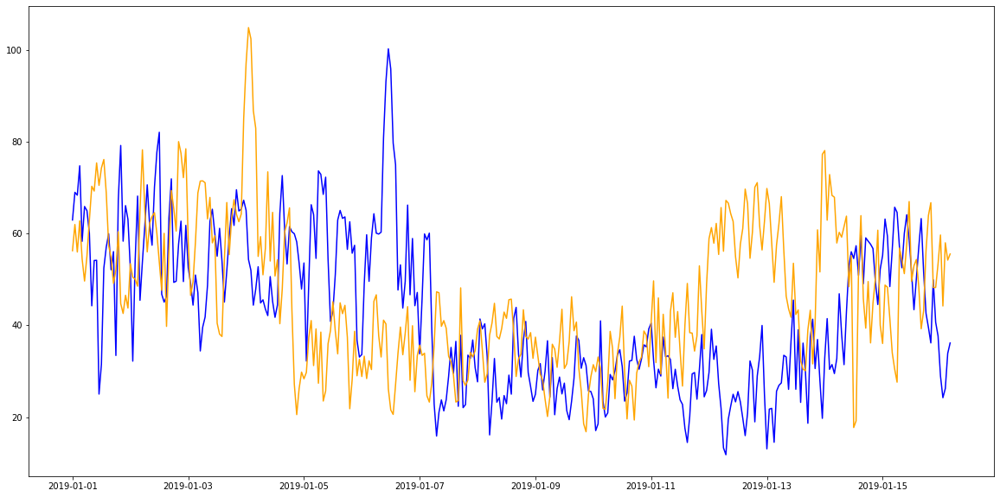

SAMPLED BY:  W


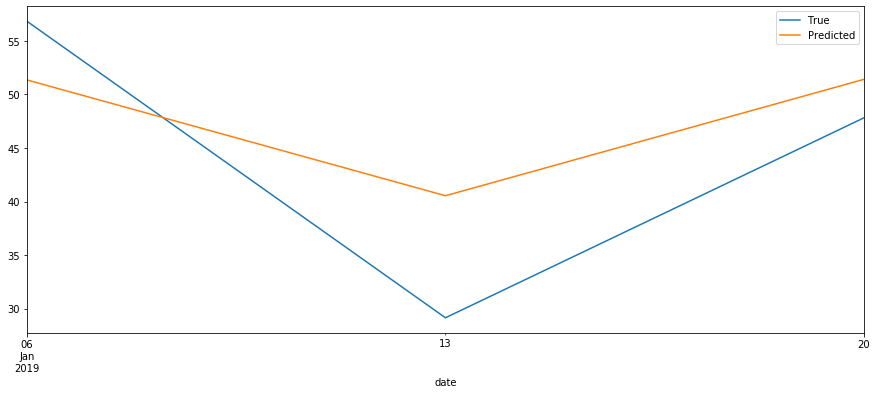

SAMPLED BY:  MS


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


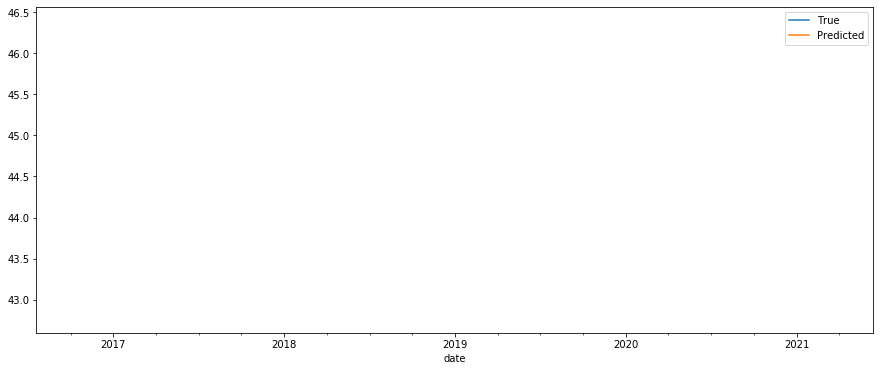

SAMPLED BY:  Q


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


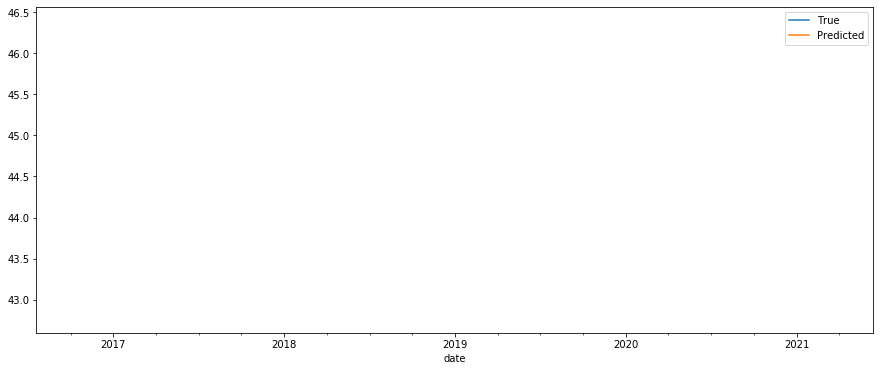

batch1-epochs30-neurons-4-resampledDay/results_lstm_u_model_PM25_st0.txt (365, 3)
shown RMSE: 15.238


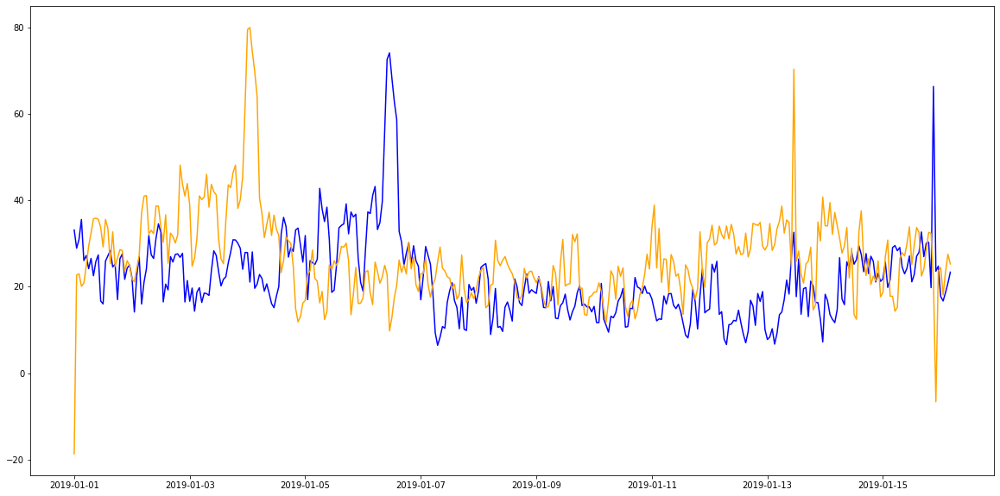

SAMPLED BY:  W


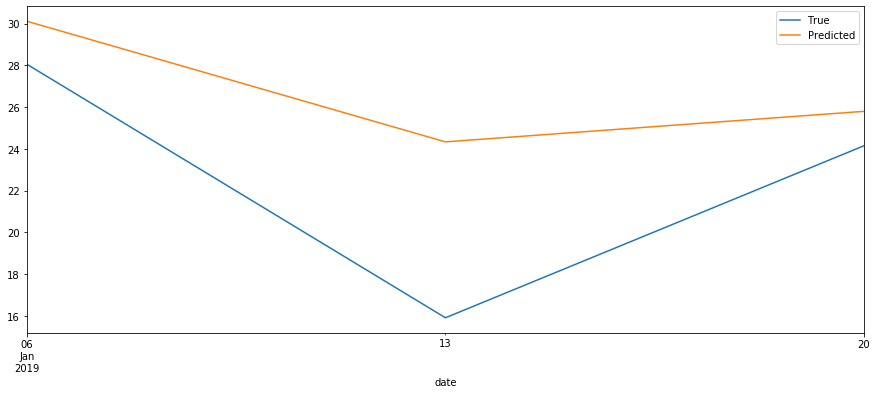

SAMPLED BY:  MS


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


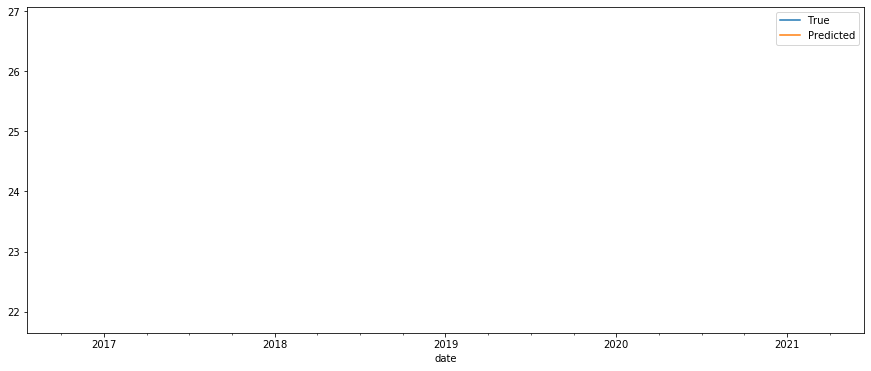

SAMPLED BY:  Q


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


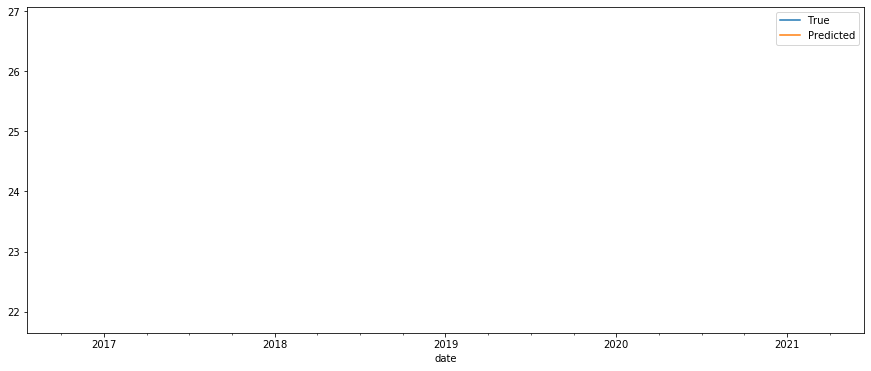

batch1-epochs30-neurons-4-resampledDay/results_lstm_u_model_PMCO_st0.txt (365, 3)
shown RMSE: 12.337


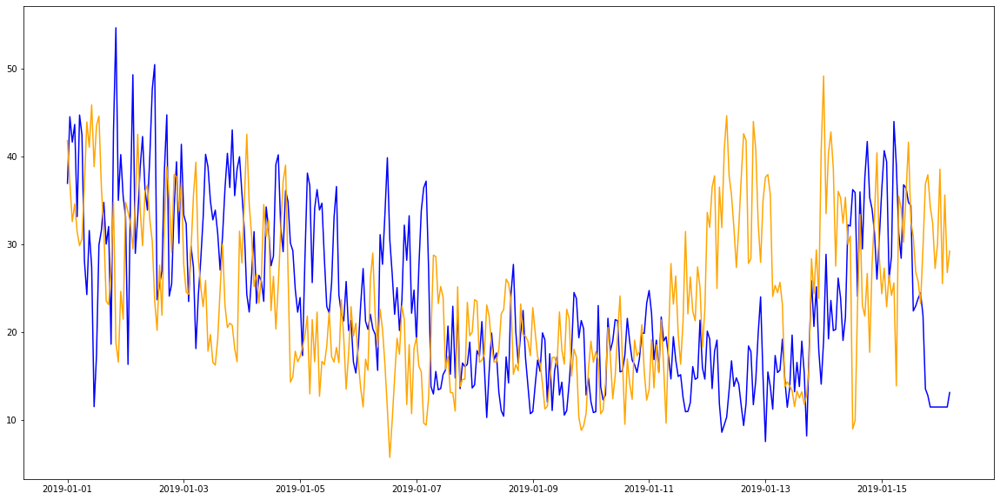

SAMPLED BY:  W


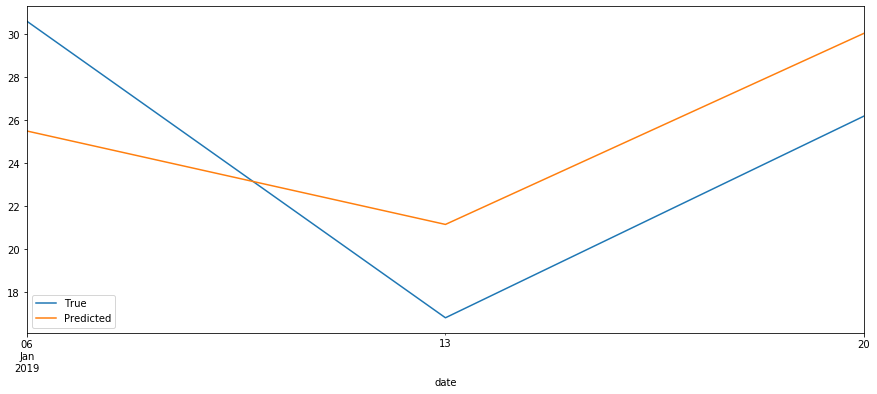

SAMPLED BY:  MS


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


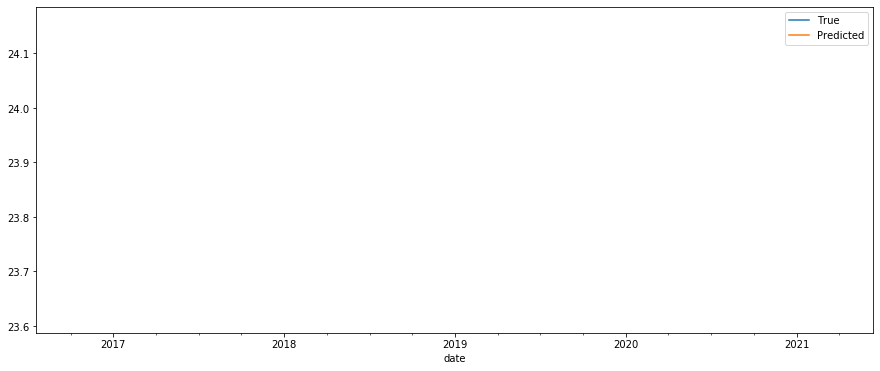

SAMPLED BY:  Q


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


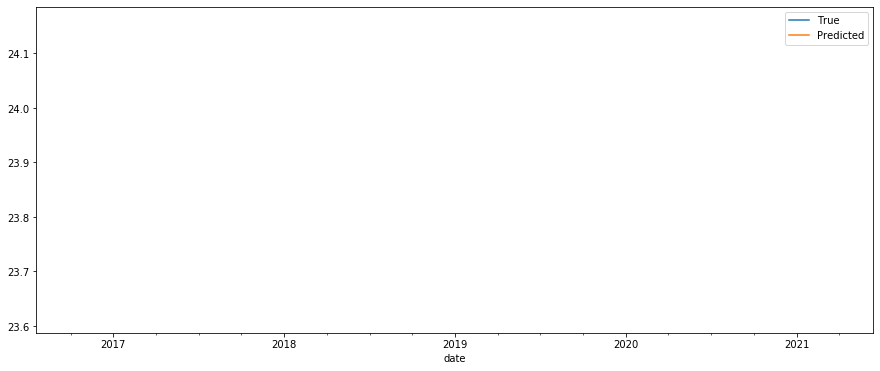

batch1-epochs30-neurons-4-resampledDay/results_lstm_u_model_SO2_st0.txt (365, 3)
shown RMSE: 3.246


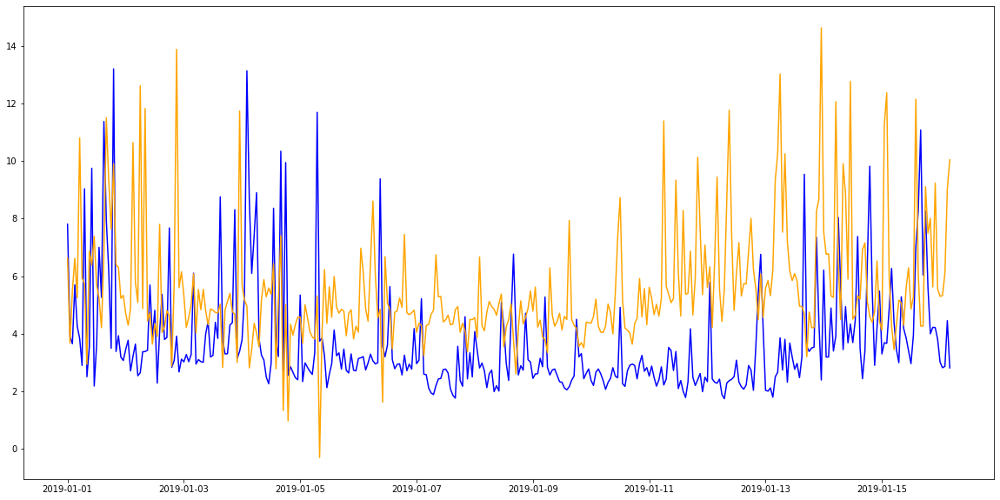

SAMPLED BY:  W


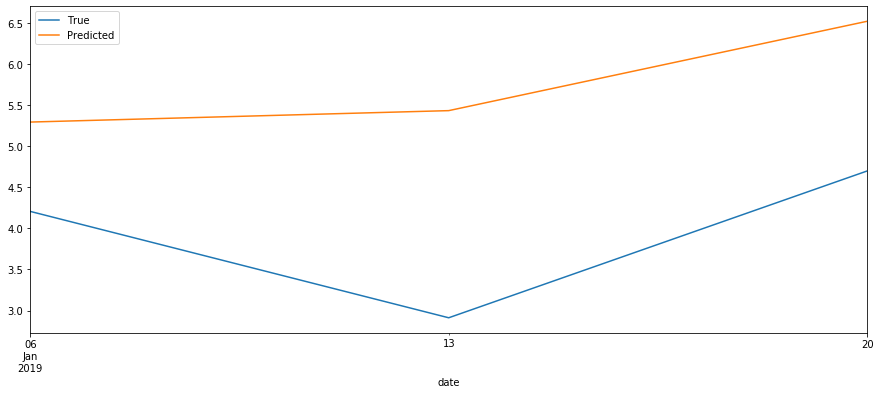

SAMPLED BY:  MS


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


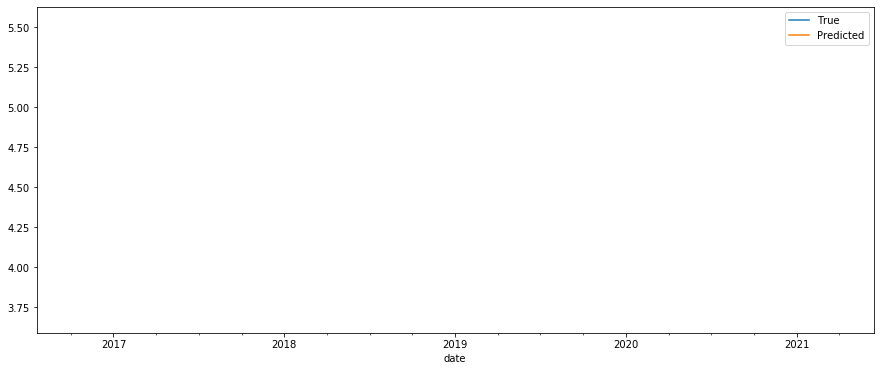

C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


SAMPLED BY:  Q


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


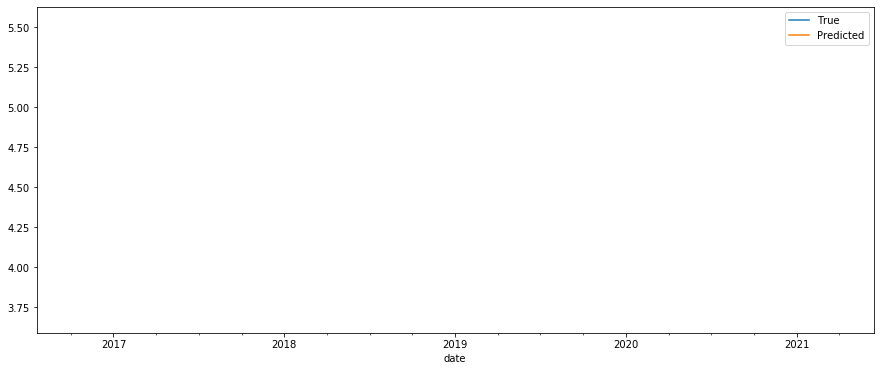

batch1-epochs30-neurons-4-resampledDay/results_lstm_u_model_RH_st0.txt (365, 3)
shown RMSE: 14.918


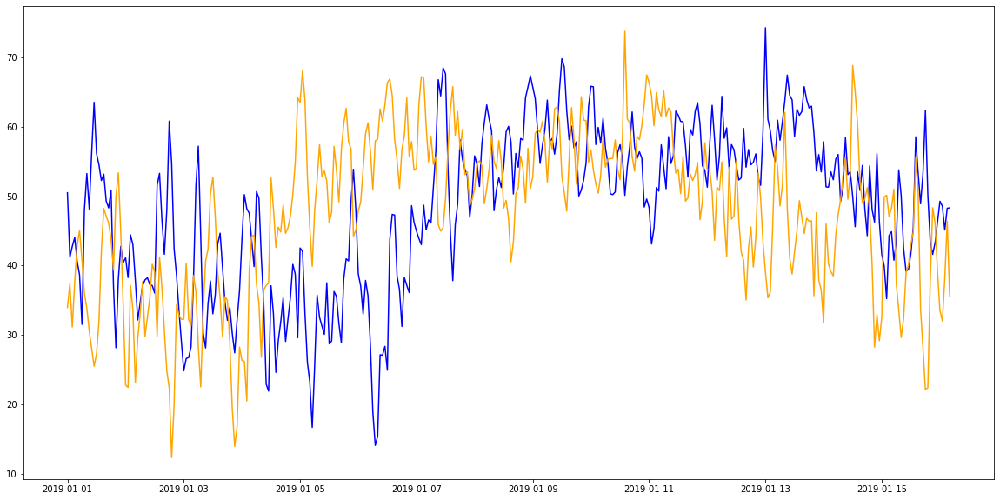

SAMPLED BY:  W


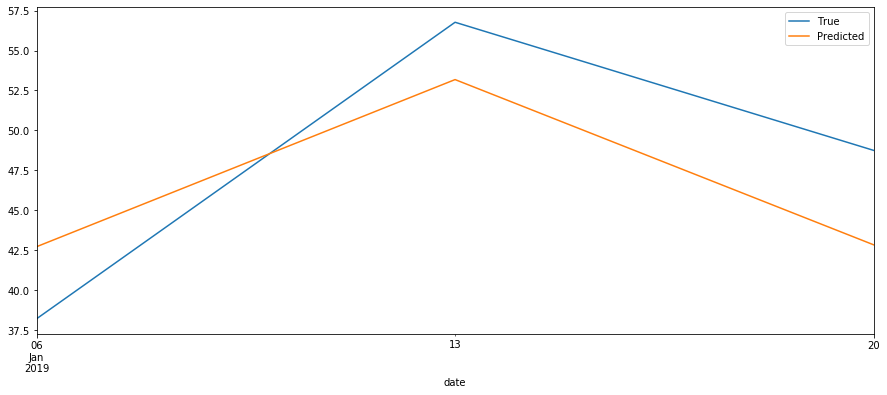

SAMPLED BY:  MS


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


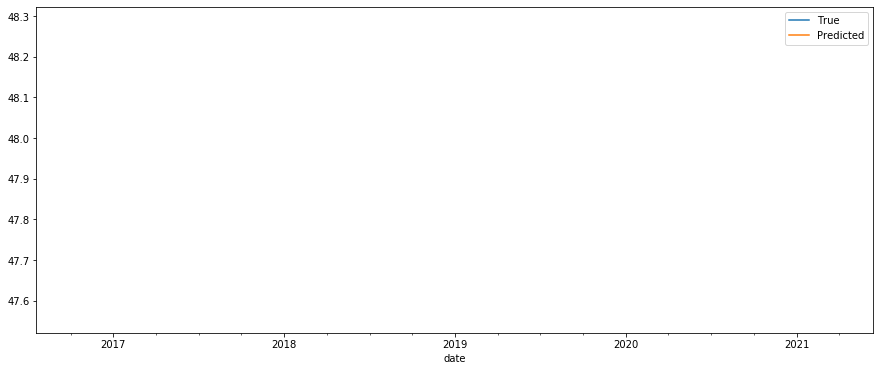

SAMPLED BY:  Q


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


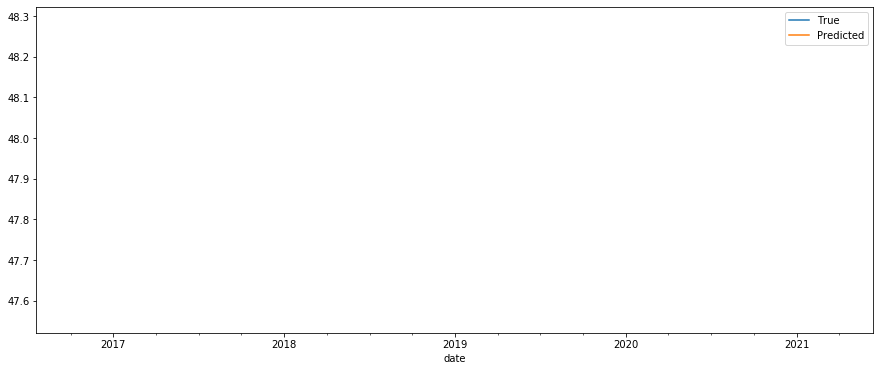

batch1-epochs30-neurons-4-resampledDay/results_lstm_u_model_TMP_st0.txt (365, 3)
shown RMSE: 2.553


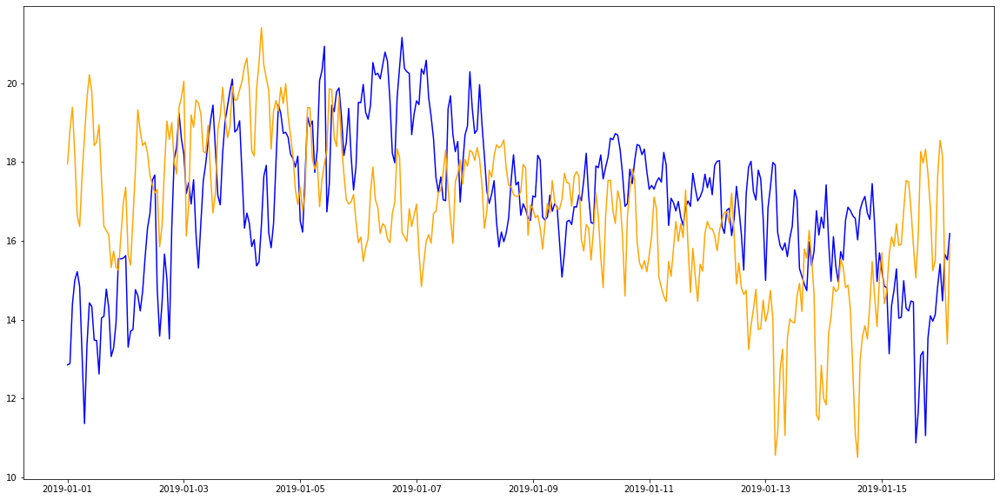

SAMPLED BY:  W


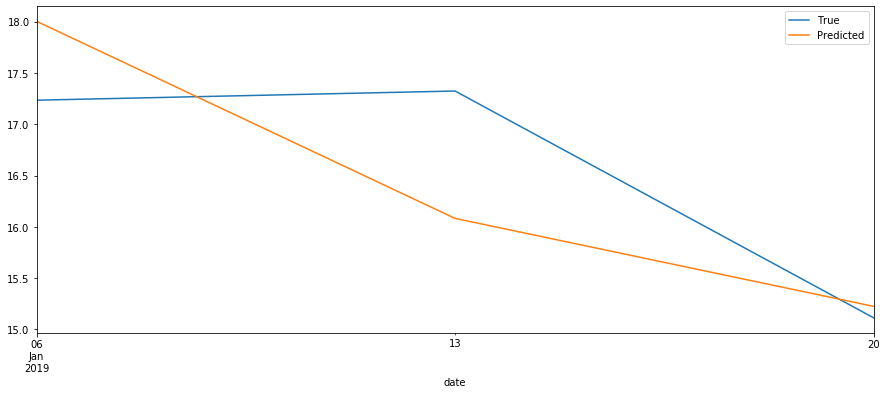

SAMPLED BY:  MS


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


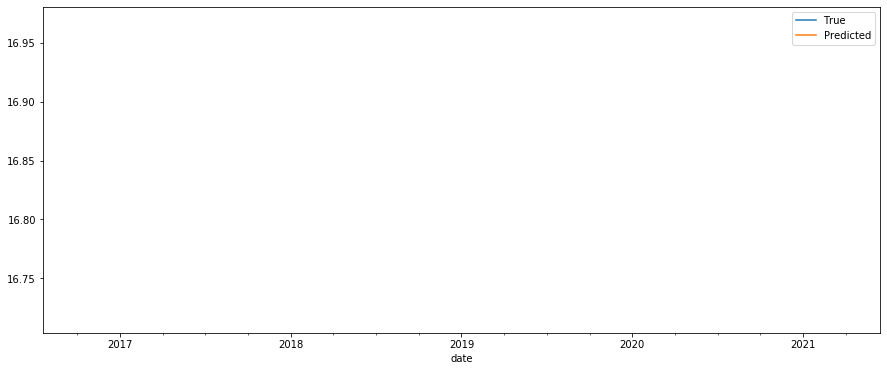

SAMPLED BY:  Q


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


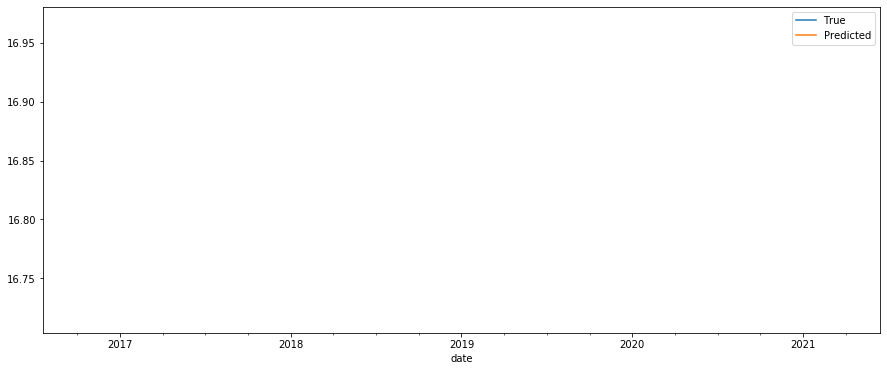

batch1-epochs30-neurons-4-resampledDay/results_lstm_u_model_WDR_st0.txt (365, 3)
shown RMSE: 31.189


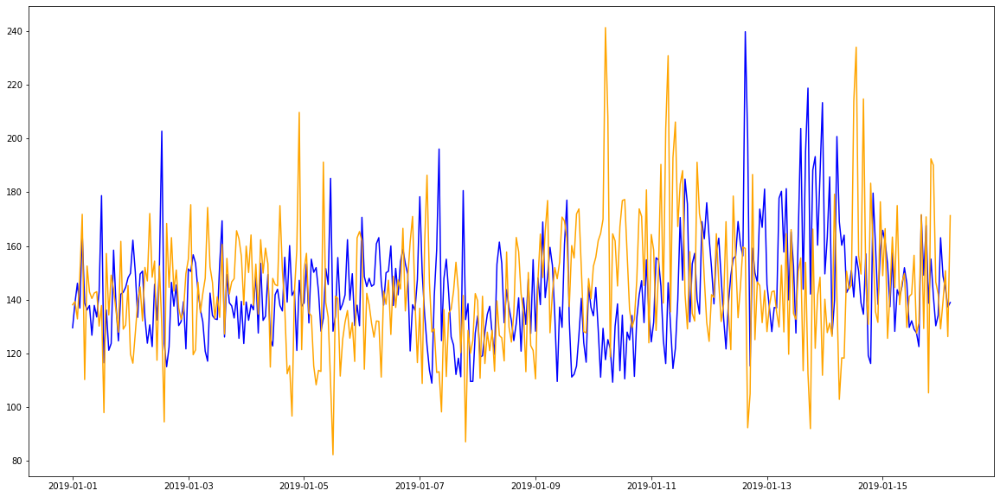

SAMPLED BY:  W


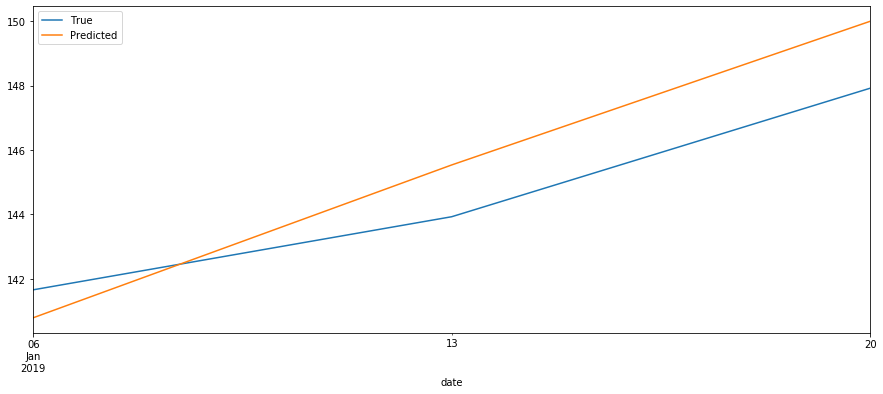

SAMPLED BY:  MS


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


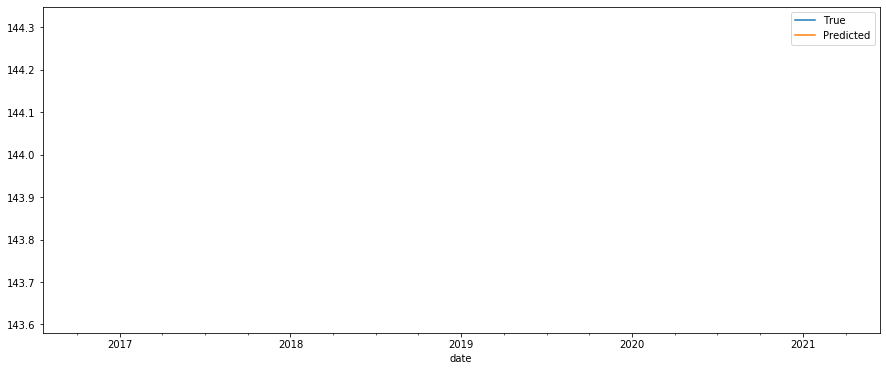

SAMPLED BY:  Q


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


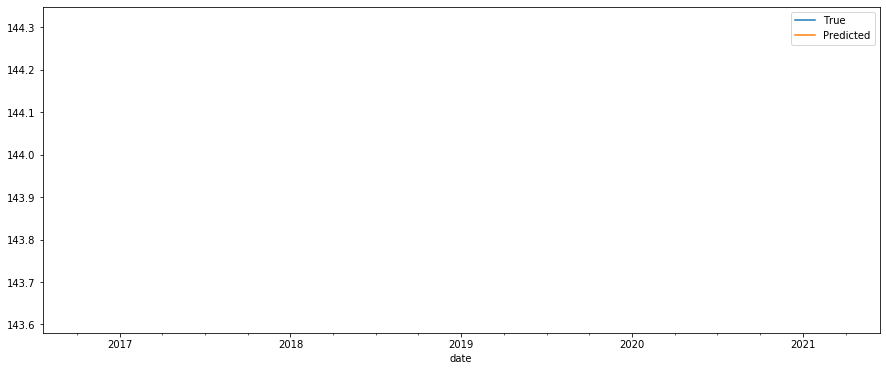

batch1-epochs30-neurons-4-resampledDay/results_lstm_u_model_WSP_st0.txt (365, 3)
shown RMSE: 0.729


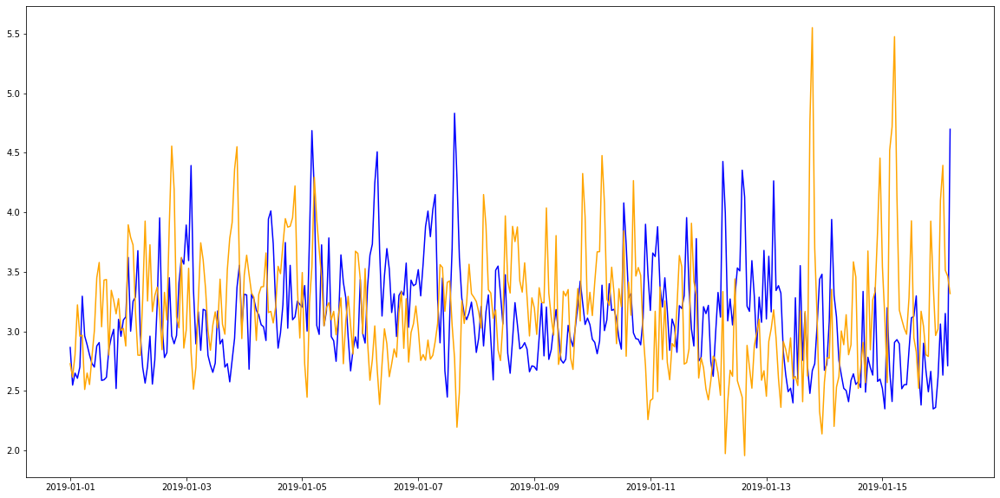

SAMPLED BY:  W


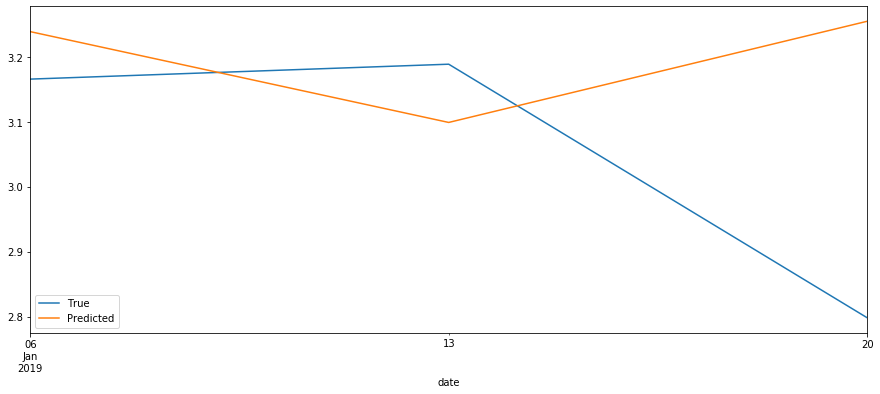

SAMPLED BY:  MS


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


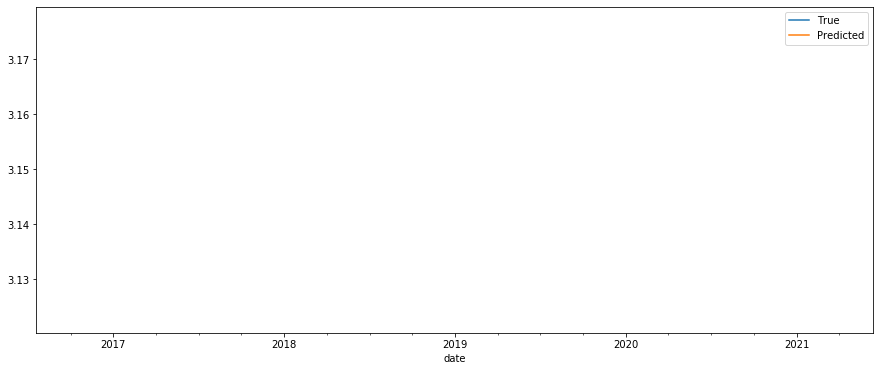

SAMPLED BY:  Q


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


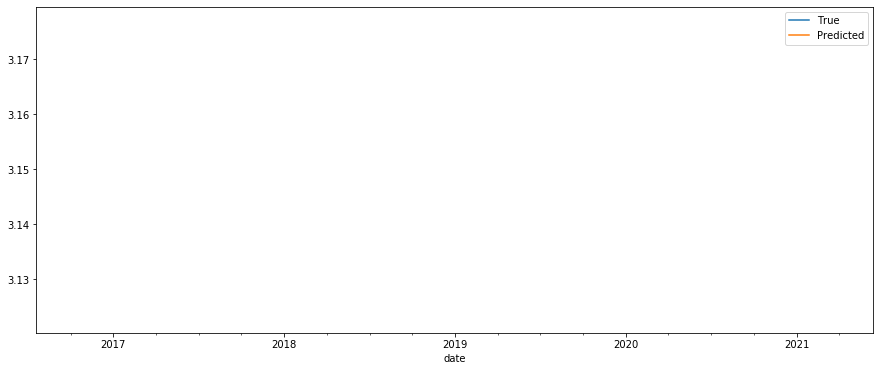

batch1-epochs30-neurons-4-resampledDay/results_lstm_u_model_PA_st.txt (365, 3)
shown RMSE: 1.776


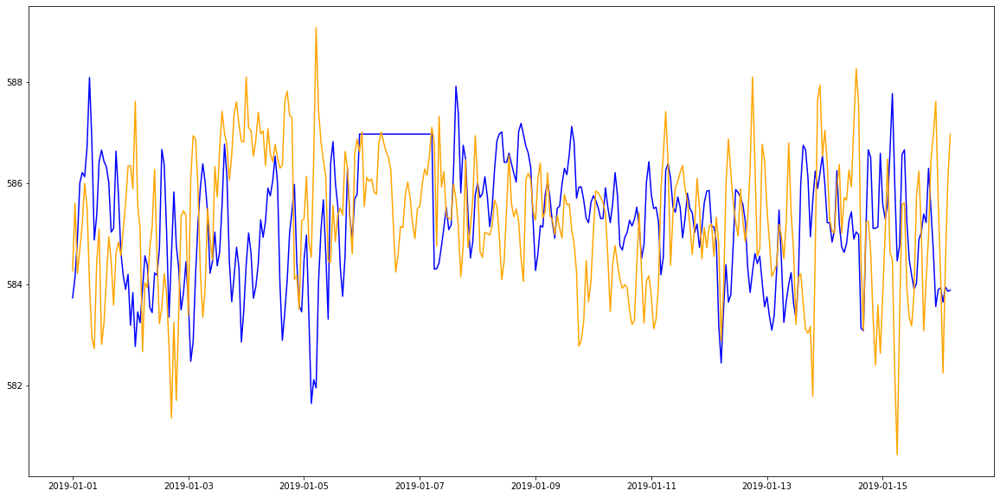

SAMPLED BY:  W


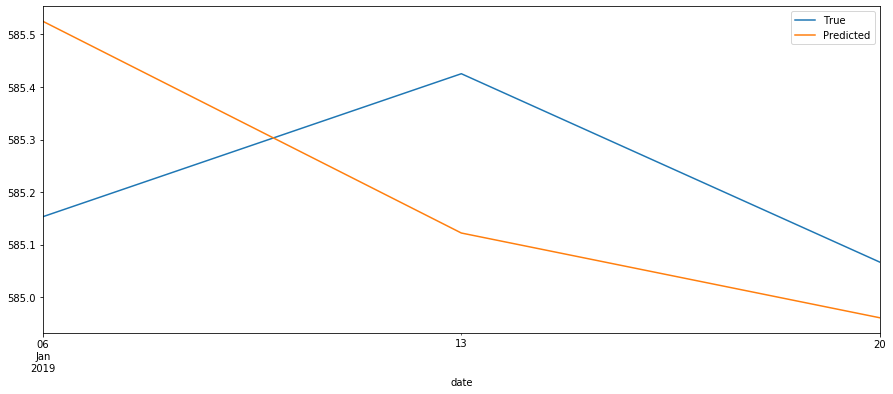

SAMPLED BY:  MS


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


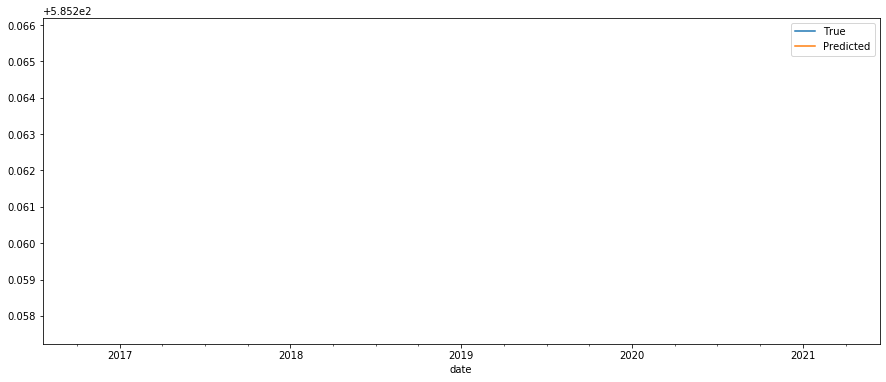

SAMPLED BY:  Q


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


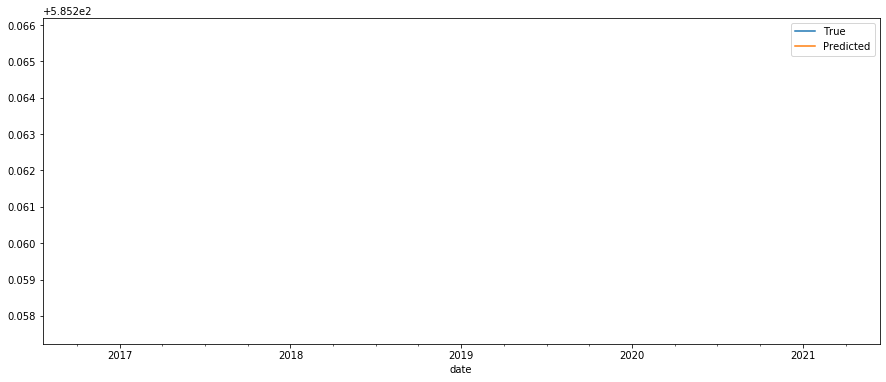

batch1-epochs30-neurons-4-resampledDay/results_lstm_u_model_UVA_st.txt (365, 3)
shown RMSE: 0.480


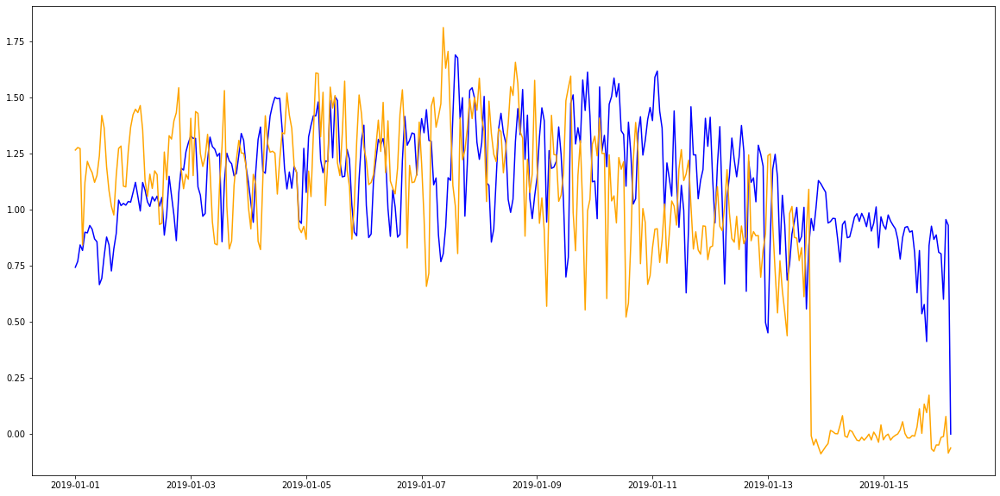

SAMPLED BY:  W


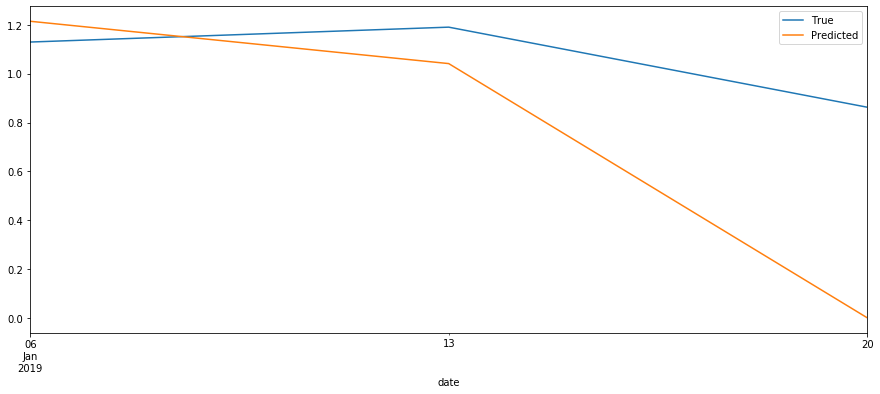

SAMPLED BY:  MS


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


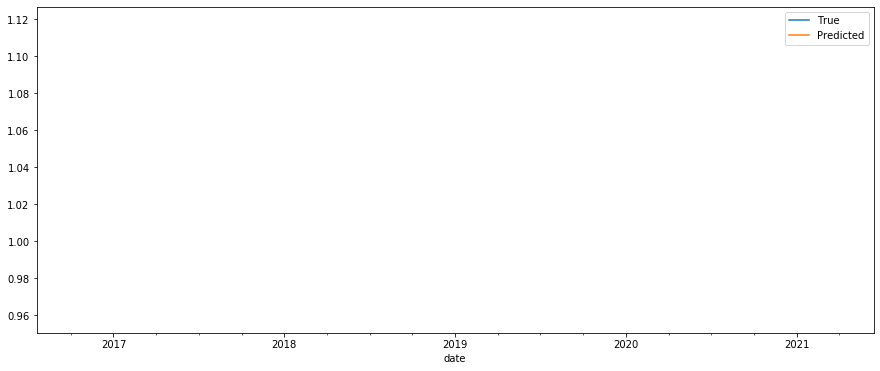

C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


SAMPLED BY:  Q


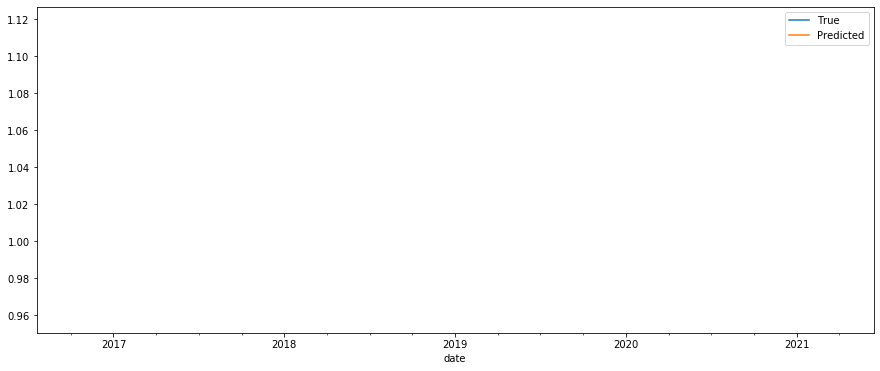

batch1-epochs30-neurons-4-resampledDay/results_lstm_u_model_UVB_st.txt (365, 3)
shown RMSE: 0.420


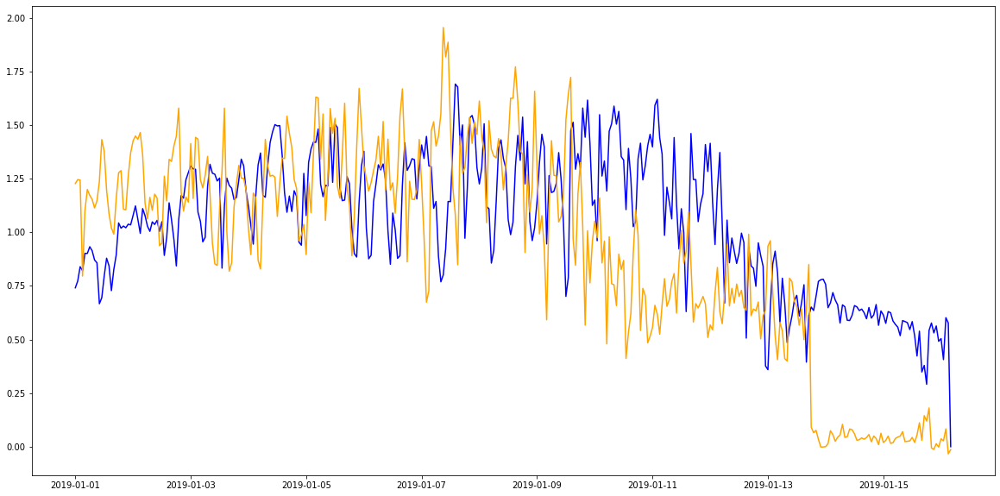

SAMPLED BY:  W


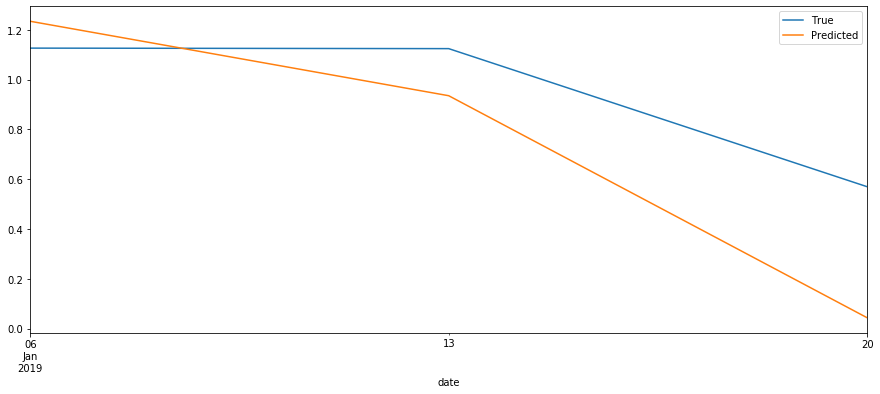

SAMPLED BY:  MS


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


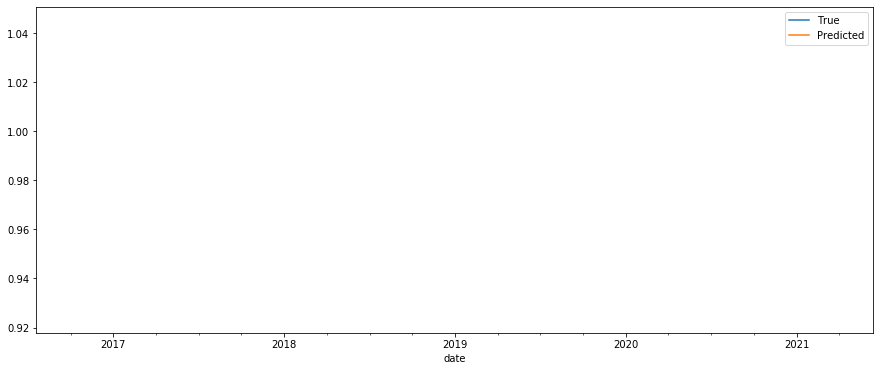

SAMPLED BY:  Q


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


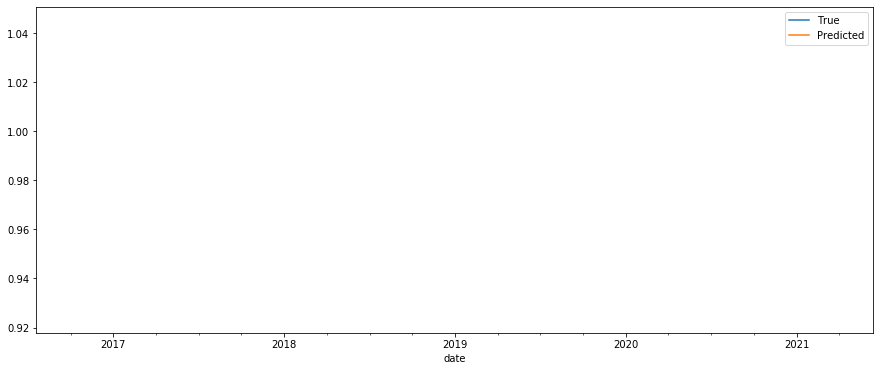

batch1-epochs30-neurons-8/results_lstm_u_model_CO_st0.txt (8760, 3)
shown RMSE: 3.670


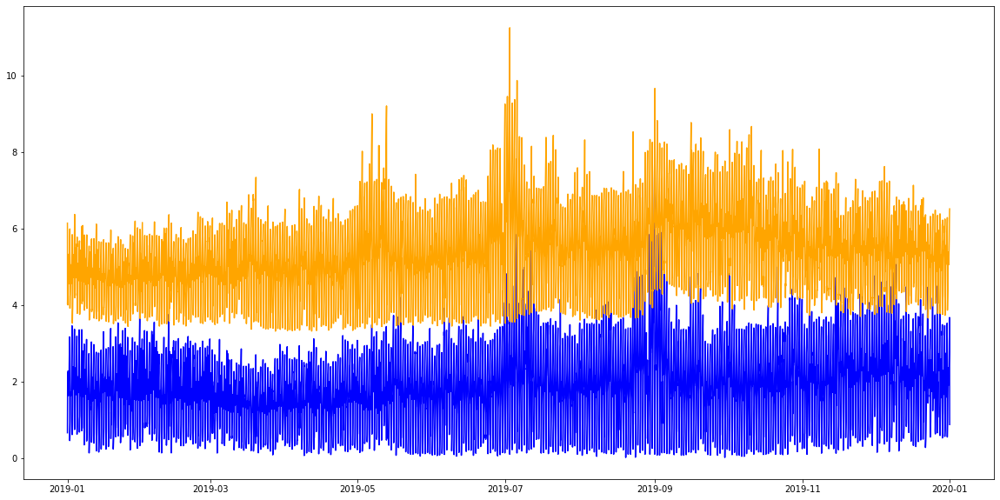

SAMPLED BY:  W


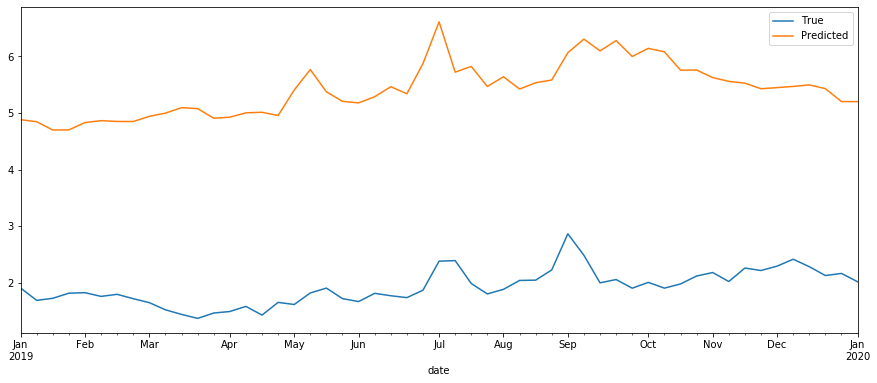

SAMPLED BY:  MS


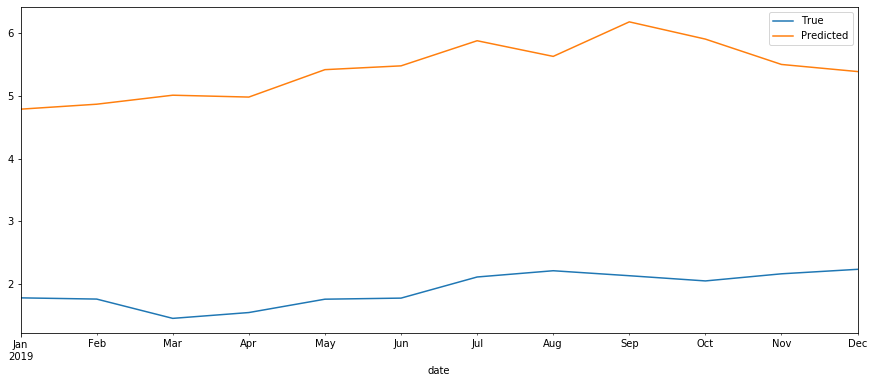

SAMPLED BY:  Q


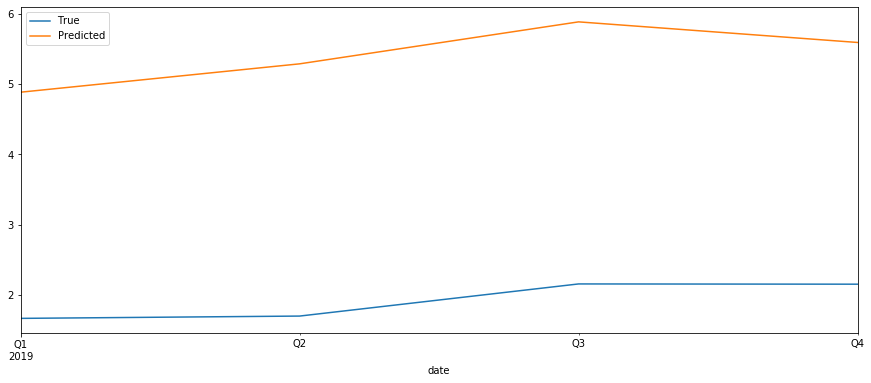

batch1-epochs30-neurons-8/results_lstm_u_model_NO_st0.txt (8760, 3)
shown RMSE: 23.643


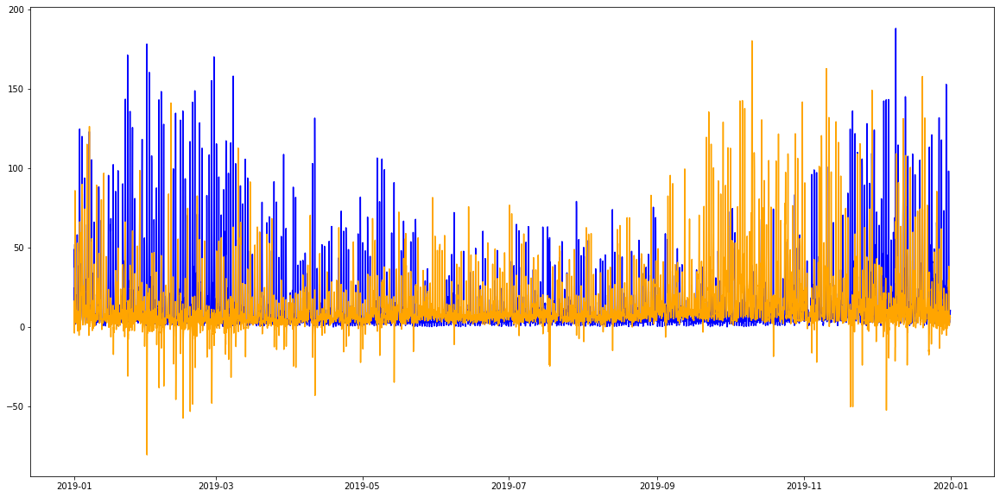

SAMPLED BY:  W


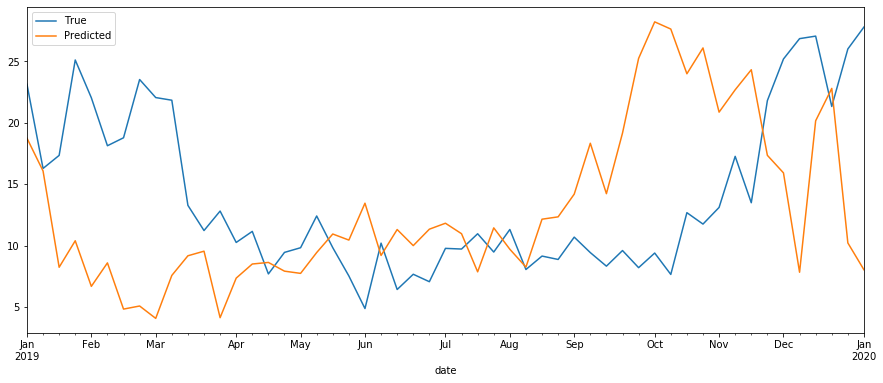

SAMPLED BY:  MS


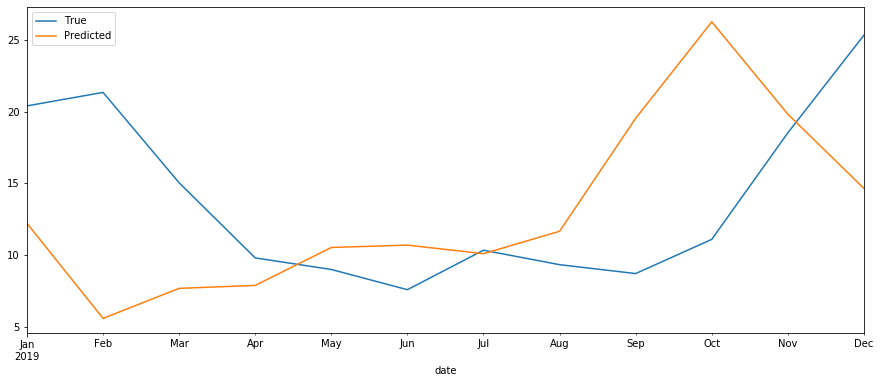

SAMPLED BY:  Q


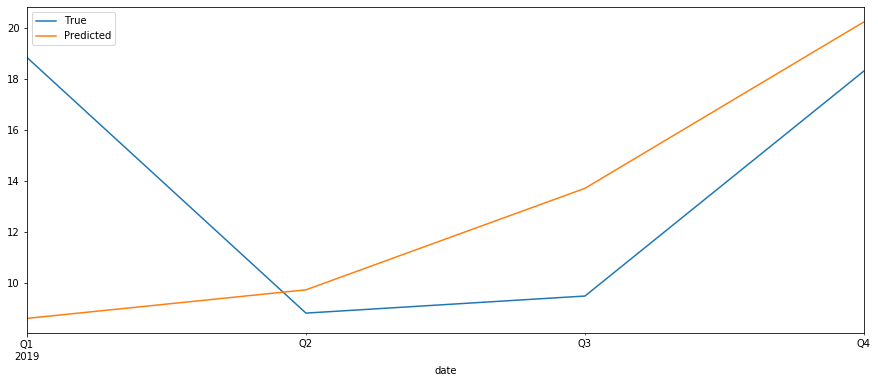

batch1-epochs30-neurons-8/results_lstm_u_model_NO2_st0.txt (8760, 3)
shown RMSE: 10.722


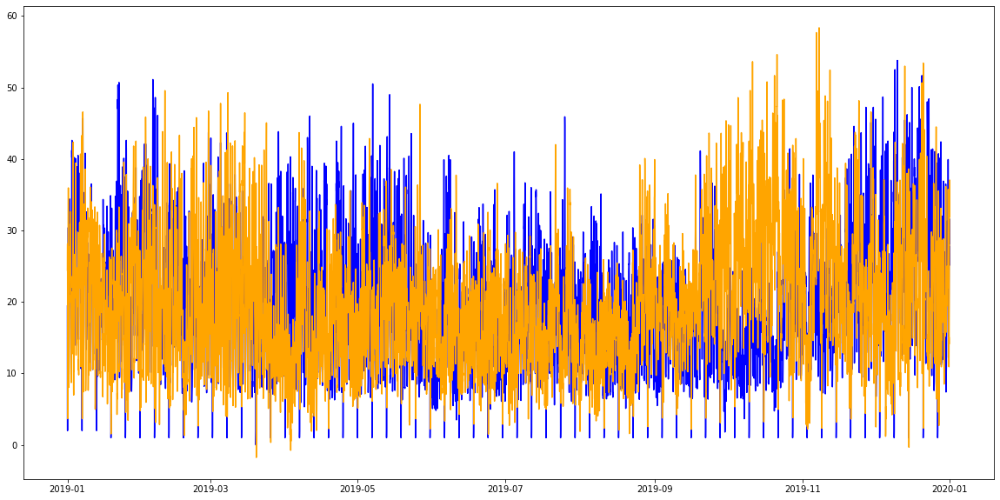

SAMPLED BY:  W


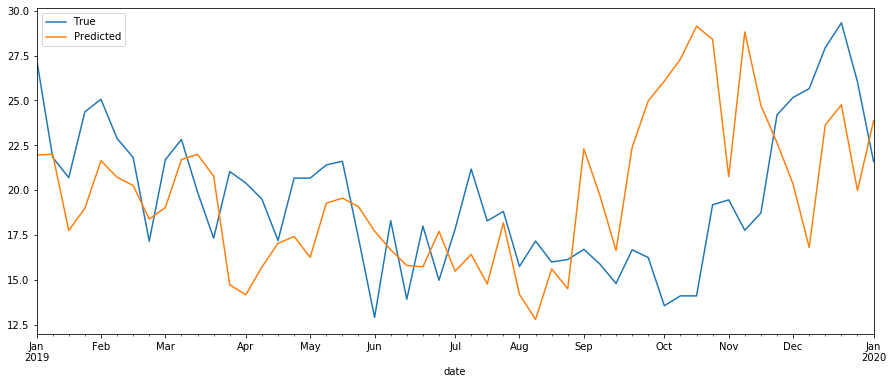

SAMPLED BY:  MS


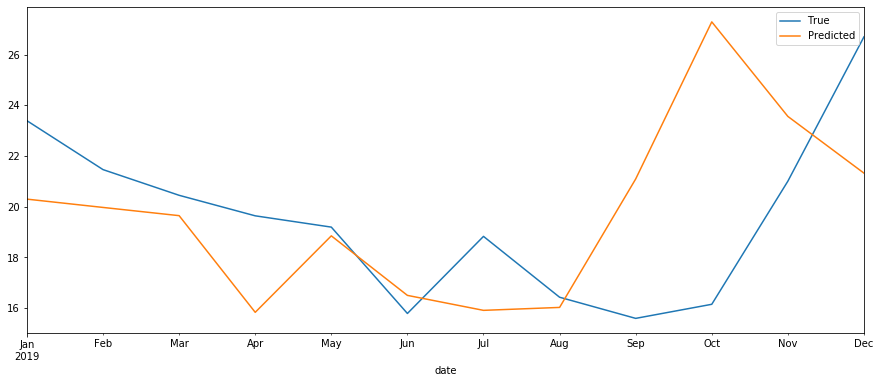

SAMPLED BY:  Q


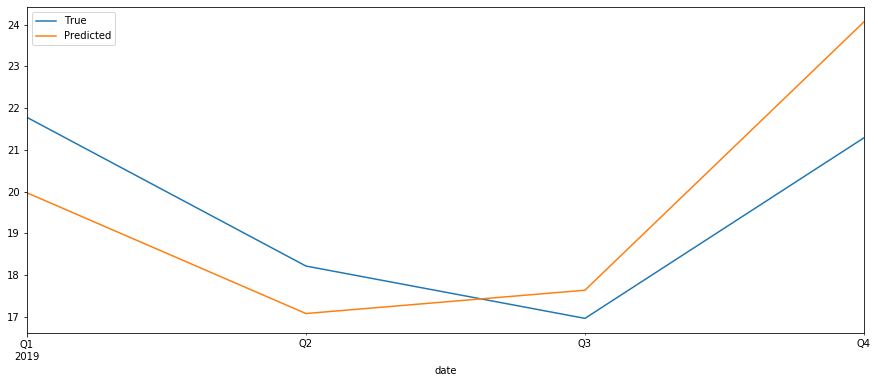

batch1-epochs30-neurons-8/results_lstm_u_model_NOX_st0.txt (8760, 3)
shown RMSE: 28.432


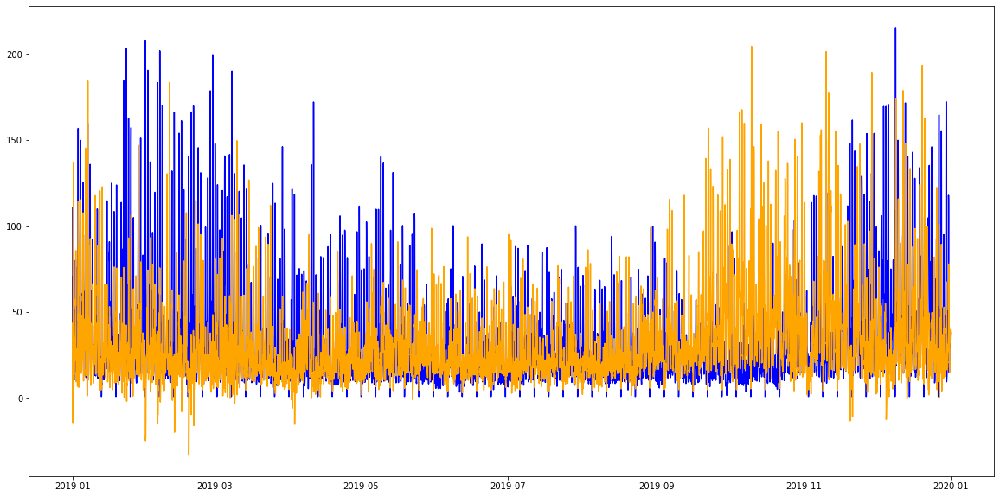

SAMPLED BY:  W


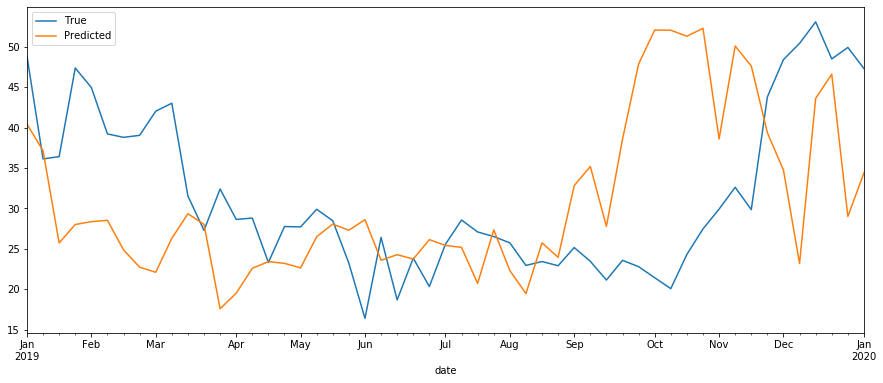

SAMPLED BY:  MS


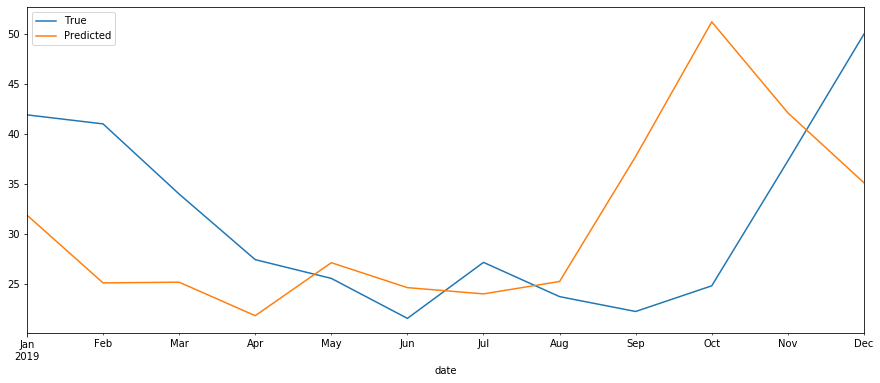

SAMPLED BY:  Q


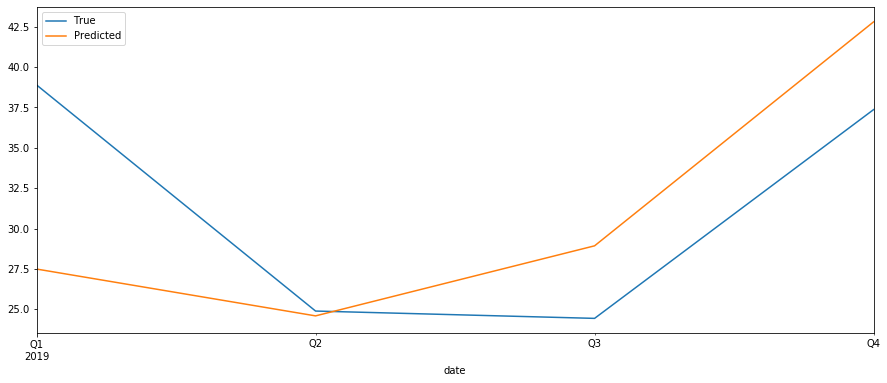

batch1-epochs30-neurons-8/results_lstm_u_model_O3_st0.txt (8760, 3)
shown RMSE: 17.010


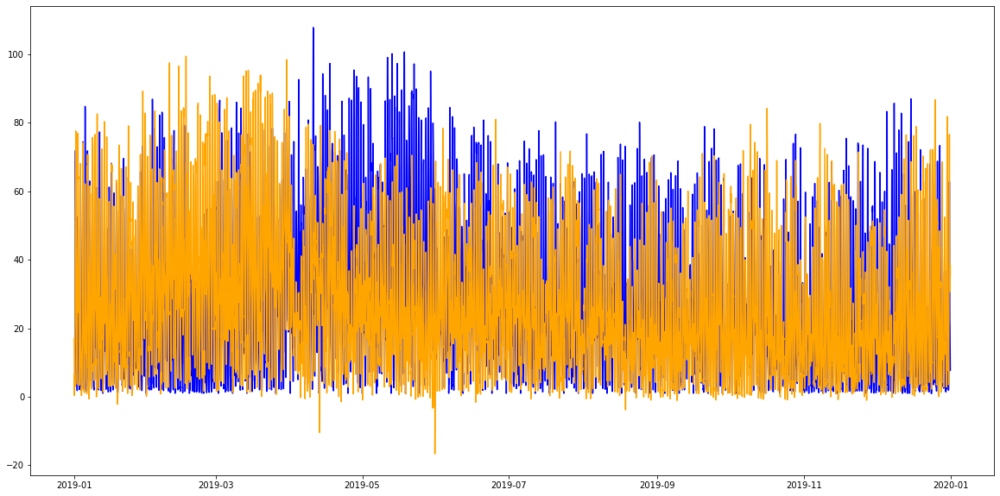

SAMPLED BY:  W


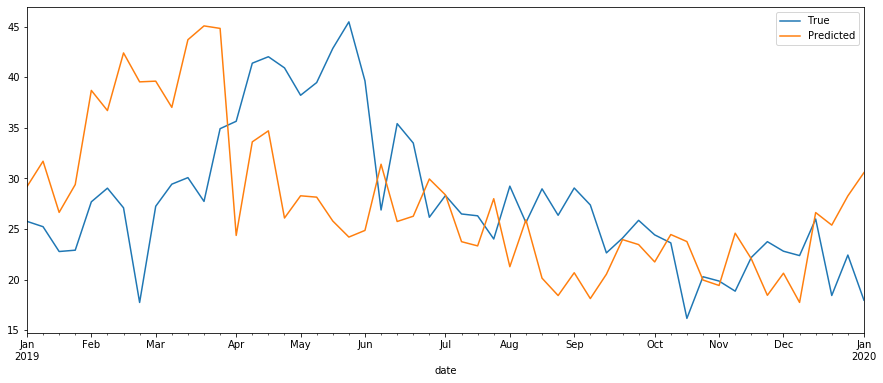

SAMPLED BY:  MS


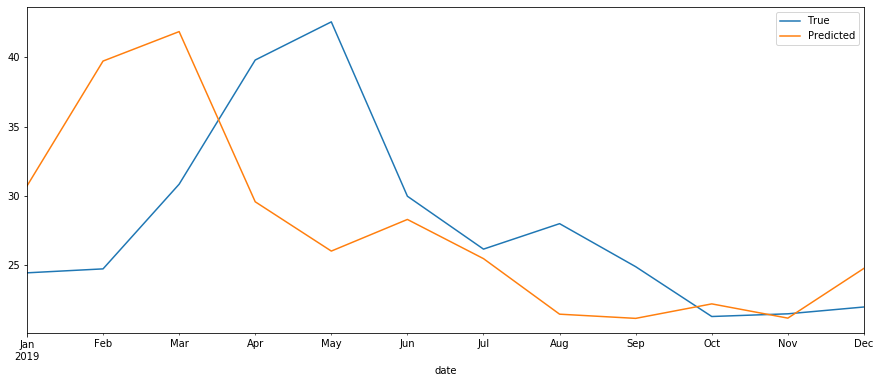

SAMPLED BY:  Q


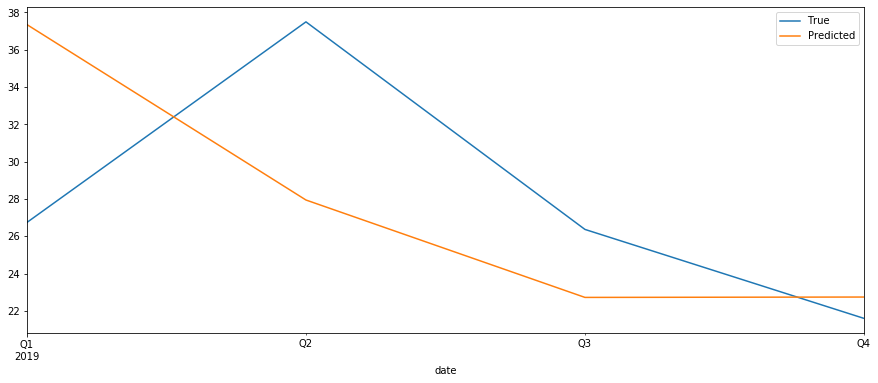

batch1-epochs30-neurons-8/results_lstm_u_model_PM10_st0.txt (8760, 3)
shown RMSE: 27.725


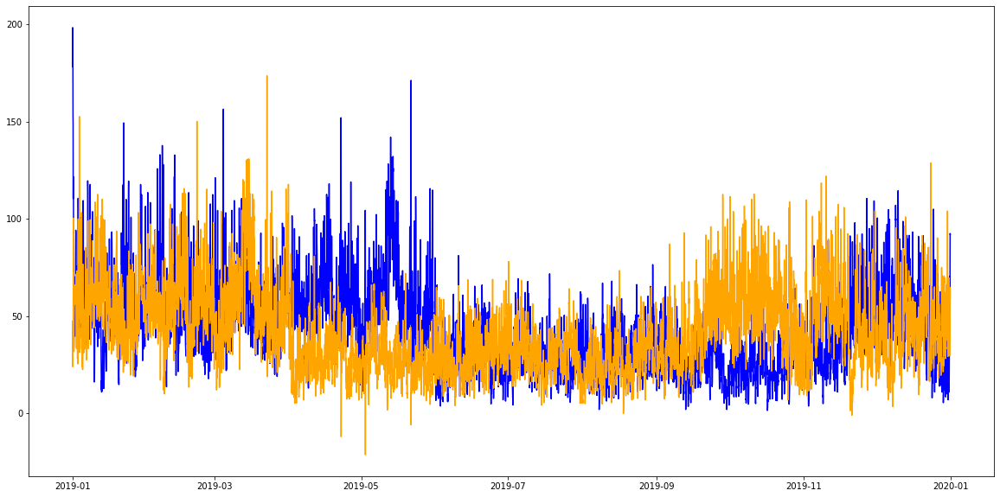

SAMPLED BY:  W


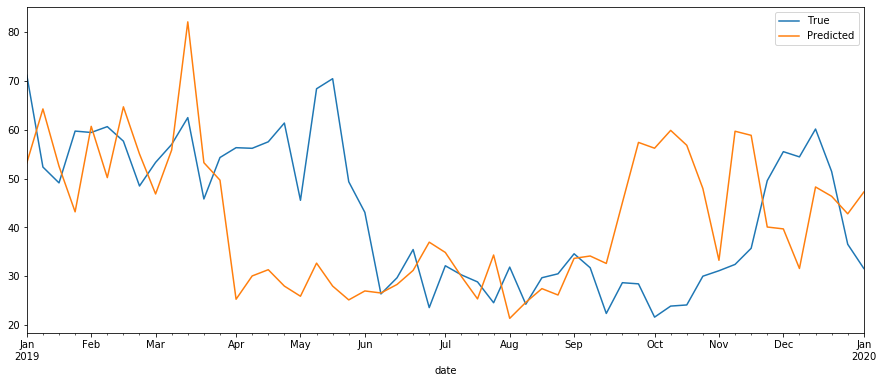

SAMPLED BY:  MS


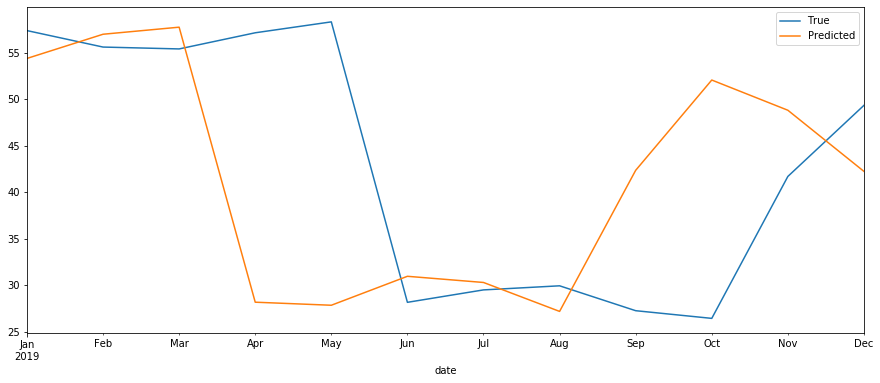

SAMPLED BY:  Q


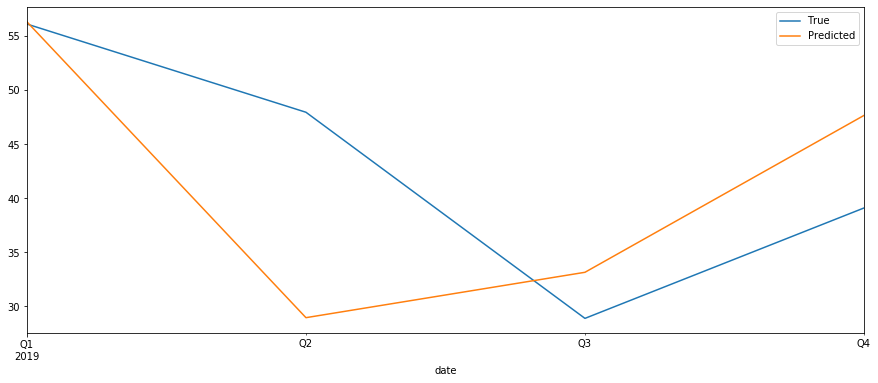

batch1-epochs30-neurons-8/results_lstm_u_model_PM25_st0.txt (8760, 3)
shown RMSE: 16.940


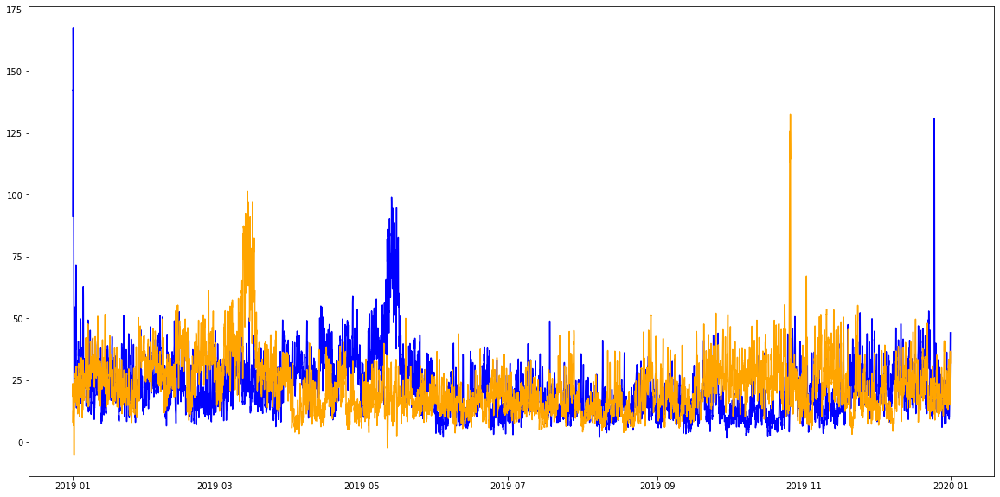

SAMPLED BY:  W


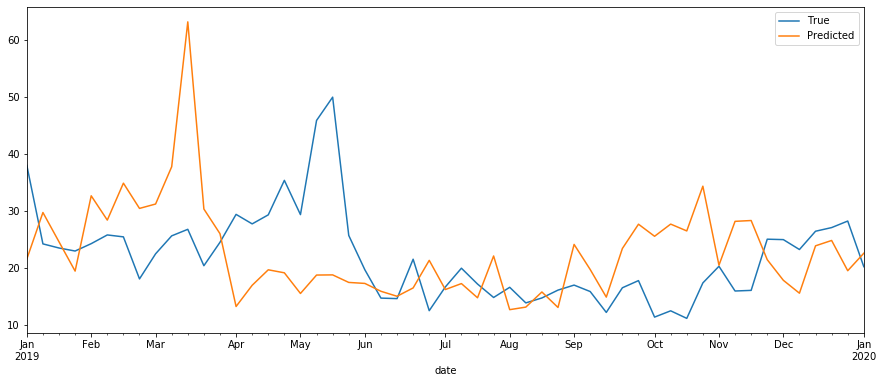

SAMPLED BY:  MS


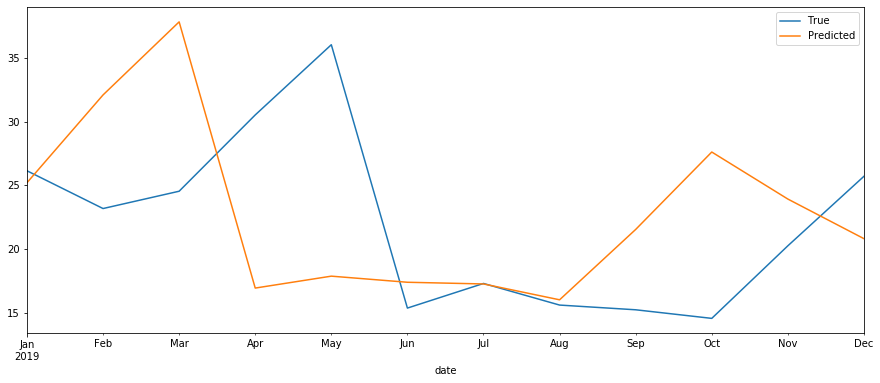

SAMPLED BY:  Q


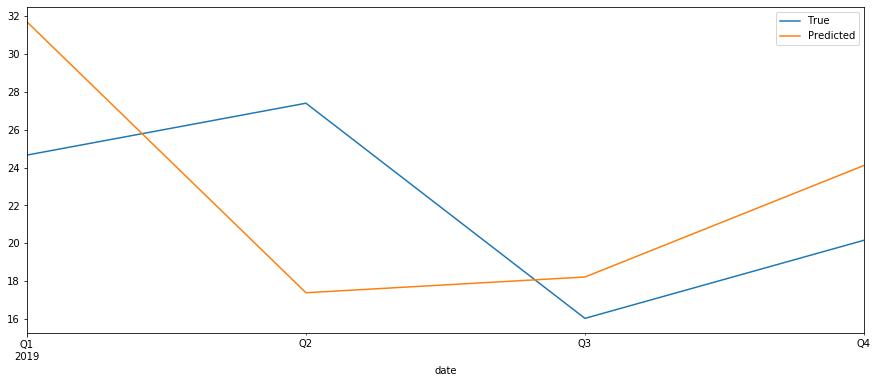

batch1-epochs30-neurons-8/results_lstm_u_model_PMCO_st0.txt (8760, 3)
shown RMSE: 17.191


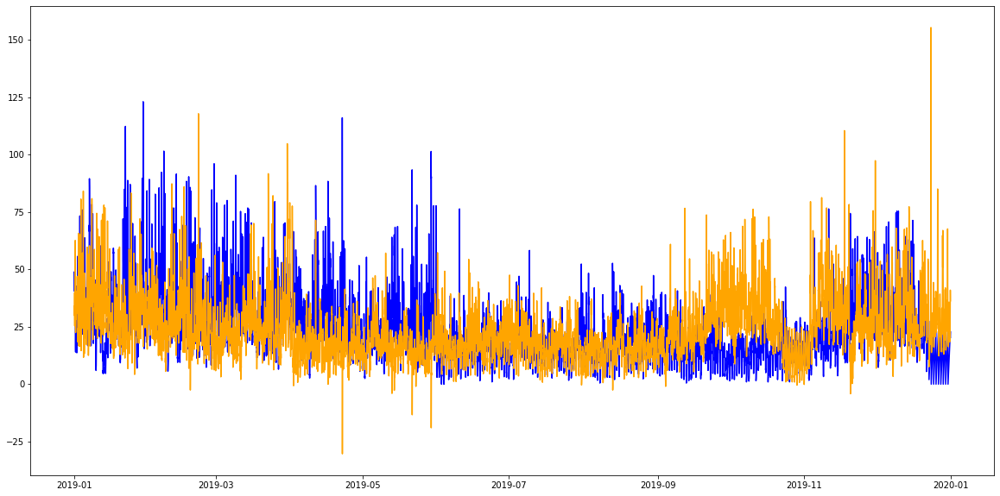

SAMPLED BY:  W


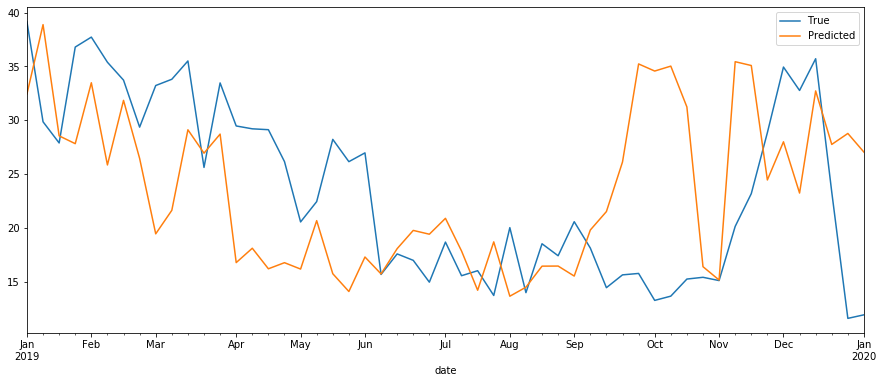

SAMPLED BY:  MS


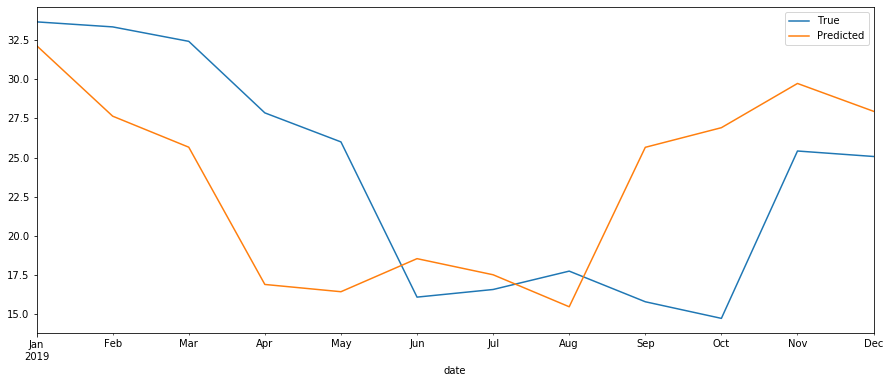

SAMPLED BY:  Q


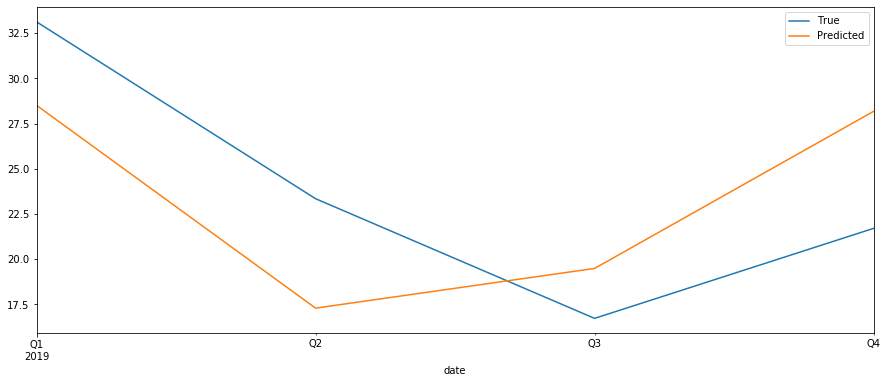

batch1-epochs30-neurons-8/results_lstm_u_model_SO2_st0.txt (8760, 3)
shown RMSE: 4.804


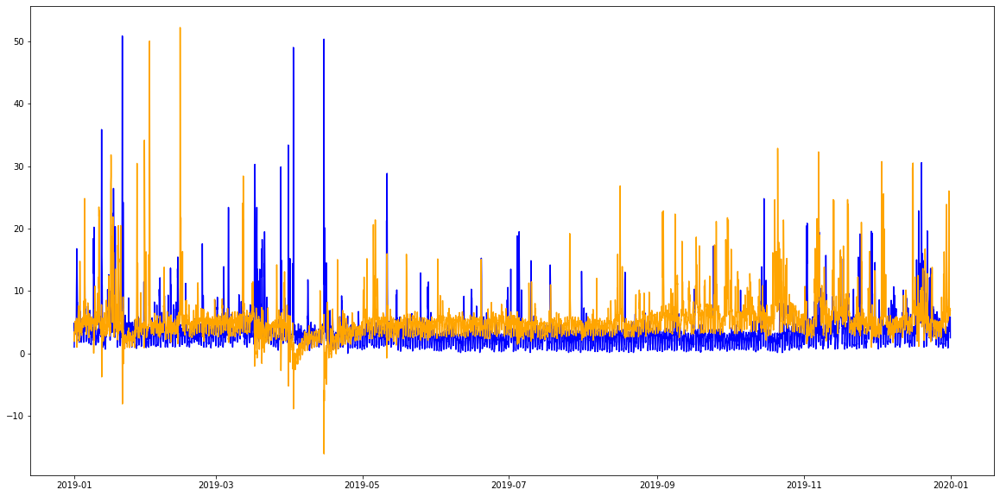

SAMPLED BY:  W


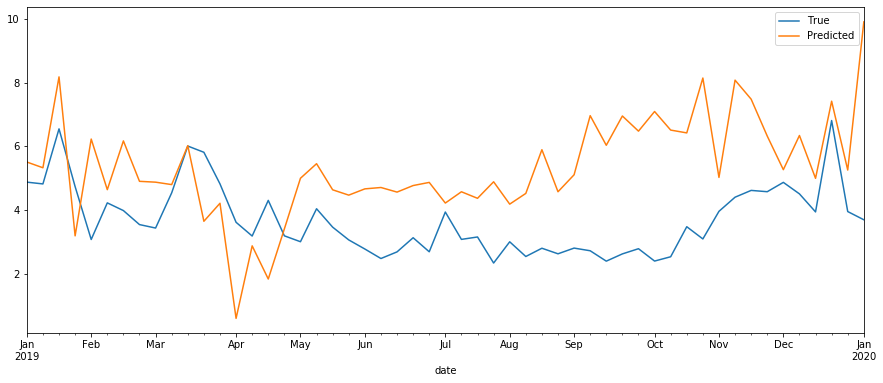

SAMPLED BY:  MS


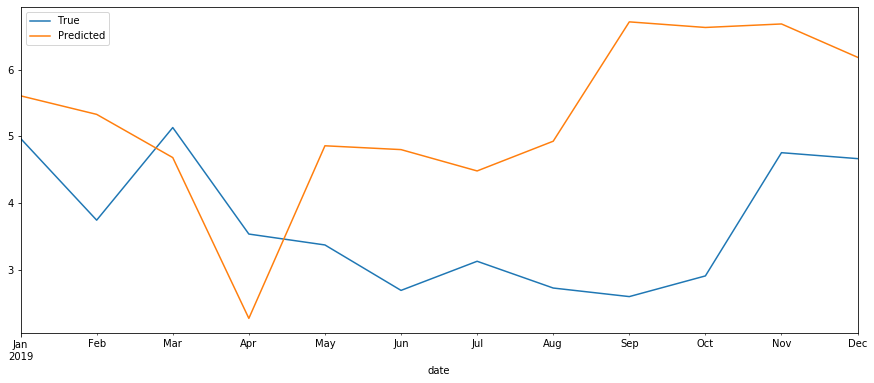

SAMPLED BY:  Q


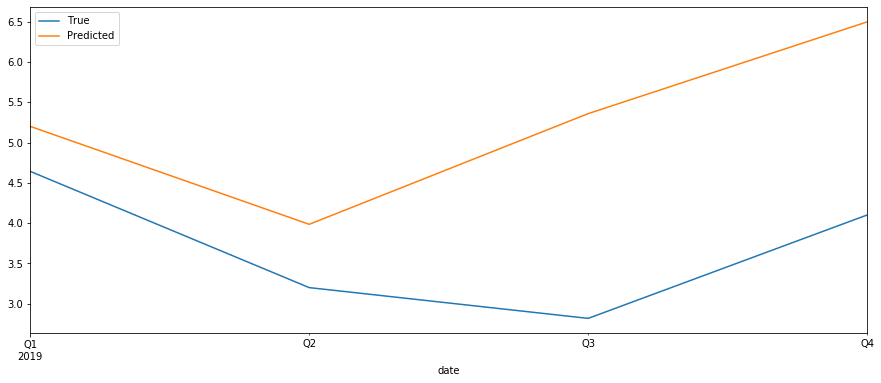

batch1-epochs30-neurons-8/results_lstm_u_model_RH_st0.txt (8760, 3)
shown RMSE: 16.515


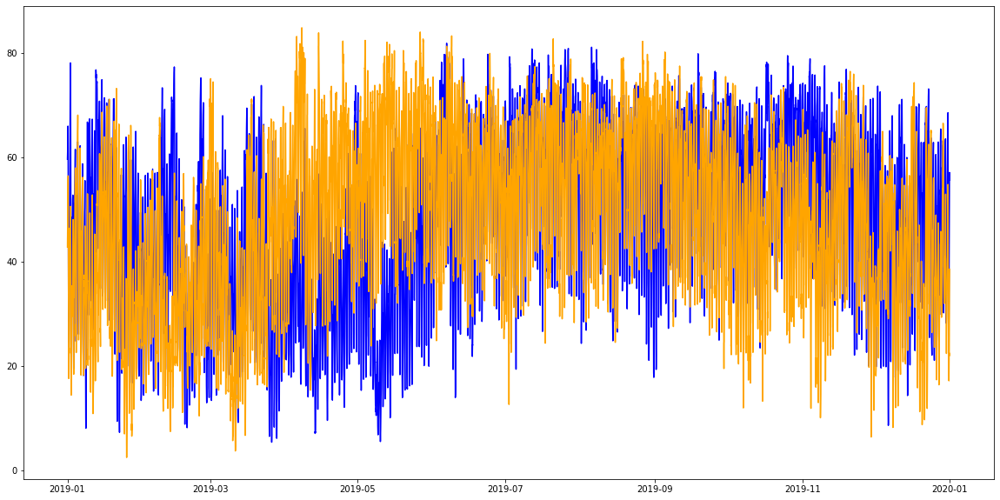

SAMPLED BY:  W


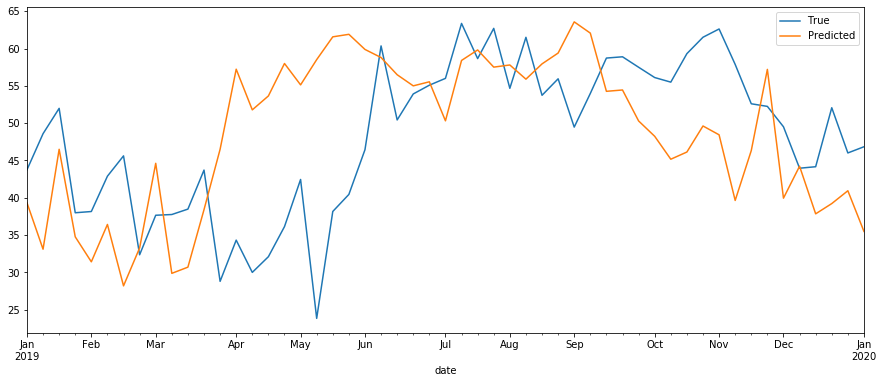

SAMPLED BY:  MS


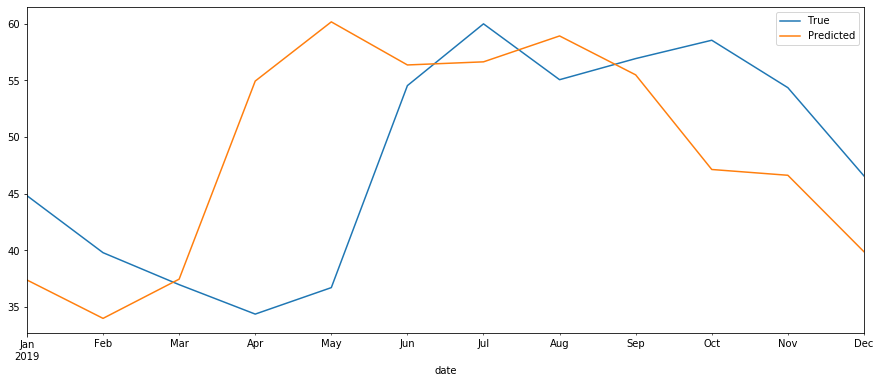

SAMPLED BY:  Q


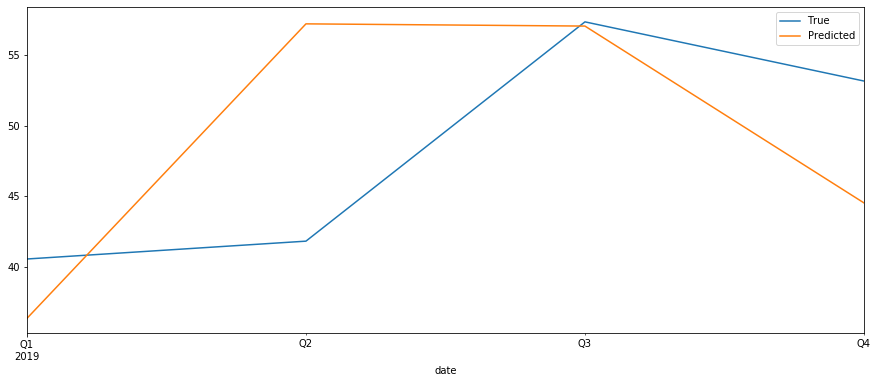

batch1-epochs30-neurons-8/results_lstm_u_model_TMP_st0.txt (8760, 3)
shown RMSE: 3.251


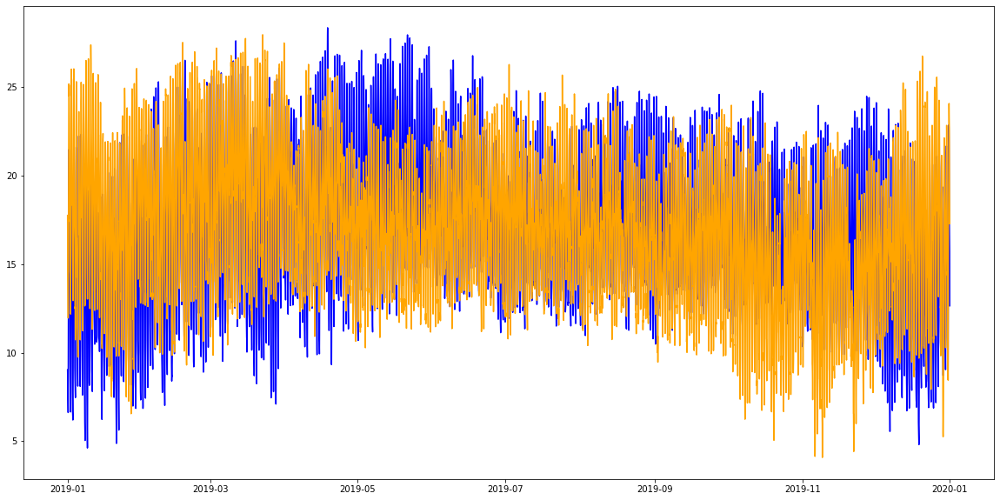

SAMPLED BY:  W


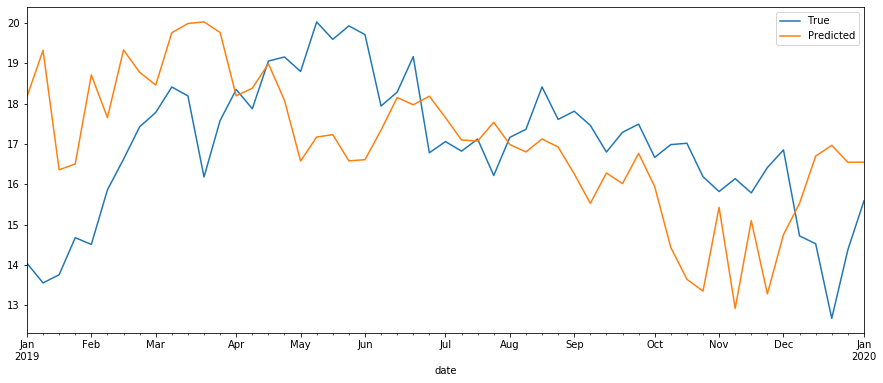

SAMPLED BY:  MS


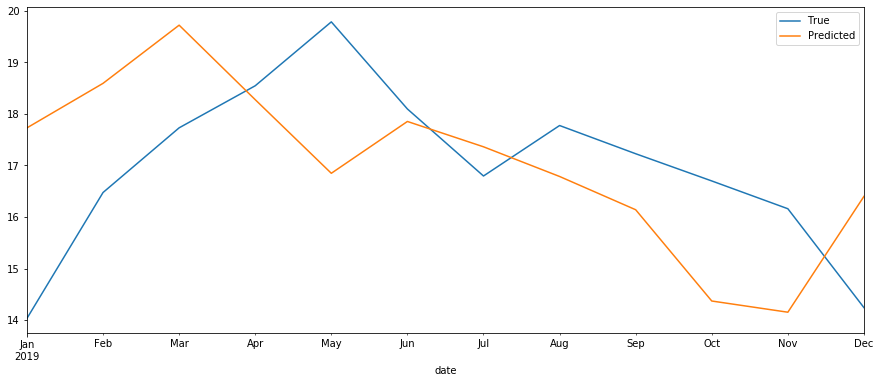

SAMPLED BY:  Q


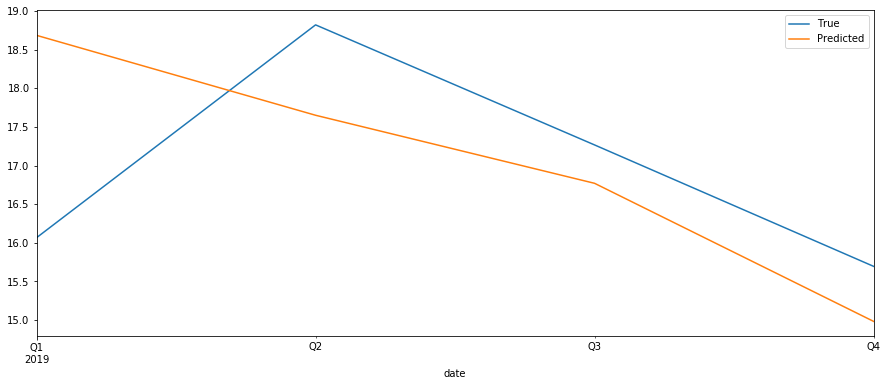

batch1-epochs30-neurons-8/results_lstm_u_model_WDR_st0.txt (8760, 3)
shown RMSE: 80.841


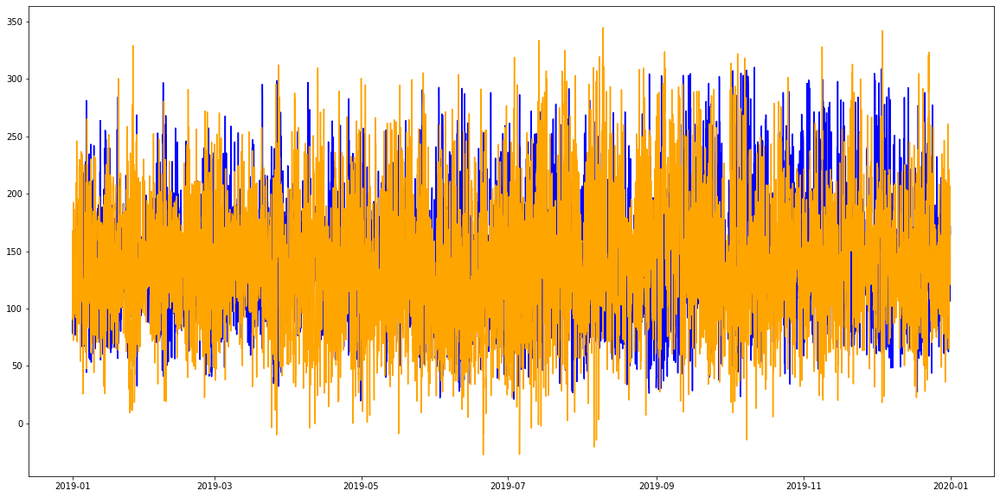

SAMPLED BY:  W


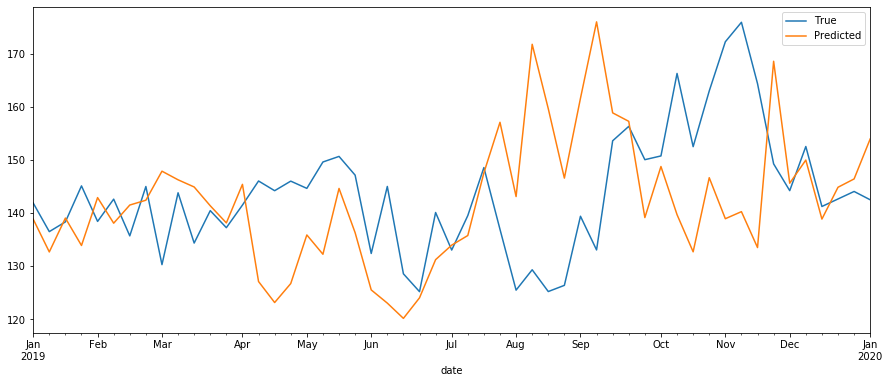

SAMPLED BY:  MS


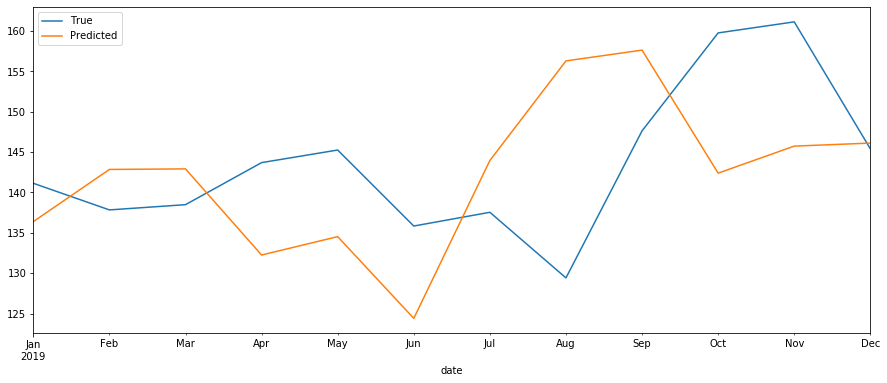

SAMPLED BY:  Q


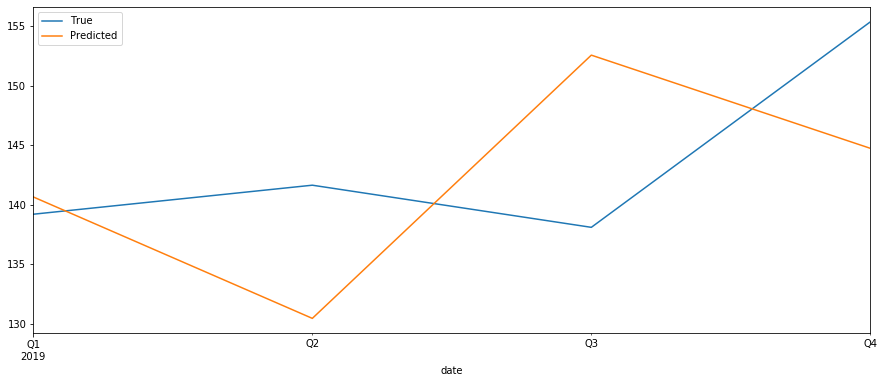

batch1-epochs30-neurons-8/results_lstm_u_model_WSP_st0.txt (8760, 3)
shown RMSE: 1.198


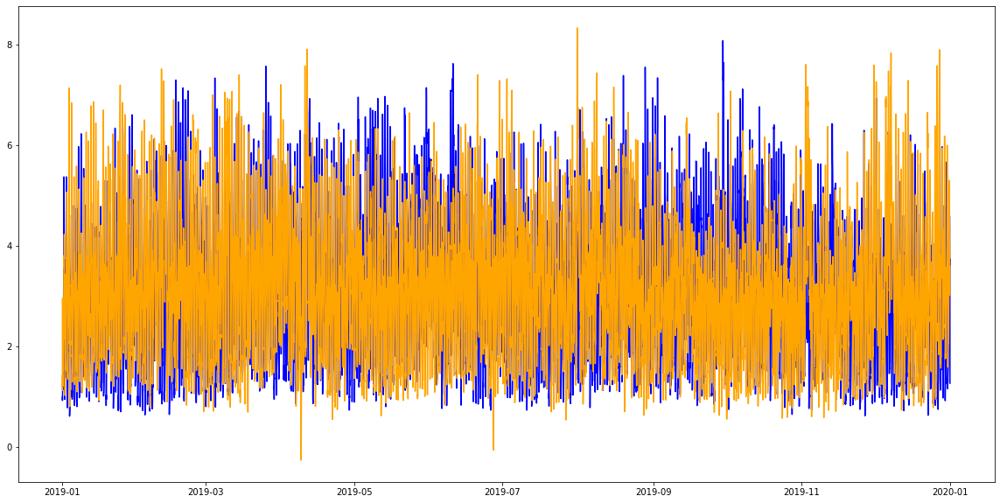

SAMPLED BY:  W


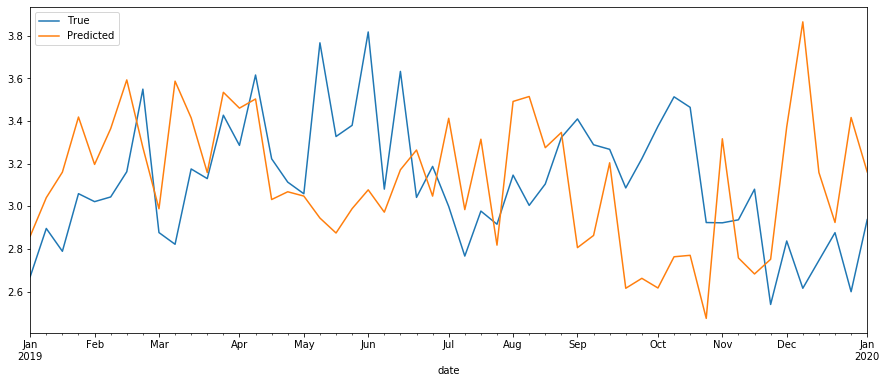

SAMPLED BY:  MS


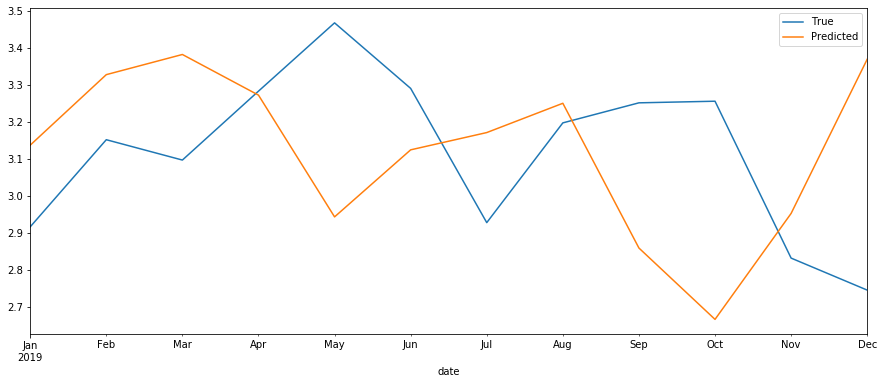

SAMPLED BY:  Q


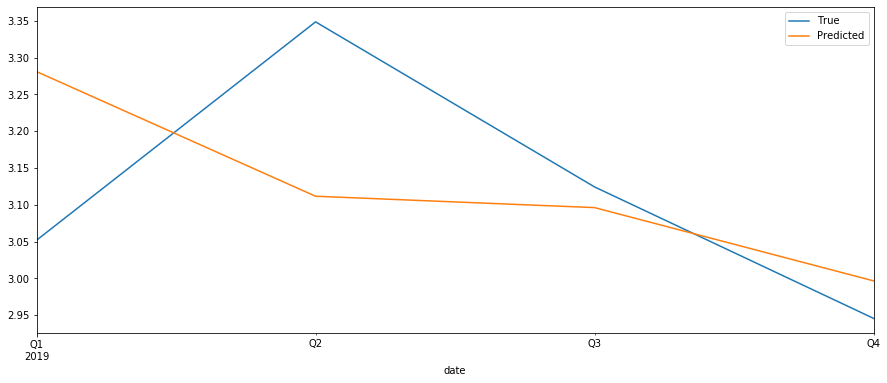

batch1-epochs30-neurons-8/results_lstm_u_model_PA_st.txt (8760, 3)
shown RMSE: 1.845


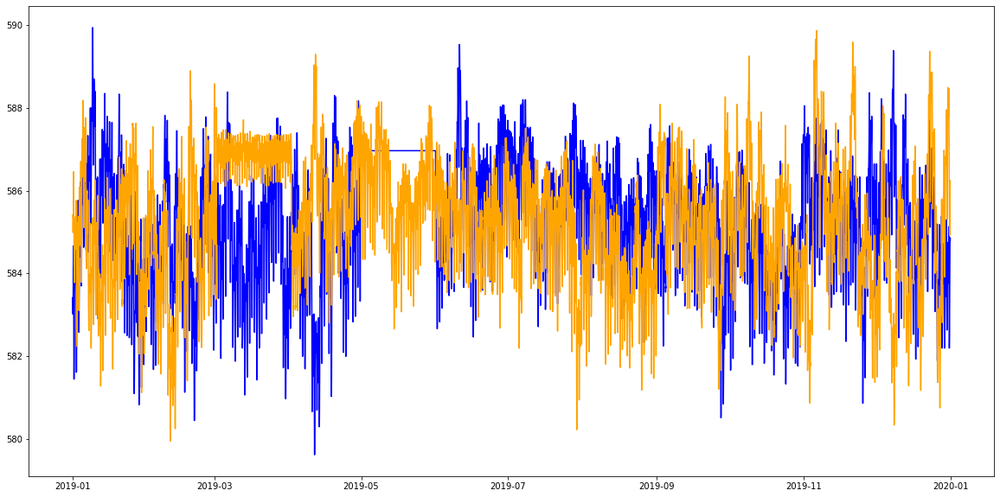

SAMPLED BY:  W


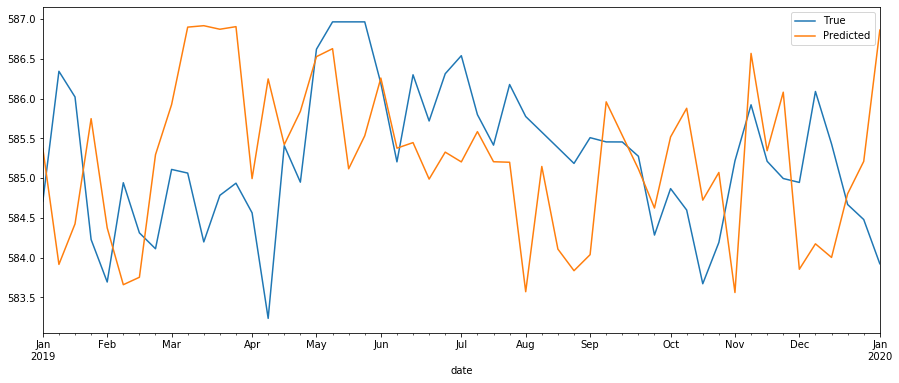

SAMPLED BY:  MS


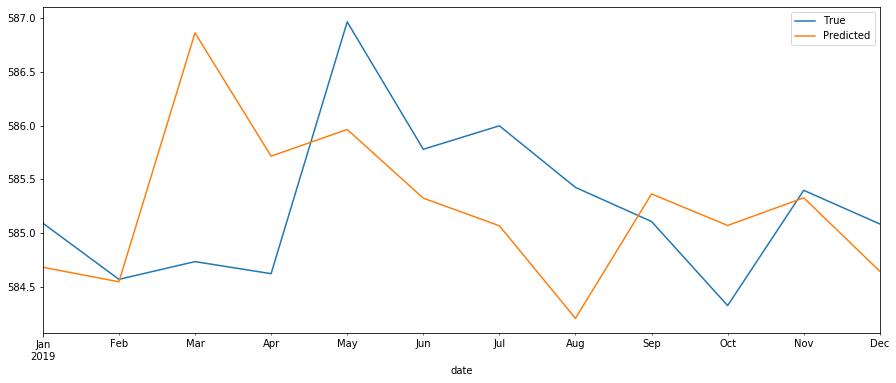

SAMPLED BY:  Q


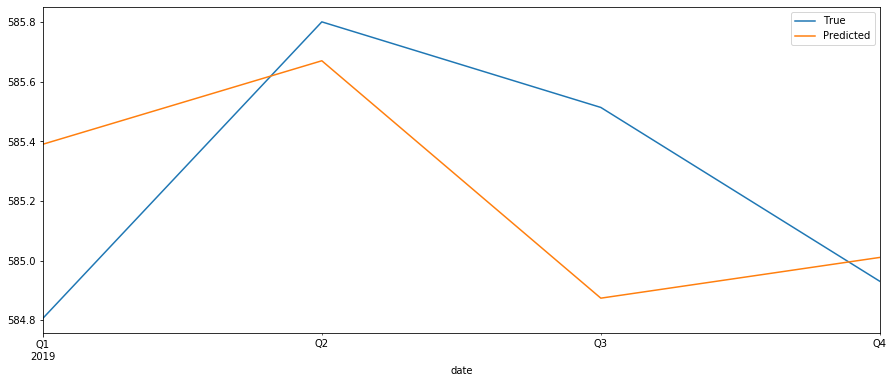

batch1-epochs30-neurons-8/results_lstm_u_model_UVA_st.txt (8760, 3)
shown RMSE: 1.000


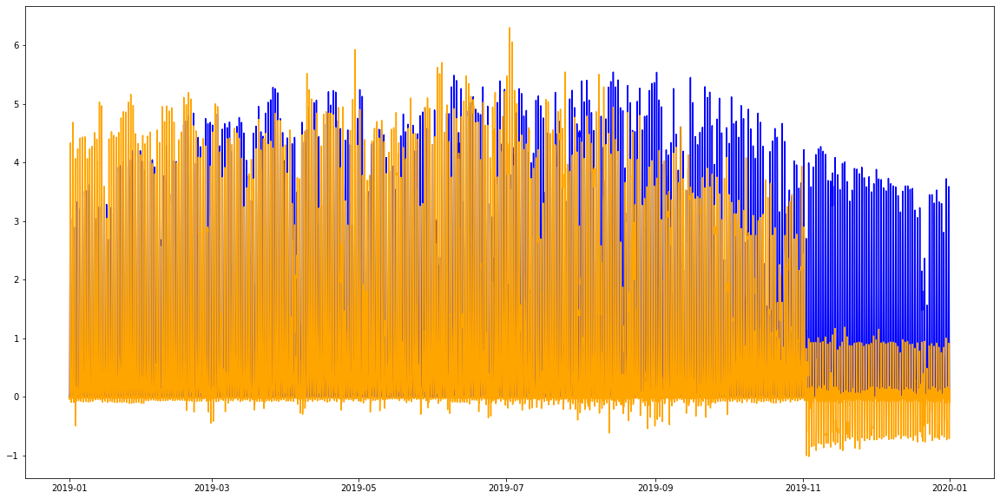

SAMPLED BY:  W


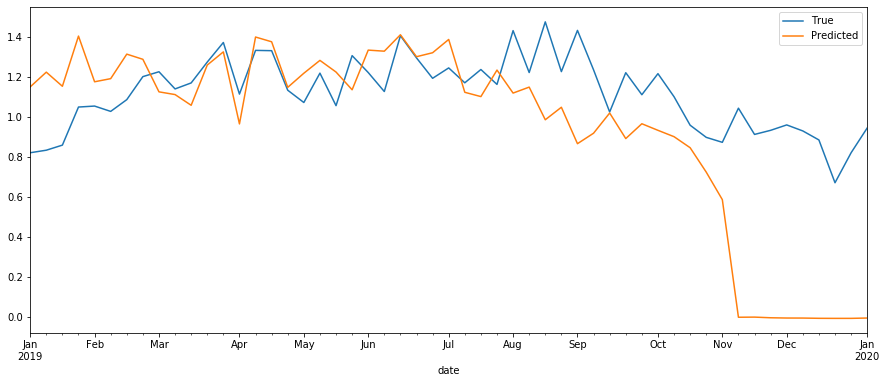

SAMPLED BY:  MS


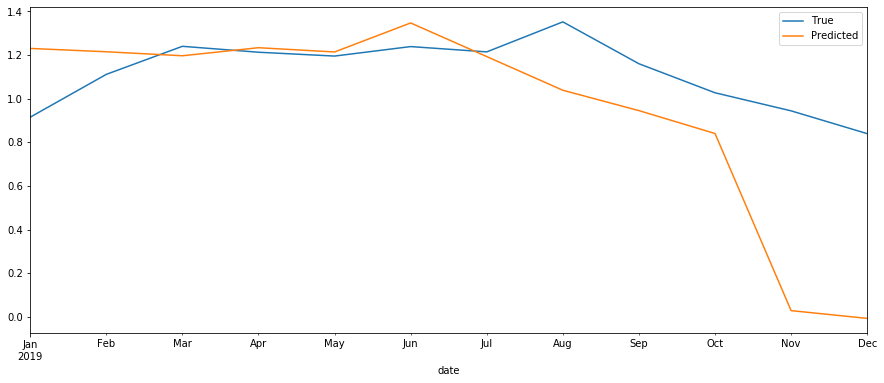

SAMPLED BY:  Q


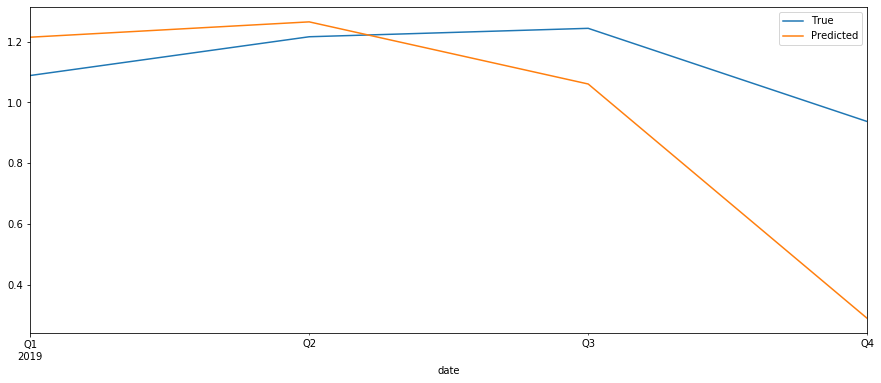

batch1-epochs30-neurons-8/results_lstm_u_model_UVB_st.txt (8760, 3)
shown RMSE: 0.954


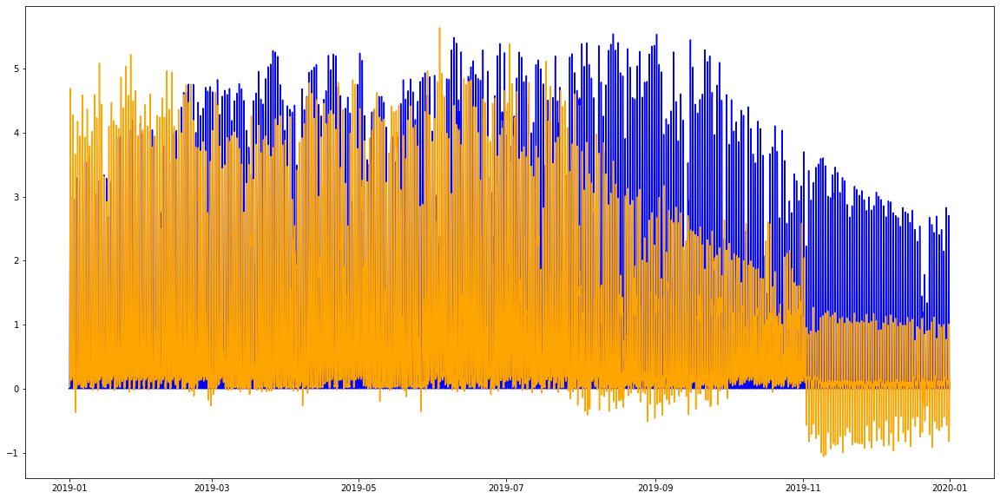

SAMPLED BY:  W


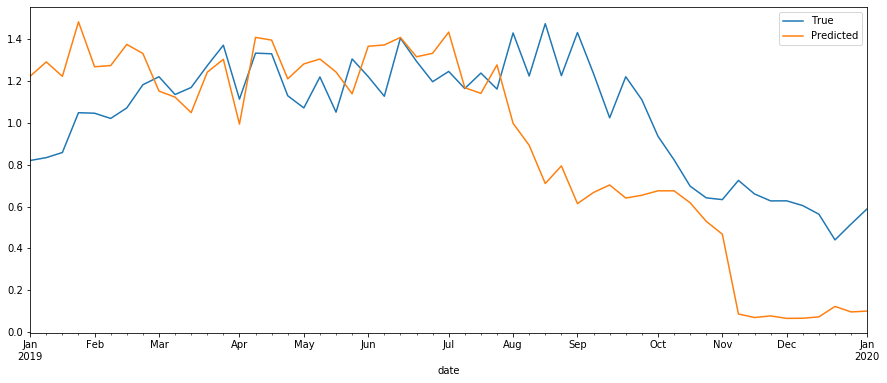

SAMPLED BY:  MS


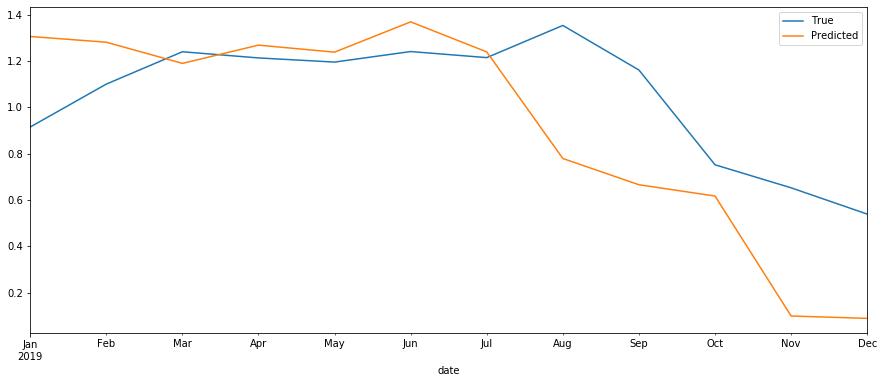

SAMPLED BY:  Q


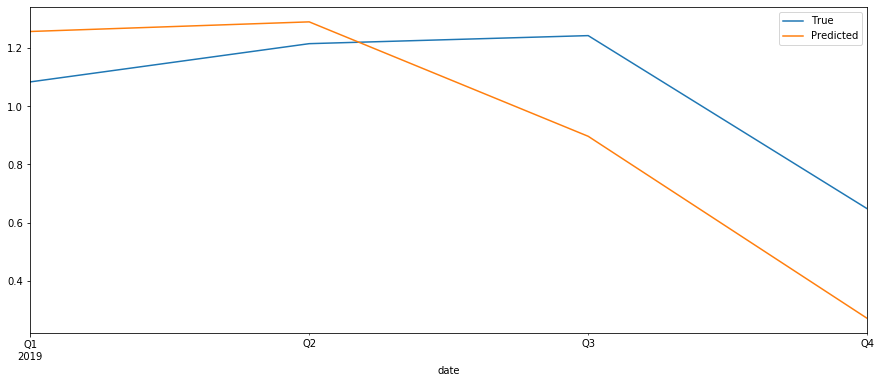

batch1-epochs30-neurons-8-resampledDay/results_lstm_u_model_CO_st0.txt (365, 3)
shown RMSE: 0.437


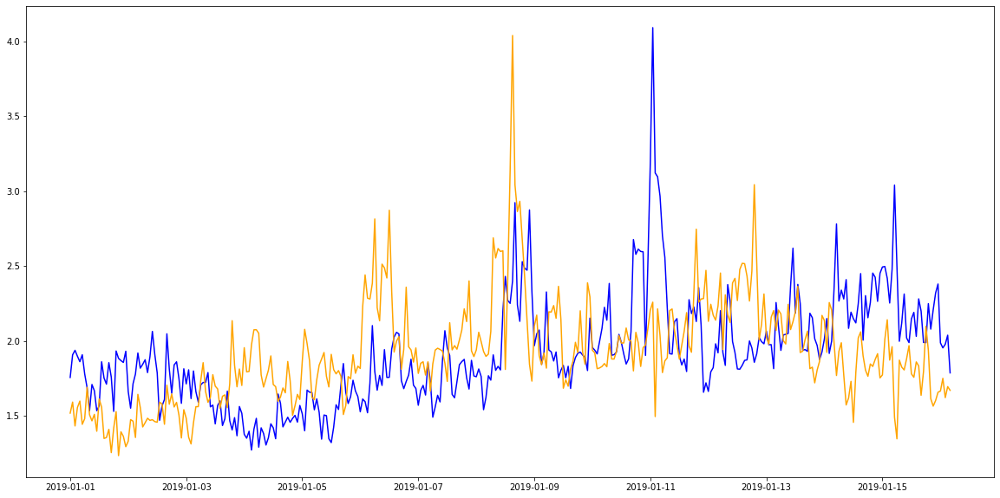

SAMPLED BY:  W


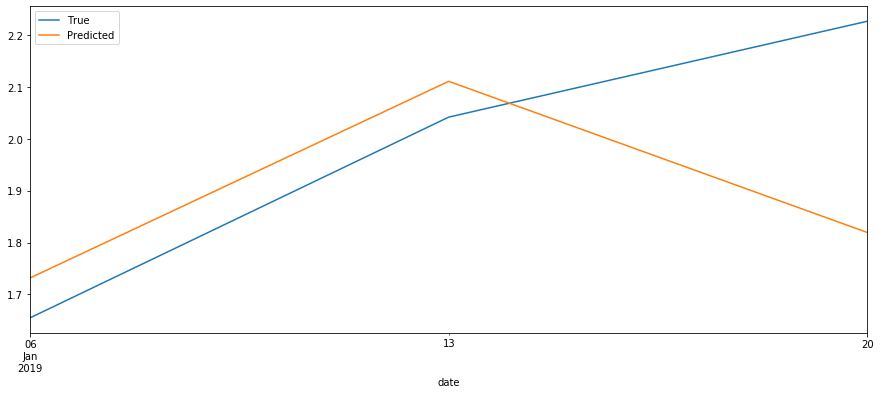

SAMPLED BY:  MS


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


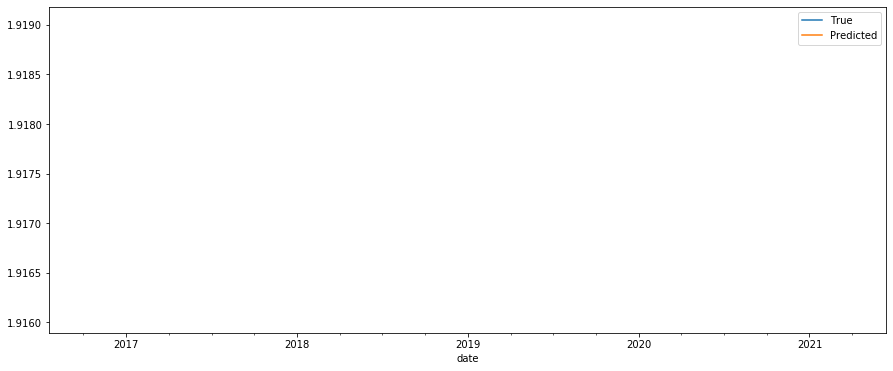

SAMPLED BY:  Q


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


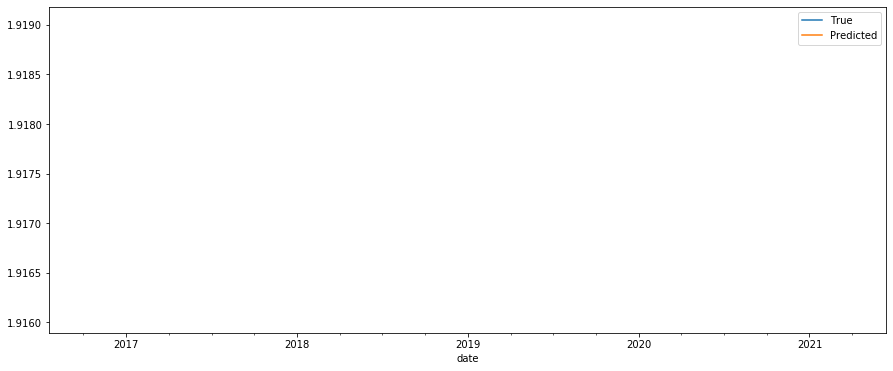

batch1-epochs30-neurons-8-resampledDay/results_lstm_u_model_NO_st0.txt (365, 3)
shown RMSE: 11.886


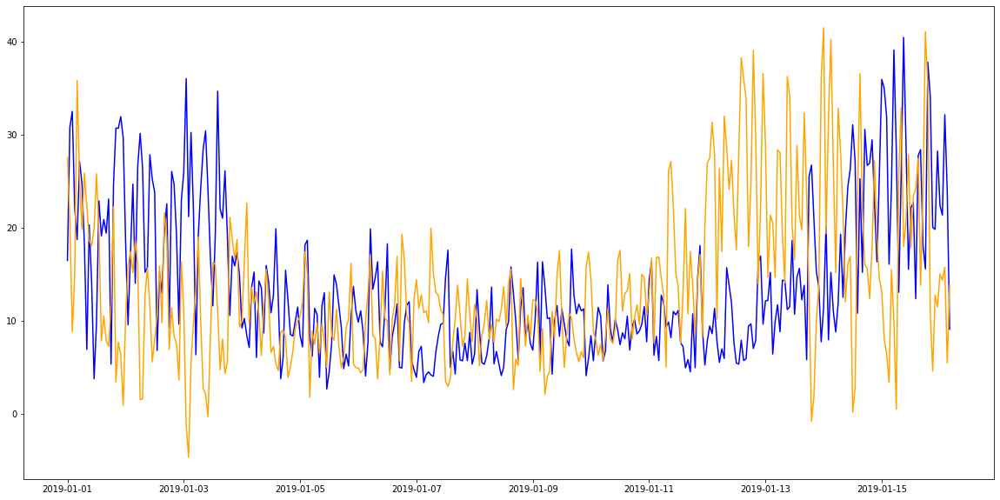

SAMPLED BY:  W


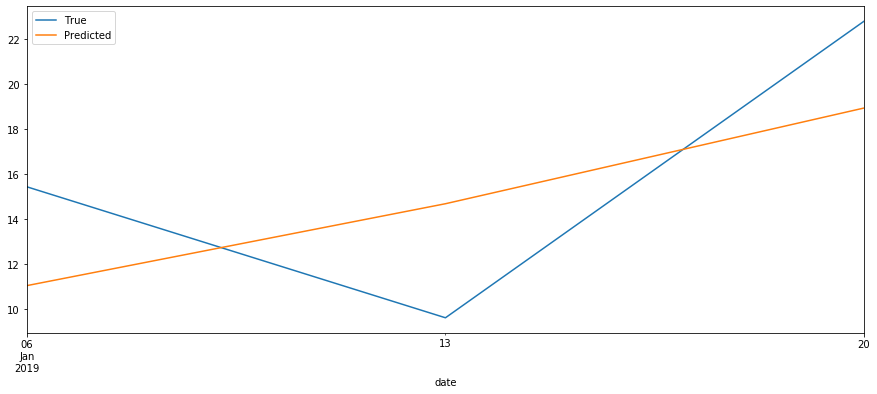

SAMPLED BY:  MS


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


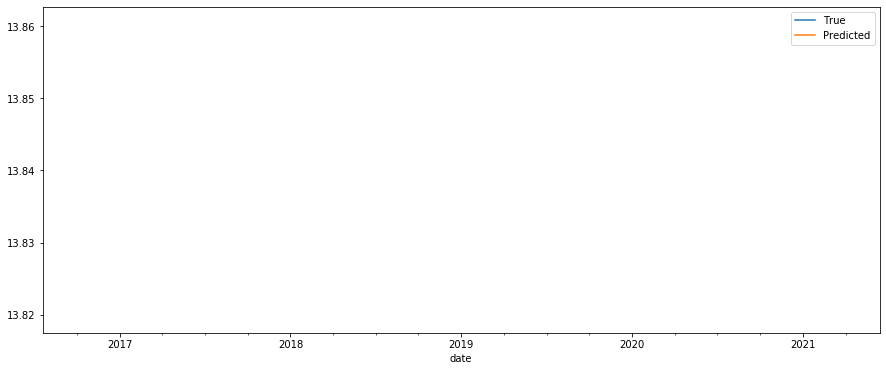

SAMPLED BY:  Q


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


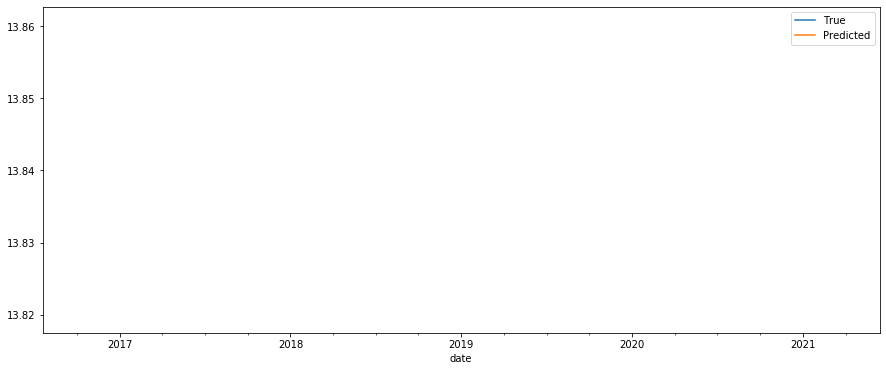

batch1-epochs30-neurons-8-resampledDay/results_lstm_u_model_NO2_st0.txt (365, 3)
shown RMSE: 7.417


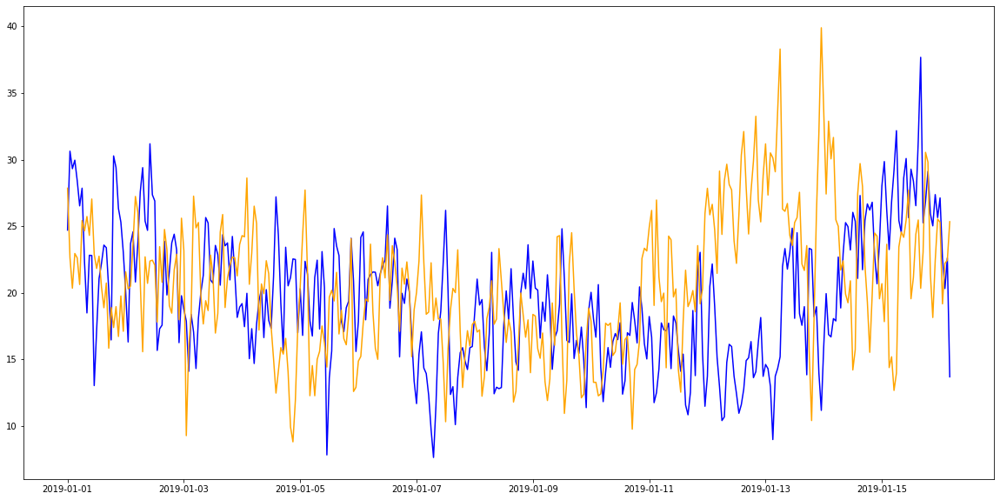

SAMPLED BY:  W


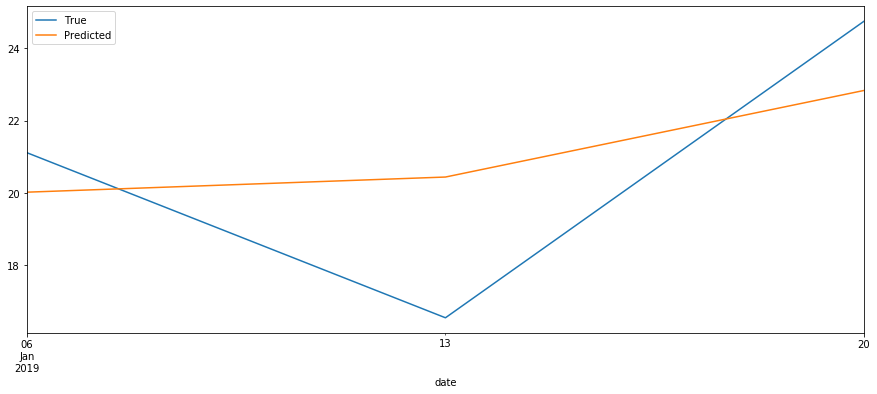

SAMPLED BY:  MS


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


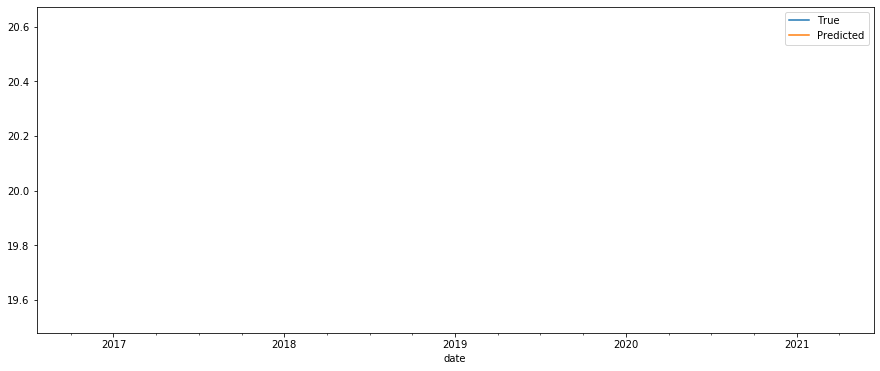

C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


SAMPLED BY:  Q


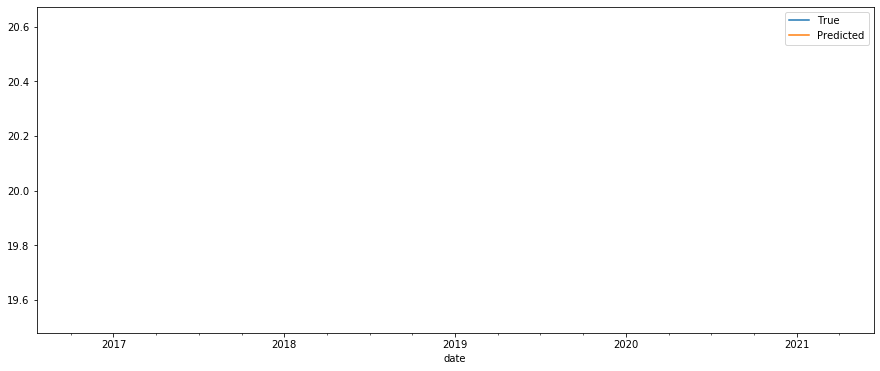

batch1-epochs30-neurons-8-resampledDay/results_lstm_u_model_NOX_st0.txt (365, 3)
shown RMSE: 17.476


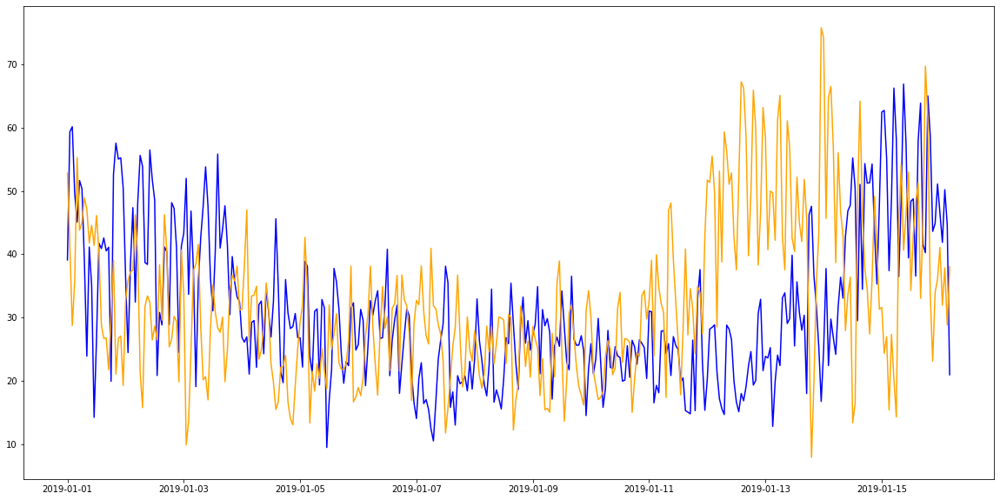

SAMPLED BY:  W


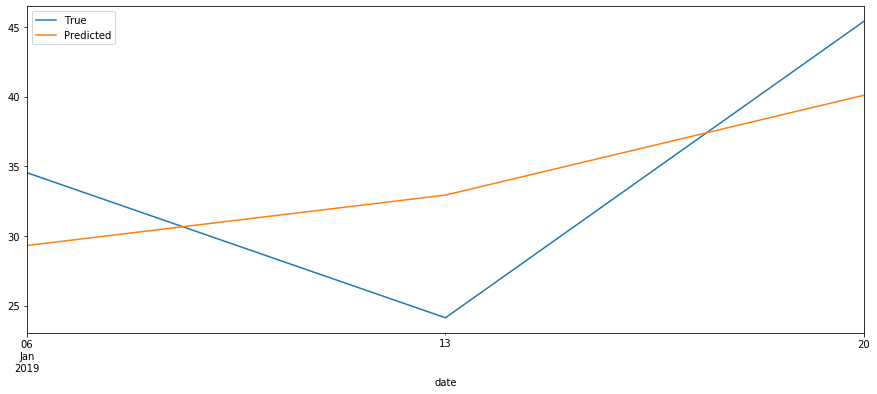

SAMPLED BY:  MS


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


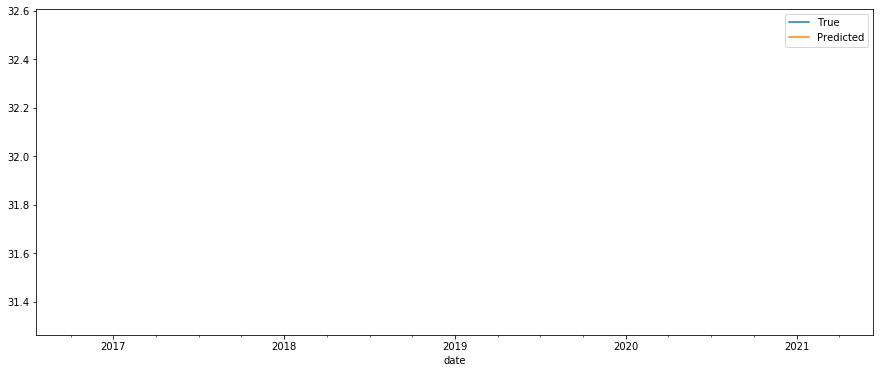

SAMPLED BY:  Q


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


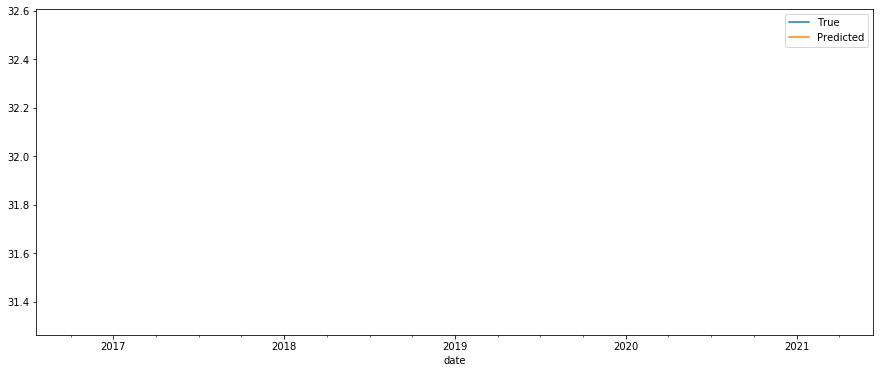

batch1-epochs30-neurons-8-resampledDay/results_lstm_u_model_O3_st0.txt (365, 3)
shown RMSE: 11.097


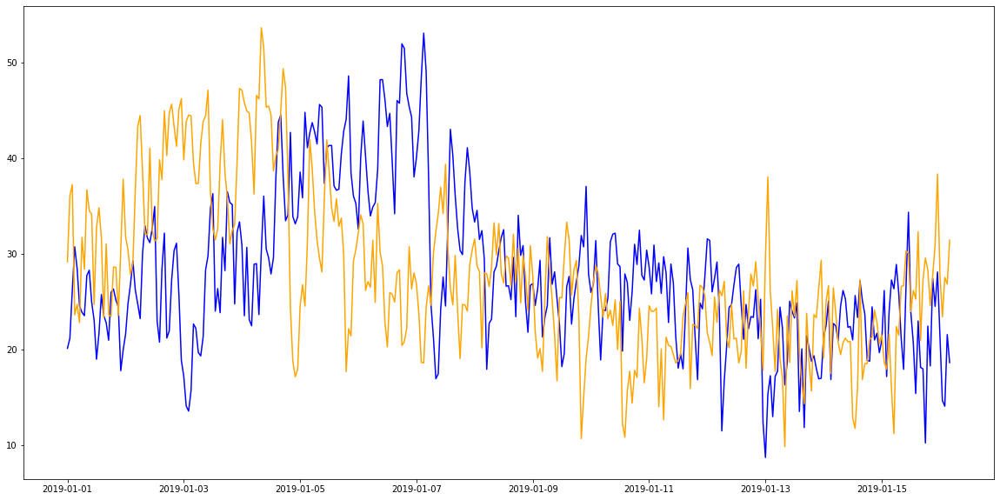

SAMPLED BY:  W


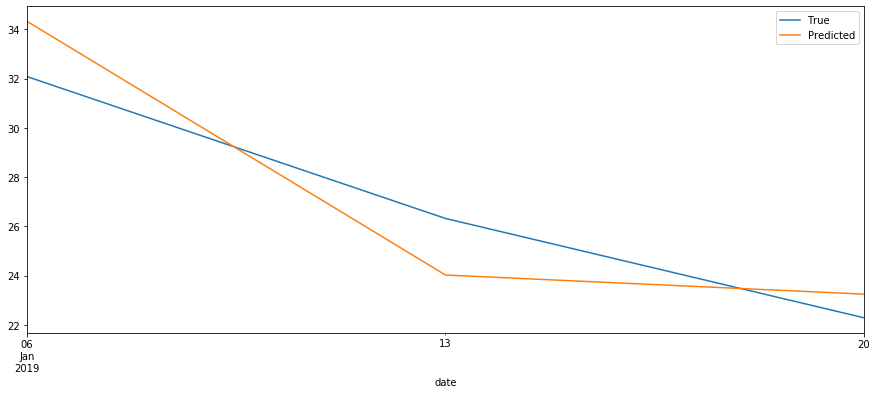

SAMPLED BY:  MS


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


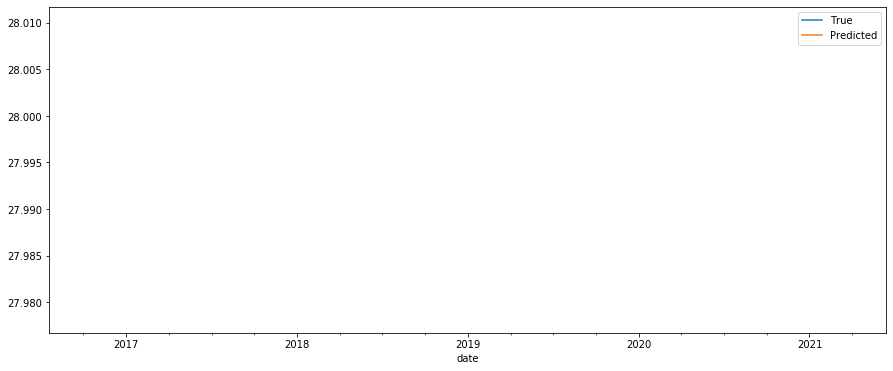

SAMPLED BY:  Q


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


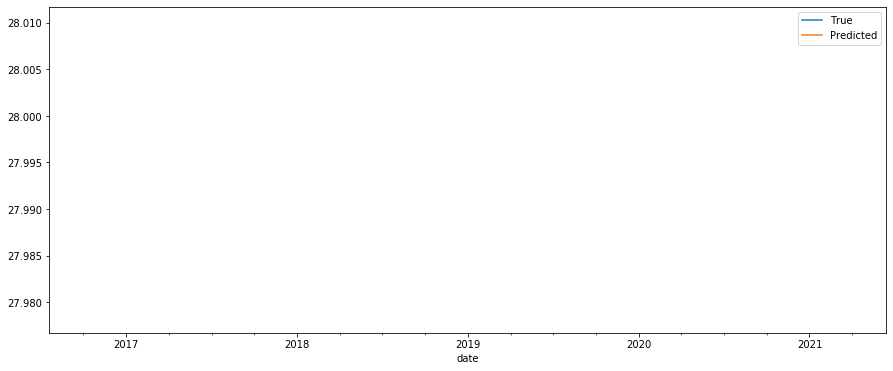

batch1-epochs30-neurons-8-resampledDay/results_lstm_u_model_PM10_st0.txt (365, 3)
shown RMSE: 22.164


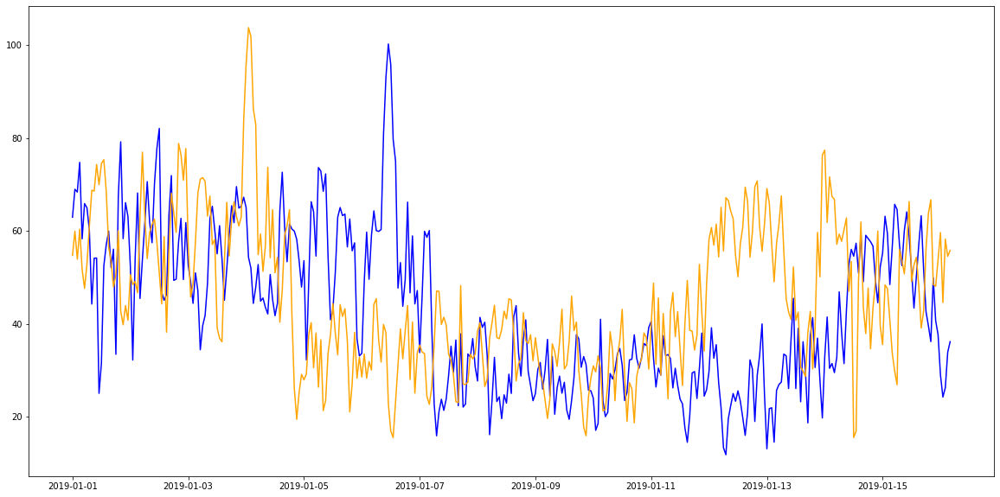

SAMPLED BY:  W


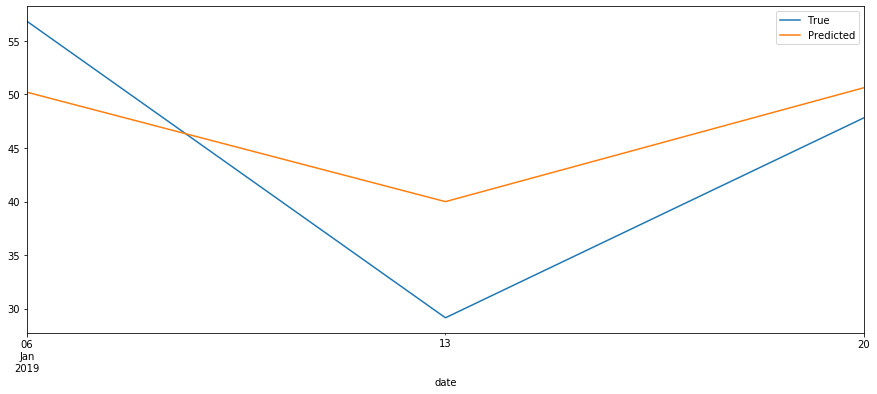

SAMPLED BY:  MS


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


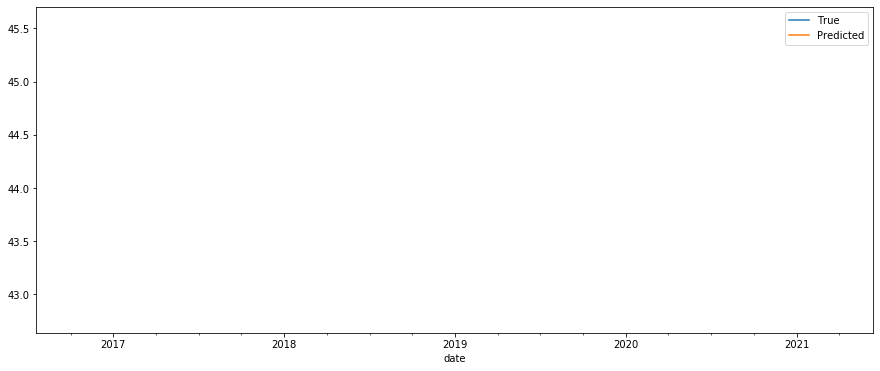

SAMPLED BY:  Q


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


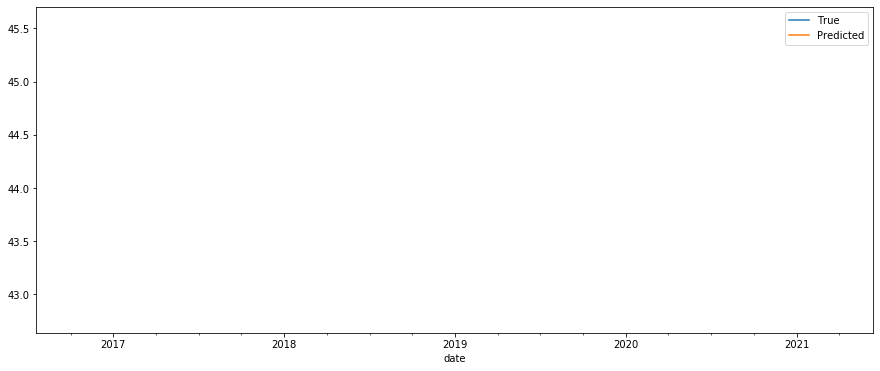

batch1-epochs30-neurons-8-resampledDay/results_lstm_u_model_PM25_st0.txt (365, 3)
shown RMSE: 15.039


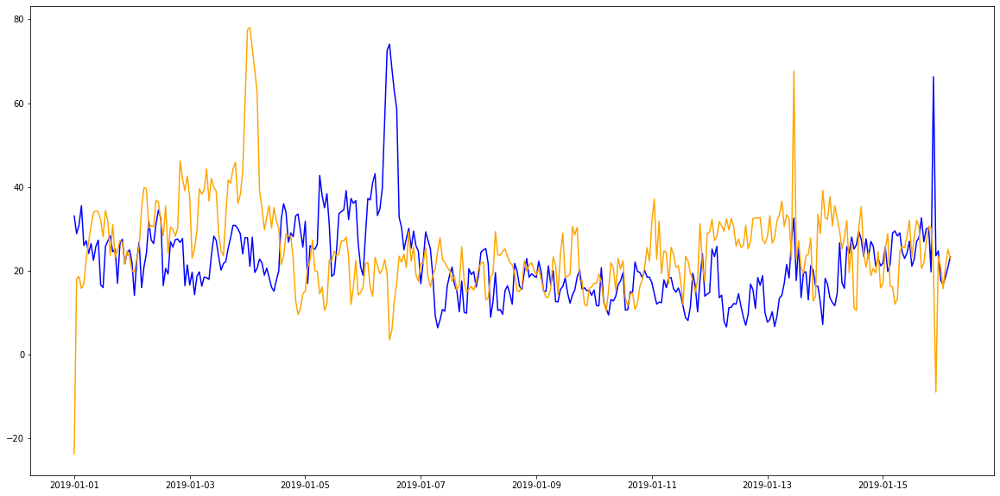

SAMPLED BY:  W


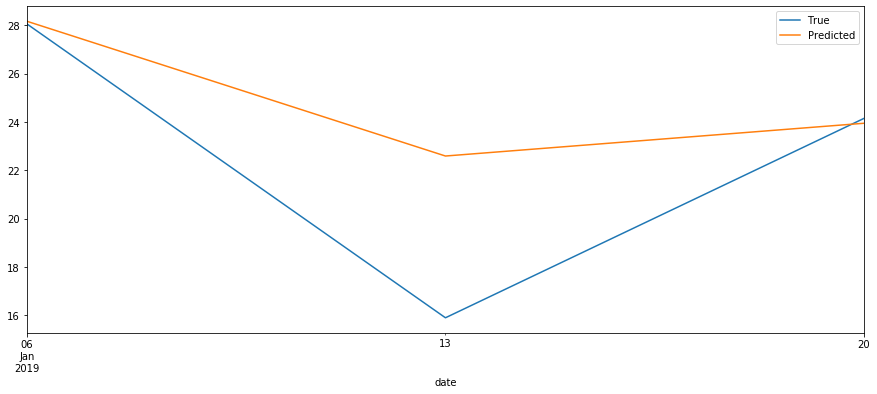

SAMPLED BY:  MS


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


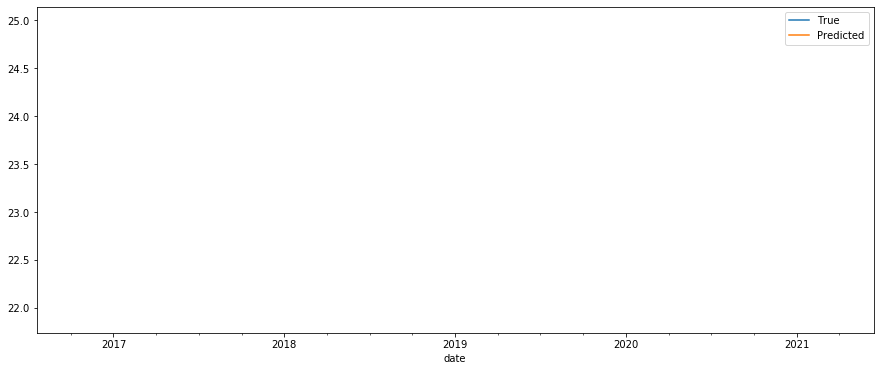

SAMPLED BY:  Q


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


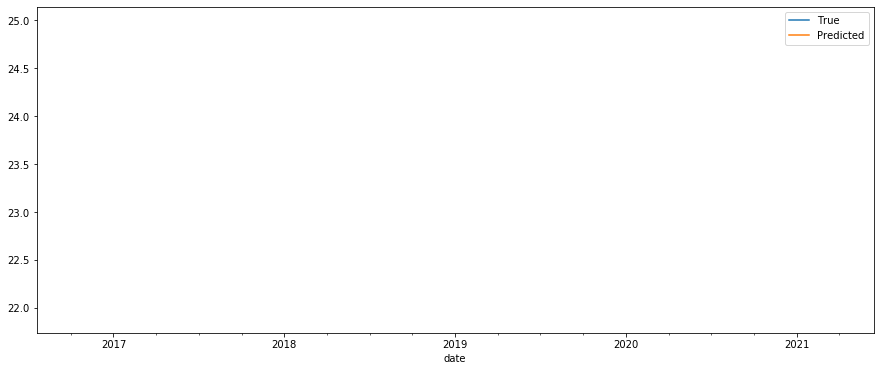

batch1-epochs30-neurons-8-resampledDay/results_lstm_u_model_PMCO_st0.txt (365, 3)
shown RMSE: 12.386


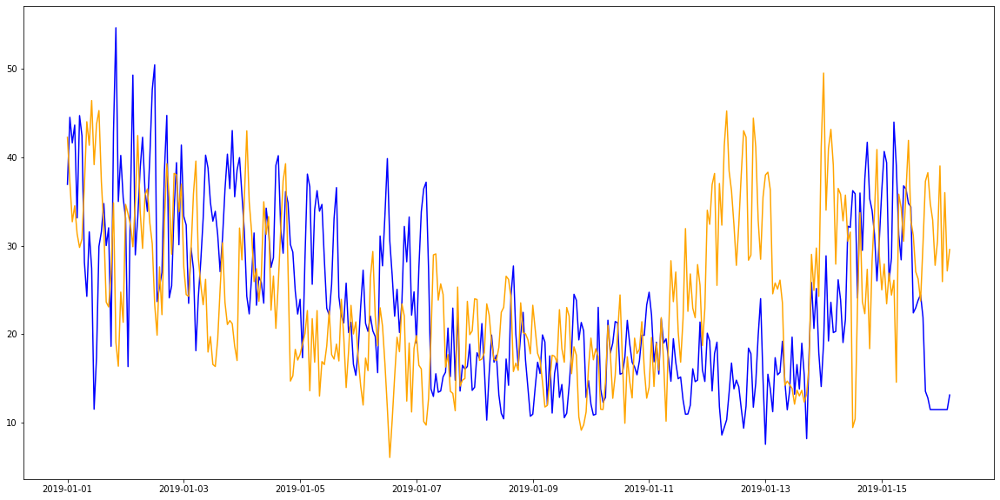

SAMPLED BY:  W


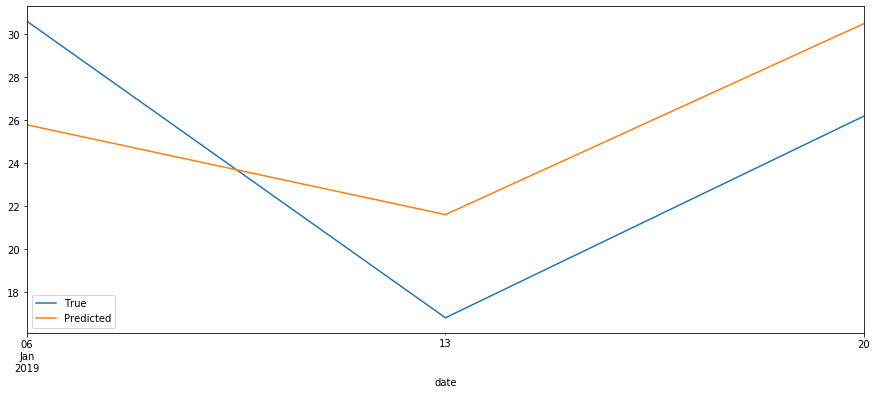

SAMPLED BY:  MS


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


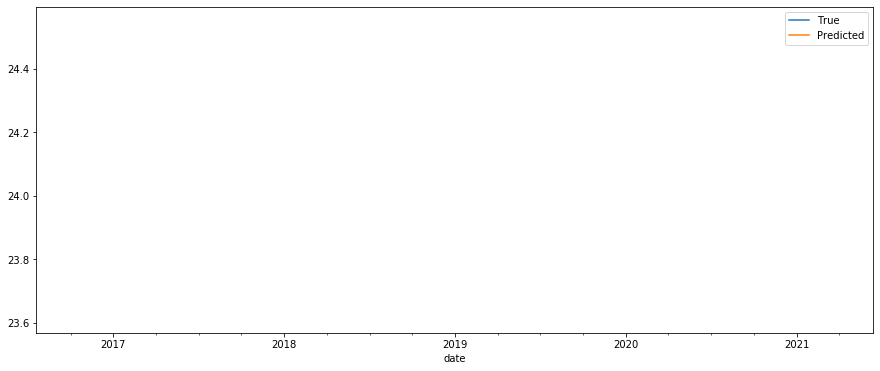

C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


SAMPLED BY:  Q


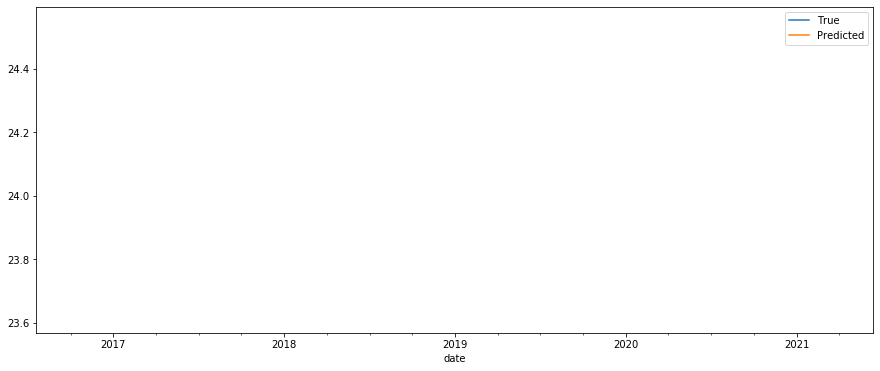

batch1-epochs30-neurons-8-resampledDay/results_lstm_u_model_SO2_st0.txt (365, 3)
shown RMSE: 3.178


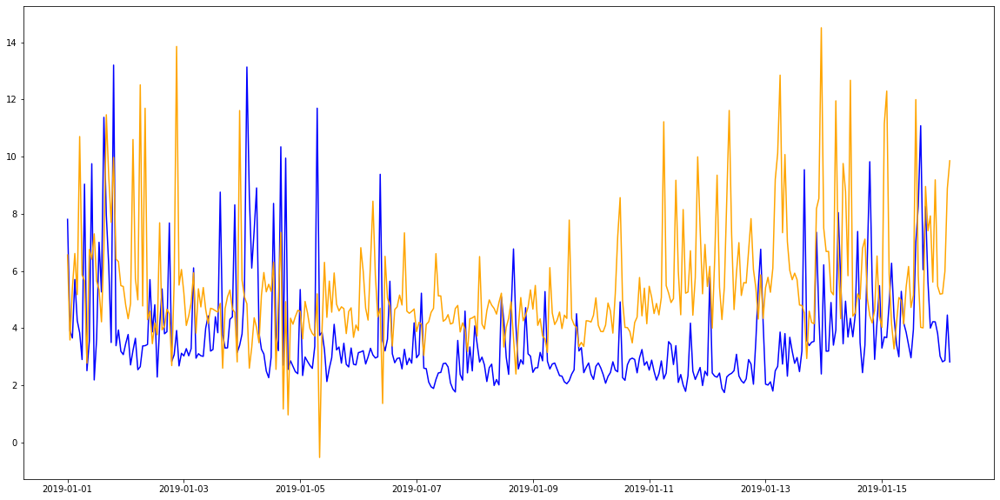

SAMPLED BY:  W


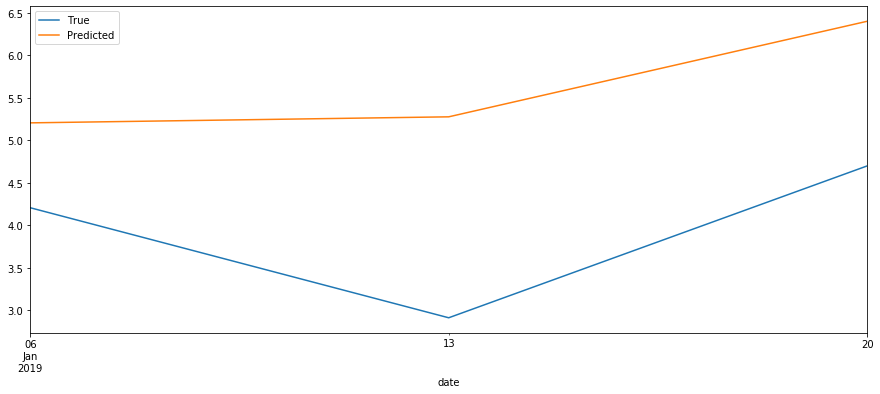

SAMPLED BY:  MS


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


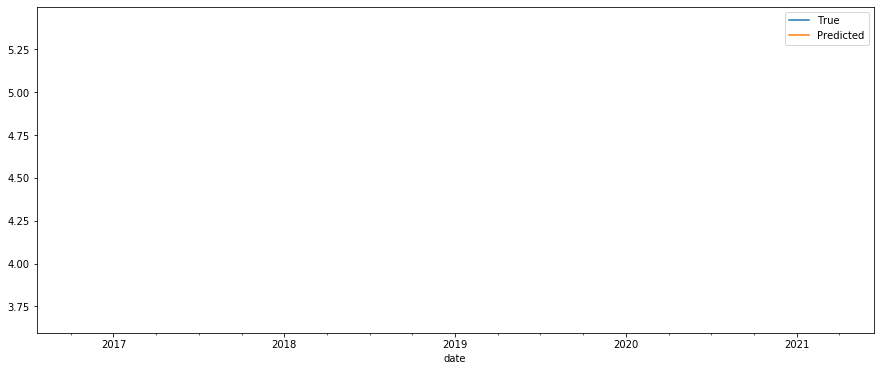

SAMPLED BY:  Q


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


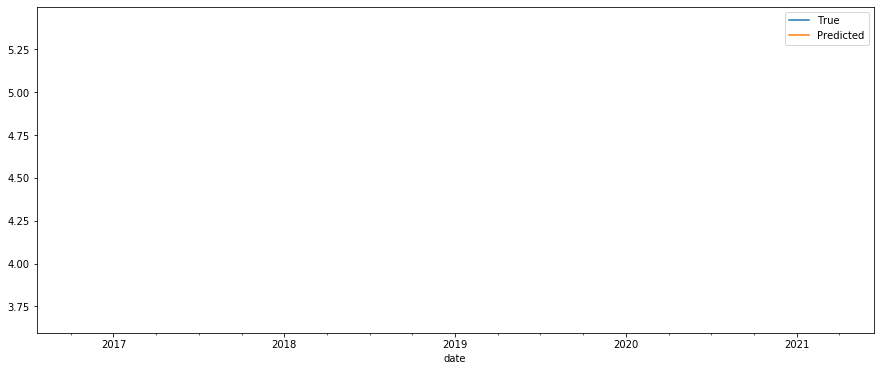

batch1-epochs30-neurons-8-resampledDay/results_lstm_u_model_RH_st0.txt (365, 3)
shown RMSE: 14.836


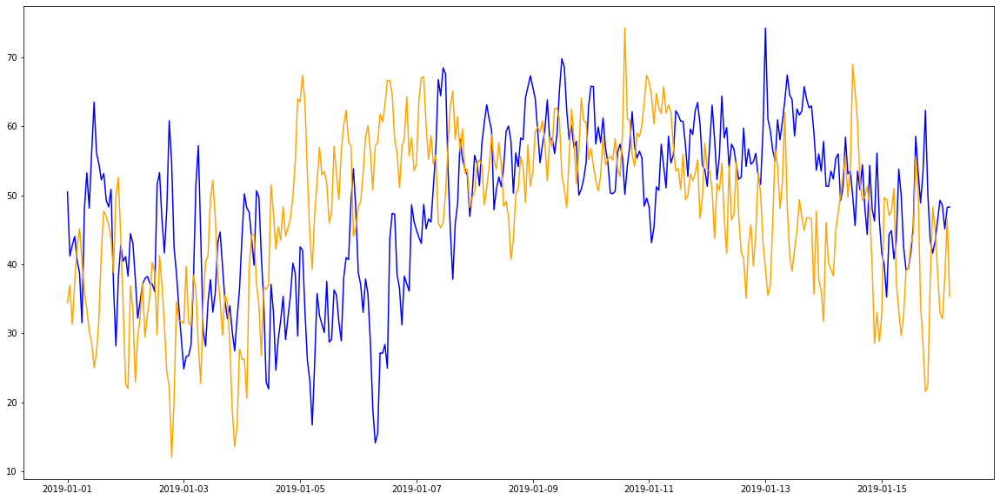

SAMPLED BY:  W


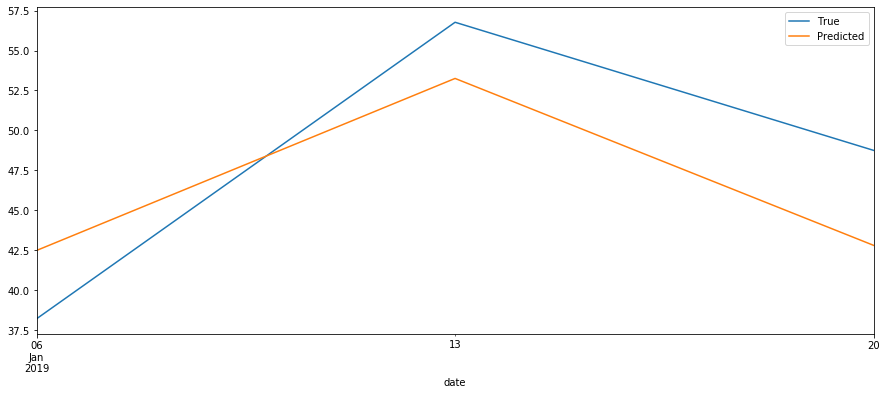

SAMPLED BY:  MS


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


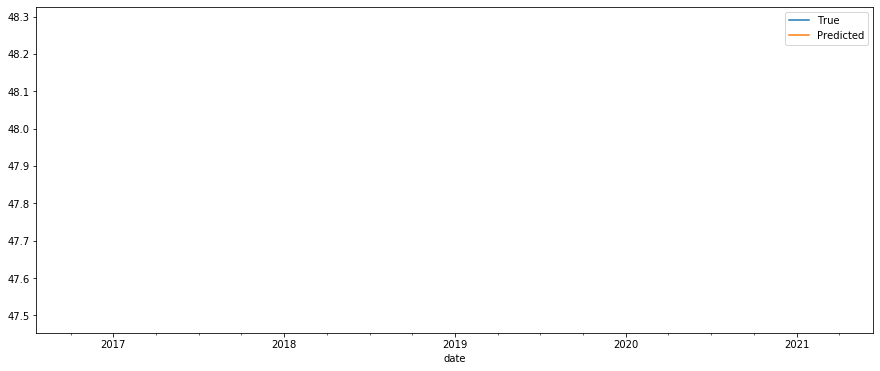

SAMPLED BY:  Q


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


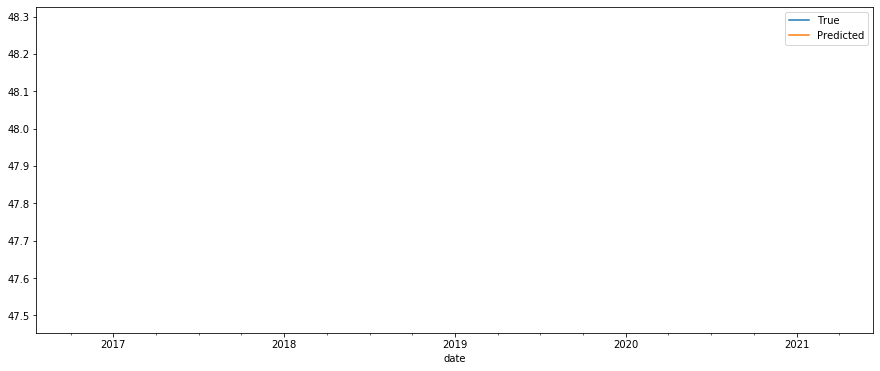

batch1-epochs30-neurons-8-resampledDay/results_lstm_u_model_TMP_st0.txt (365, 3)
shown RMSE: 2.542


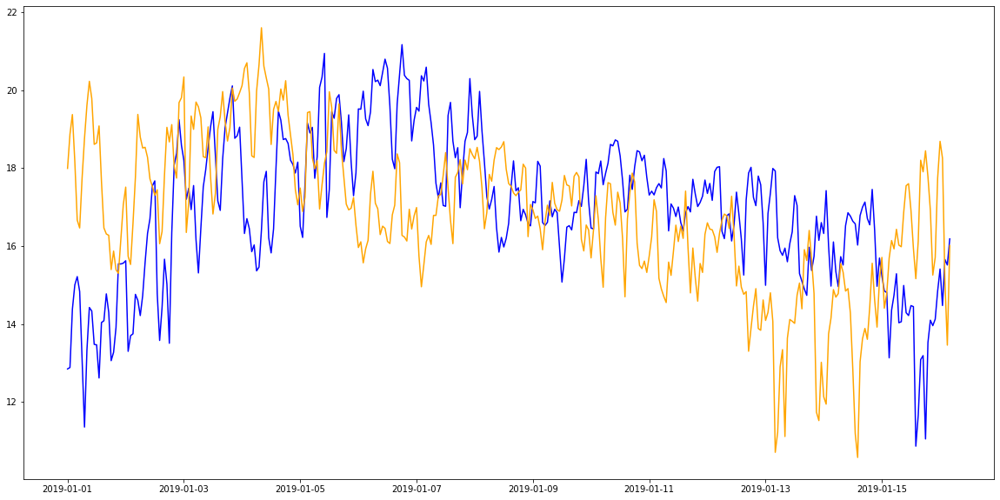

SAMPLED BY:  W


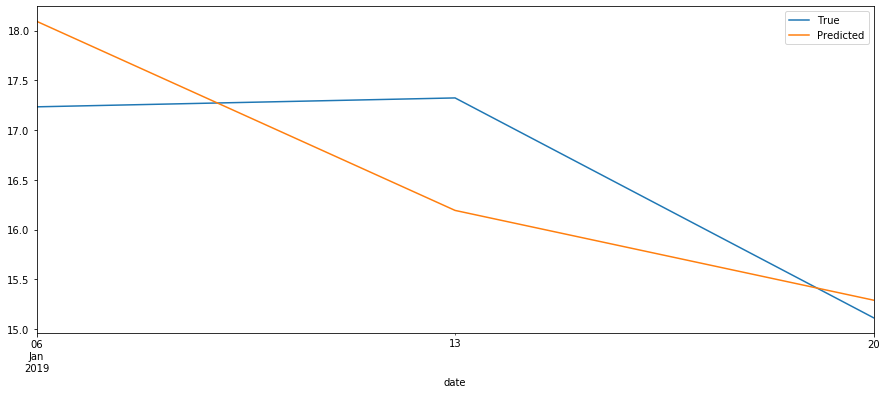

SAMPLED BY:  MS


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


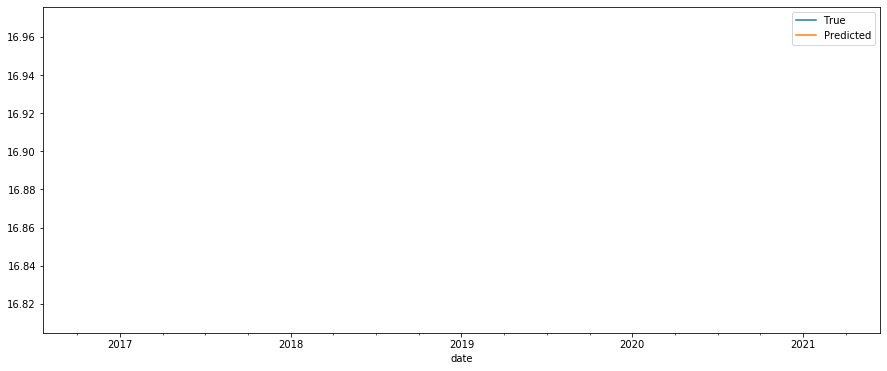

SAMPLED BY:  Q


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


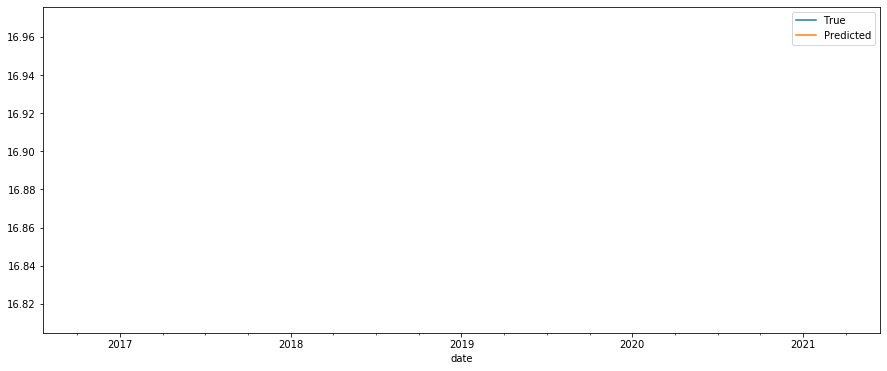

batch1-epochs30-neurons-8-resampledDay/results_lstm_u_model_WDR_st0.txt (365, 3)
shown RMSE: 31.234


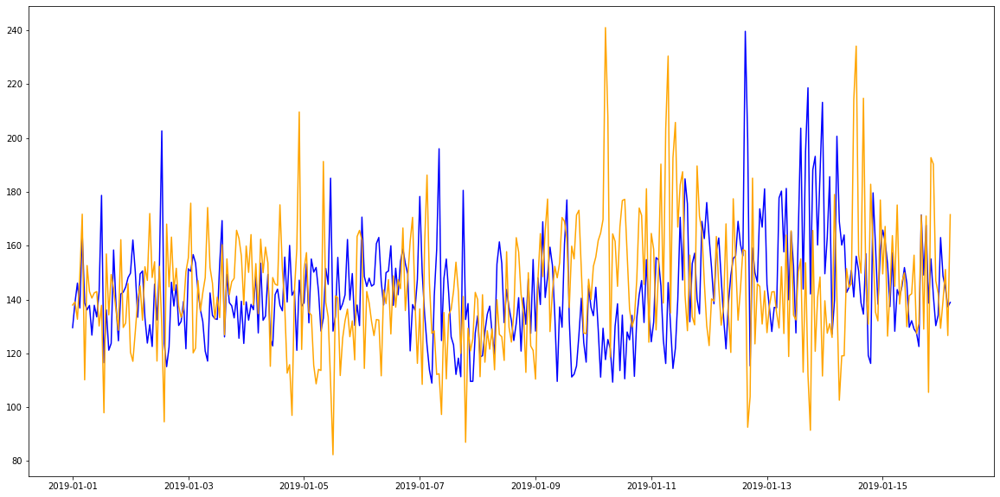

SAMPLED BY:  W


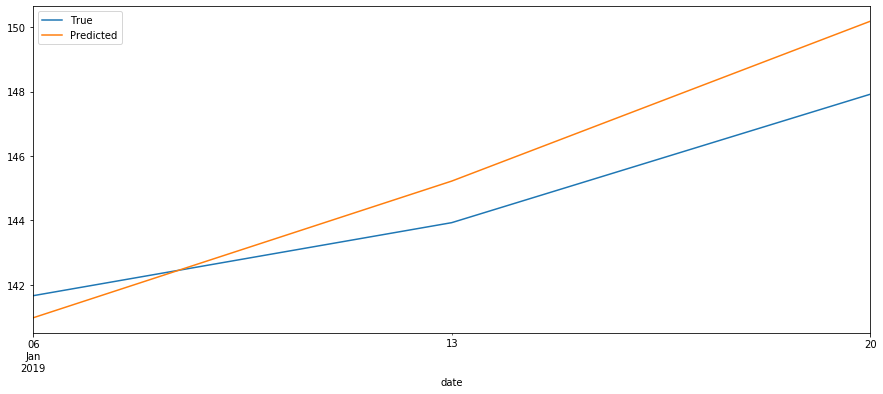

SAMPLED BY:  MS


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


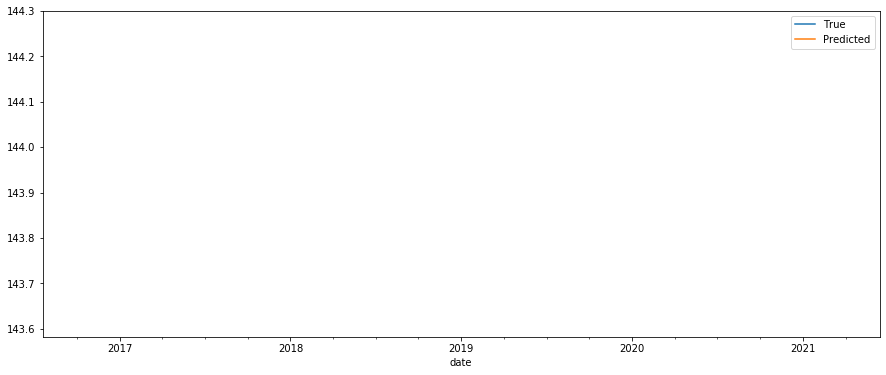

SAMPLED BY:  Q


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


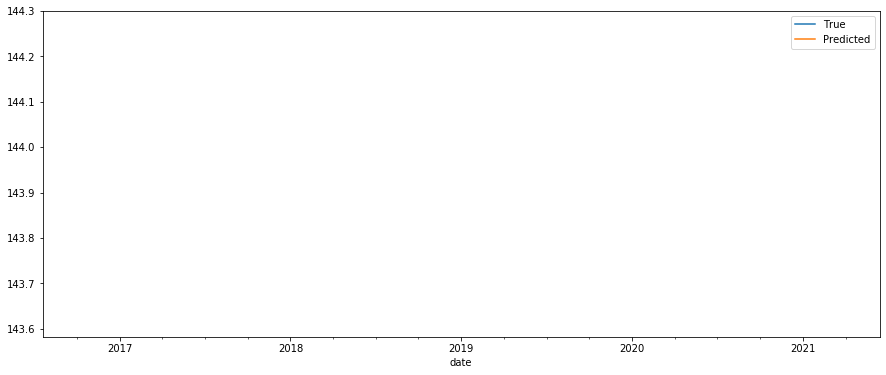

batch1-epochs30-neurons-8-resampledDay/results_lstm_u_model_WSP_st0.txt (365, 3)
shown RMSE: 0.726


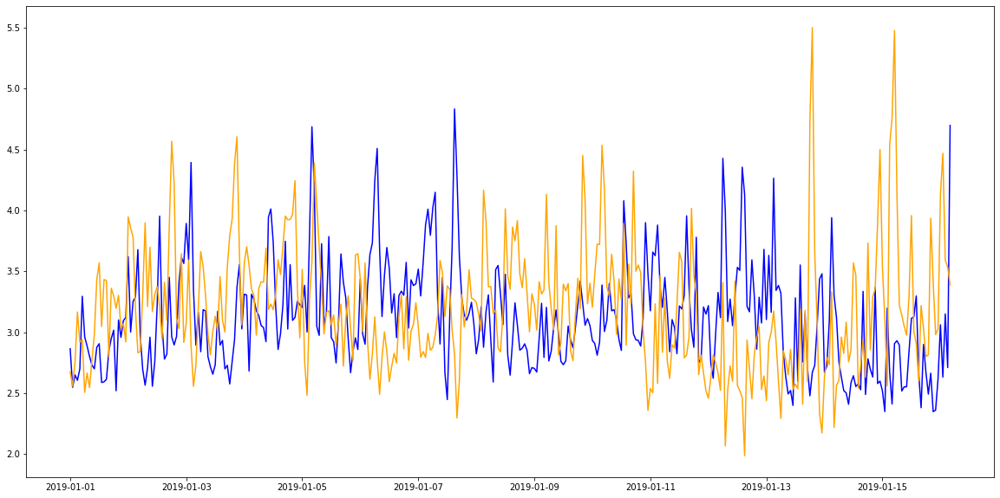

SAMPLED BY:  W


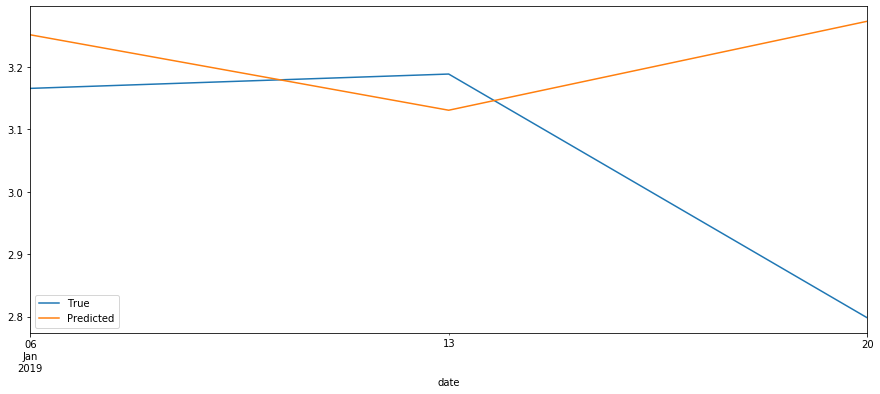

SAMPLED BY:  MS


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


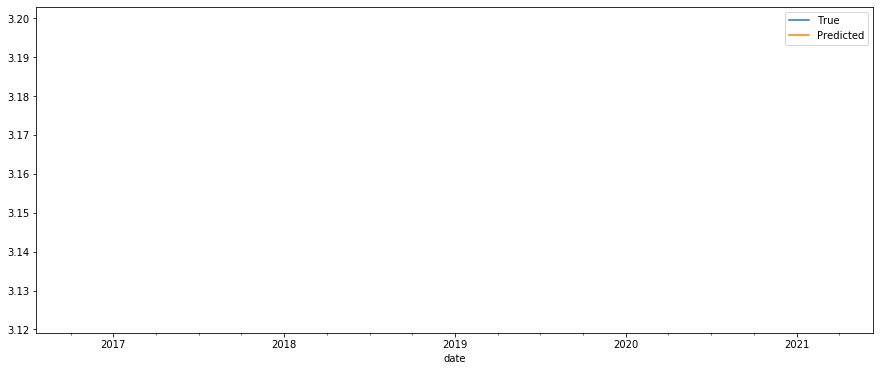

SAMPLED BY:  Q


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


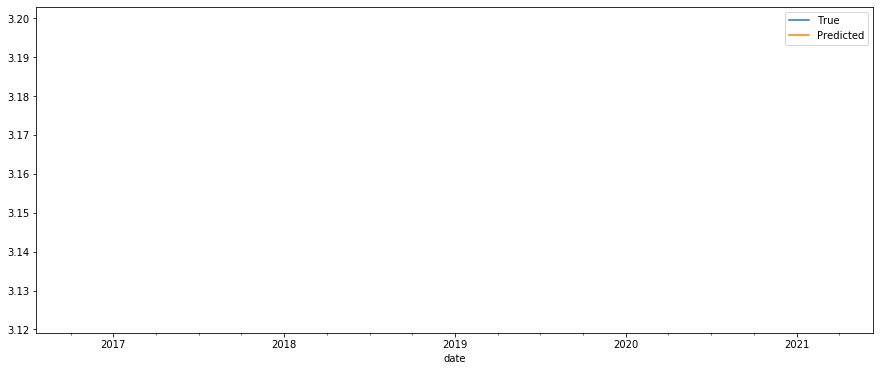

batch1-epochs30-neurons-8-resampledDay/results_lstm_u_model_PA_st.txt (365, 3)
shown RMSE: 1.760


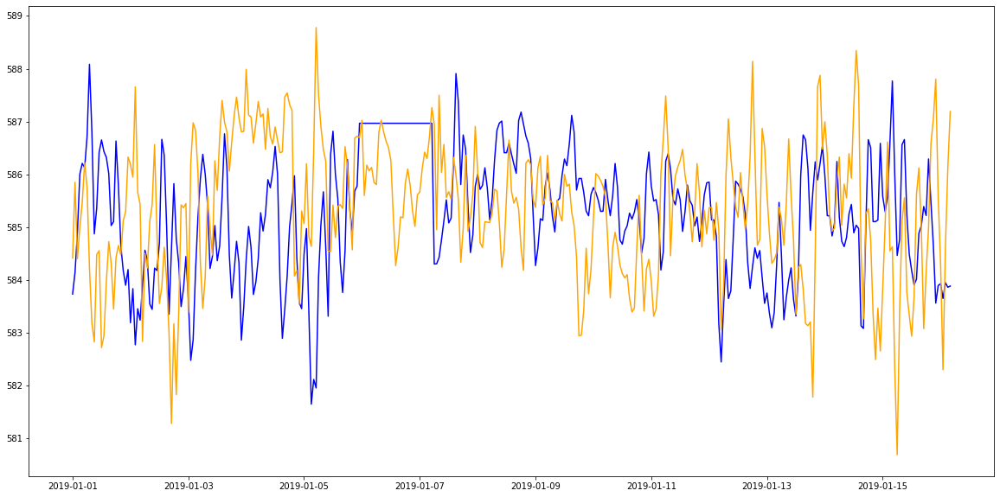

SAMPLED BY:  W


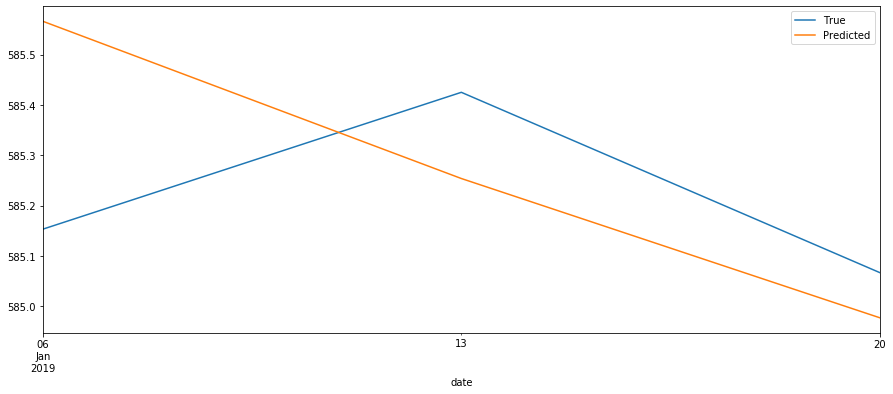

SAMPLED BY:  MS


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


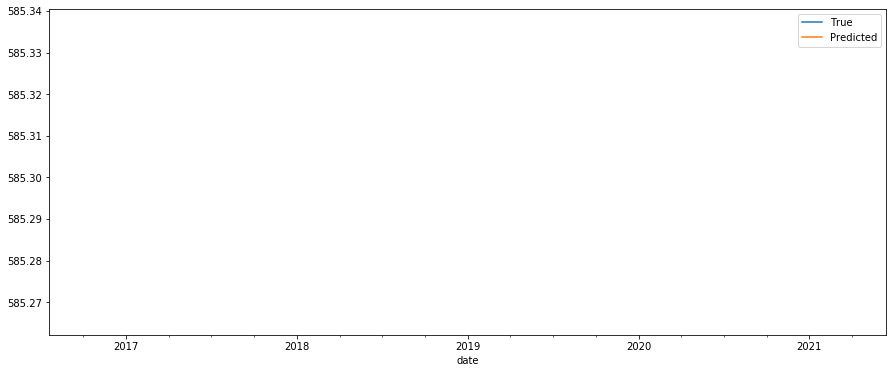

SAMPLED BY:  Q


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


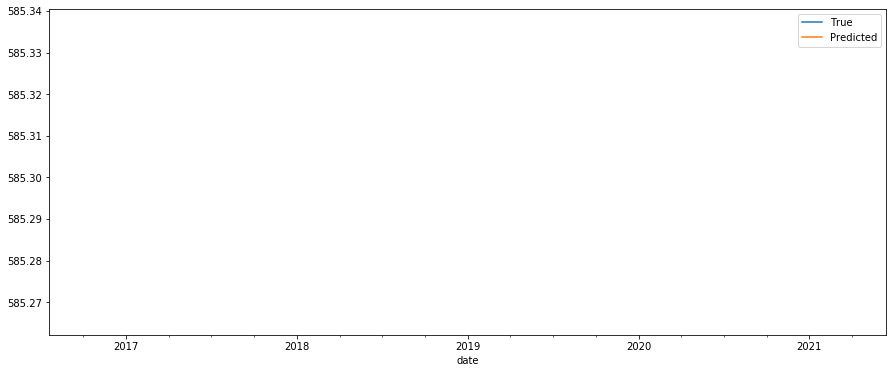

batch1-epochs30-neurons-8-resampledDay/results_lstm_u_model_UVA_st.txt (365, 3)
shown RMSE: 0.474


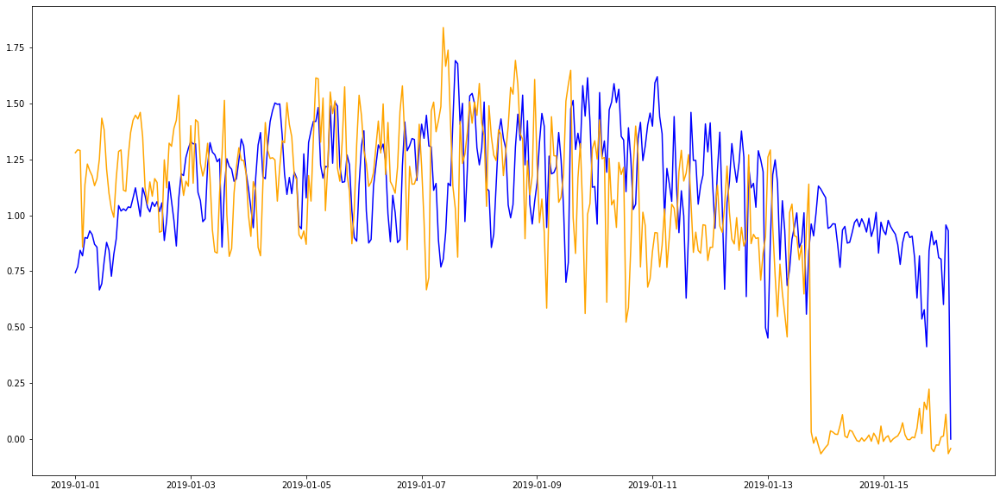

SAMPLED BY:  W


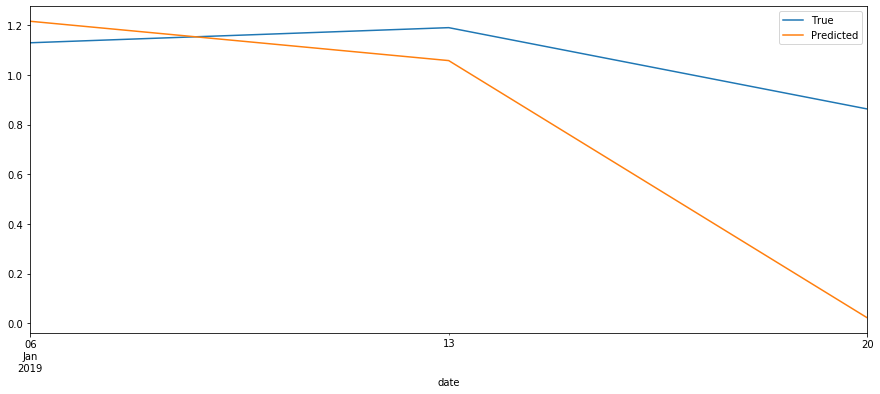

SAMPLED BY:  MS


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


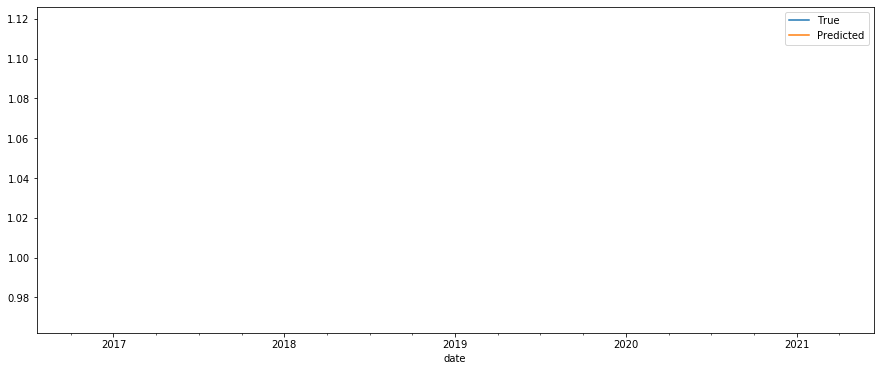

SAMPLED BY:  Q


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


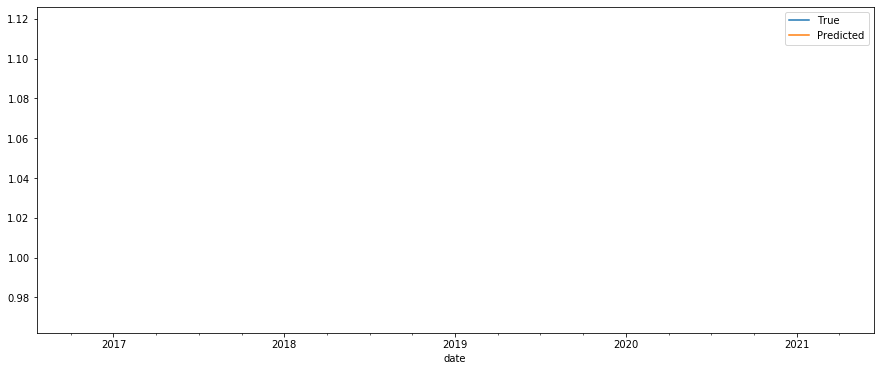

batch1-epochs30-neurons-8-resampledDay/results_lstm_u_model_UVB_st.txt (365, 3)
shown RMSE: 0.423


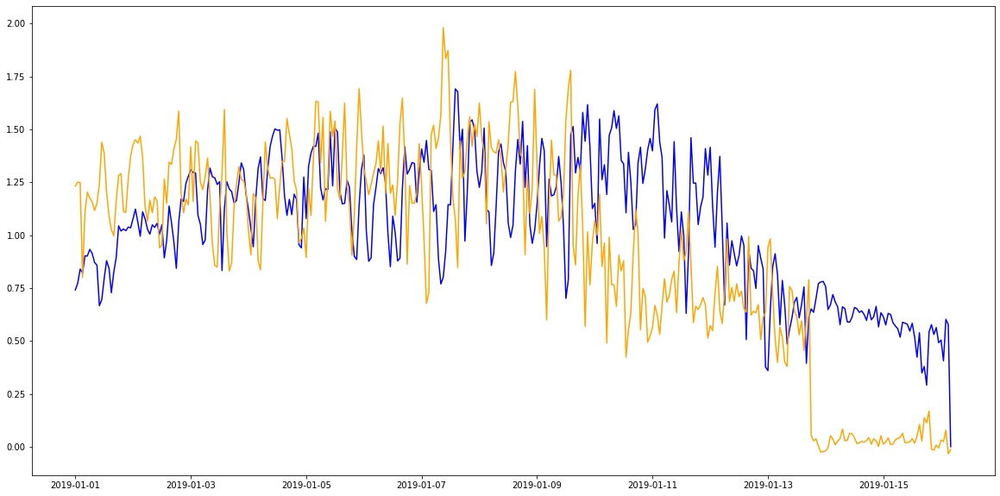

SAMPLED BY:  W


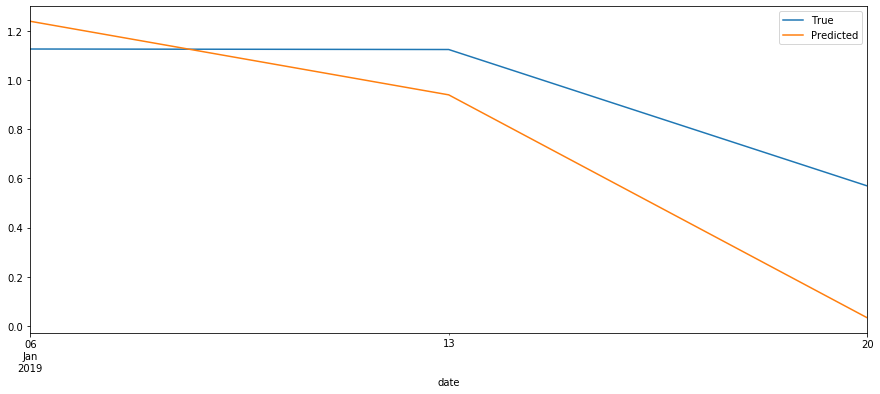

SAMPLED BY:  MS


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 588.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


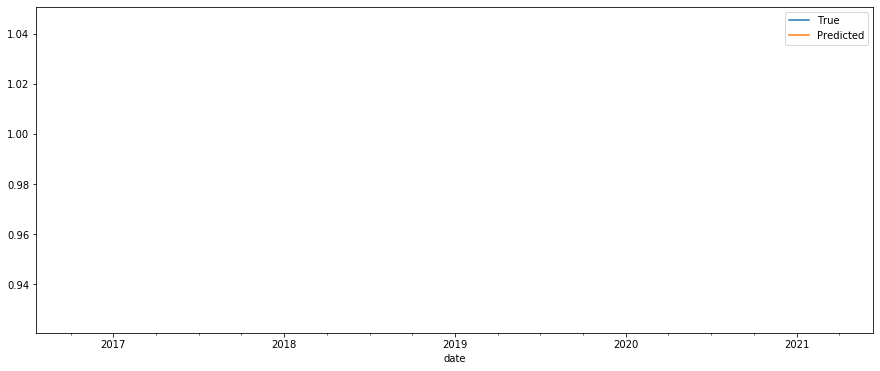

SAMPLED BY:  Q


C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)
C:\ProgramData\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:1085: UserWarning: Attempting to set identical left == right == 196.0 results in singular transformations; automatically expanding.
  ax.set_xlim(left, right)


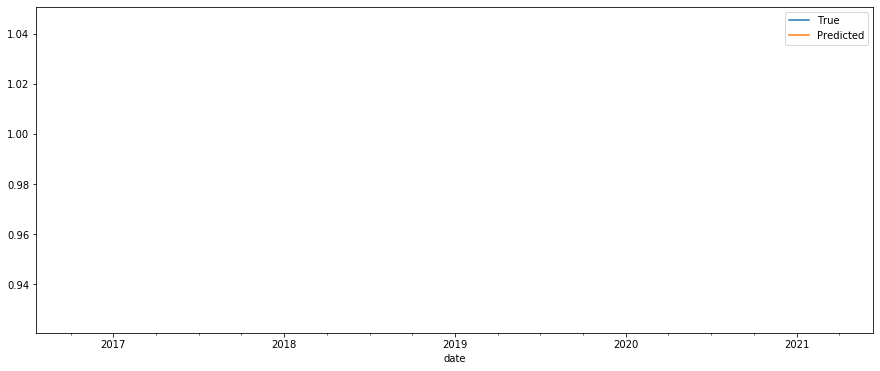

In [18]:
import csv

def plot_results(df, col1, col2):
    plt.figure(figsize=(20,10))
    plt.plot(df[col1], color='blue')
    plt.plot(df[col2], color='orange')
    print('shown RMSE: %.3f' % mean_squared_error(df[col1], df[col2])** 0.5 )
    plt.show()


def plot_resample_date(df,start_date,end_date, cols, resample_by):
    df[start_date:end_date][cols].resample(resample_by).mean().plot(figsize=(15, 6))
    plt.show()    
    
def read_results(txtfilename): 
    with open(filename,"r") as f:
        reader = csv.reader(f,delimiter = "\t")
        data = list(reader)
        row_count = len(data)
    df = pd.read_csv(filename, 
                     skiprows = [0,row_count-1], 
                     header=None, 
                     names=["id", "Predicted", "True"], 
                     delimiter= '\s+', 
                     index_col=False)    #skip last row
    df['Predicted'] = df['Predicted'].astype(float)
    df['True']      = df['True'].astype(float)
    df['date'] = pd.date_range(start=starting_date, freq='1H', periods=len(df))
    df.set_index('date', inplace=True)  
    return df
#
folders = ['batch1-epochs30-neurons-4','batch1-epochs30-neurons-4-resampledDay',
           'batch1-epochs30-neurons-8','batch1-epochs30-neurons-8-resampledDay']
lstm_univariate_models = ['CO_st0','NO_st0','NO2_st0', 'NOX_st0', 'O3_st0', 'PM10_st0', 'PM25_st0','PMCO_st0',
                         'SO2_st0', 'RH_st0','TMP_st0', 'WDR_st0', 'WSP_st0',   'PA_st', 'UVA_st',   'UVB_st'] 


starting_date = '2019-01-01'
for folder in folders:
    for m in lstm_univariate_models:
        filename = str(folder+"/results_lstm_u_model_"+m+".txt")
        df = read_results(filename)
        print(filename, df.shape)
        plot_results(df,'True', 'Predicted' )
        for s in ['W', 'MS', 'Q']:
            print("SAMPLED BY: ", s)
            plot_resample_date(df,str(2019),str(2019) ,[ 'True', 'Predicted'], s )

# Forecasting out of sample 

There are at least four commonly used strategies for making multi-step forecasts.

    Direct Multi-step Forecast Strategy.
    Recursive Multi-step Forecast Strategy.
    Direct-Recursive Hybrid Multi-step Forecast Strategies.
    Multiple Output Forecast Strategy.

The direct method involves developing a separate model for each forecast time step. It implies a lot computational power and space. Complexity increases especially as the number of time steps to be forecasted increases beyond the trivial.

The recursive strategy involves using a one-step model multiple times where the prediction for the prior time step is used as an input for making a prediction on the following time step. Because predictions are used in place of observations, the recursive strategy allows prediction errors to accumulate such that performance can quickly degrade as the prediction time horizon increases.

The direct and recursive strategies can be combined to offer the benefits of both methods. For example, a separate model can be constructed for each time step to be predicted, but each model may use the predictions made by models at prior time steps as input values.

The multiple output strategy involves developing one model that is capable of predicting the entire forecast sequence in a one-shot manner. Multiple output models are more complex as they can learn the dependence structure between inputs and outputs as well as between outputs.

We decide using recursive strategy for simplicity and because we consider that climate varies hourly and it will be difficult to find patterns in structures for a given time. Also, other problem found on oher strategies is that a different model has to be computed for a different lag, this raises the problem complexity.


## Multi step forecast (predicting the future)

Forecast out of sample unknown data
The lstm univariate model was trained using **7 years**, so in order to get future values, for instance
havig data for hours: **1,2,3,4,5,6,7,8...** If we want to predict next **9th, 10th, 11th...**
data points.
The idea is as follows
The model expects **5557*24 = n inputs to predict 1 output**, and those inputs are the prior obs, then:

`X = asarray([[[0],[1],[2],[3],...,[n]]])`

and get future value like:

`n+1 = model.predict(X)` 

this will yield forecasting value, then we move the frame like:

`X = asarray([[    [1],[2],[3],...,[n],[n+1]]])`

get second future value like:

`n+2 = model.predict(X)` 

then:

`X = asarray([[        [2],[3],...,[n],[n+1],[n+2]]])`

then:

`X = asarray([[            [3],...,[n],[n+1],[n+2],[n+3]]])`

we keep on doing this m times:

`X = asarray([[ [n-m],...,[n+2],[n-1],[n],[n+1],[n+2],[n+3],...,[n+m]]])`


    



In [21]:
#adds new element and removes the first element
def update_series_for_univariate_lstm(series, new_value):
    series = series.drop(series.index[0])
    series = series.append(pd.Series(new_value), len(series)) 
    return series  

def update_np_array_for_univariate_lstm(arr, new_value):
    del_arr = np.delete(arr,0, axis=0)    
    del_arr = np.append (del_arr, new_value)
    return del_arr  

aaa = np.array([1, 2, 3, 4])
print(aaa)
aaa = update_np_array_for_univariate_lstm(aaa,50)
print(aaa)
aaa = update_np_array_for_univariate_lstm(aaa,60)
print(aaa)
aaa = update_np_array_for_univariate_lstm(aaa,70)
print(aaa)
aaa = update_np_array_for_univariate_lstm(aaa,80)
print(aaa)

xtest_update = pd.Series(np.random.randn(3))
print(xtest_update)
xtest_update = update_series_for_univariate_lstm(xtest_update, 0.0)
print(xtest_update)
xtest_update = update_series_for_univariate_lstm(xtest_update, 1.0)
print(xtest_update)
xtest_update = update_series_for_univariate_lstm(xtest_update, 2.0)
print(xtest_update)
xtest_update = update_series_for_univariate_lstm(xtest_update, 3.0)
print(xtest_update)

[1 2 3 4]
[ 2  3  4 50]
[ 3  4 50 60]
[ 4 50 60 70]
[50 60 70 80]
0   -1.807084
1   -0.092394
2   -0.725844
dtype: float64
0   -0.092394
1   -0.725844
2    0.000000
dtype: float64
0   -0.725844
1    0.000000
2    1.000000
dtype: float64
0    0.0
1    1.0
2    2.0
dtype: float64
0    1.0
1    2.0
2    3.0
dtype: float64


In [20]:
def univariate_lstm_future(lstm_univariate_model, 
                           start_future, 
                           known_current_data, 
                           step_to_predict_future):
    #future
    future_predictions = list()   
    days_to_train  = 2557
    training_hours = days_to_train*24
    for i in range(step_to_predict_future):
        # transform data to be stationary
        _diff_values = difference(known_current_data, 1)
        # transform data to be supervised learning
        _supervised = timeseries_to_supervised(_diff_values, 1)
        _supervised_values = _supervised.values

        _train, _test = _supervised_values[:training_hours], _supervised_values[0]
        # fit scaler
        _scaler = MinMaxScaler(feature_range=(-1, 1))
        _scaler = _scaler.fit(_train)
        # transform train
        _train = _train.reshape(_train.shape[0], _train.shape[1])
        _train_scaled = _scaler.transform(_train)
        # make one-step forecast
        __X, __y = _train_scaled[i, 0:-1], _train_scaled[i, -1]
        _yhat = forecast_lstm(lstm_univariate_model, 1, __X)
        # invert scaling
        _yhat = invert_scale(_scaler, __X, _yhat)
        # invert differencing
        _yhat = inverse_difference(known_current_data, _yhat, len(_train_scaled)+1) #-i

        # store forecast
        future_predictions.append(_yhat)
        
        #adjust framing
        known_current_data = update_np_array_for_univariate_lstm(known_current_data, _yhat)
        
    #create dataframe with future data and corresponfing date
    dtf = pd.DataFrame (future_predictions, columns = ['Future'])
    dtf['date'] = pd.date_range(start=start_future, freq='1H', periods=len(future_predictions))
    dtf.set_index('date', inplace=True)
    return dtf 


# Loading model and use it to predict out of sample 

### NOTE As the way the model is defined, an input sequence of size (days of training*24) must be provided in order to predict one time step . This was the easiest way we could develop for the report. In fact several methods can be implemented and need to be compared.

The following method forecasts **n** hours in the future using the **lstm univariate model** that trained with 7 years and
is sampled by hour.

It needs the model (.pkl) file, the starting date in the future (out of sample date), it also needs
the known data (7 years of training data). For the app we will generate a smaller trained model (trained only by 2 years).  And the number of steps in the future in hours

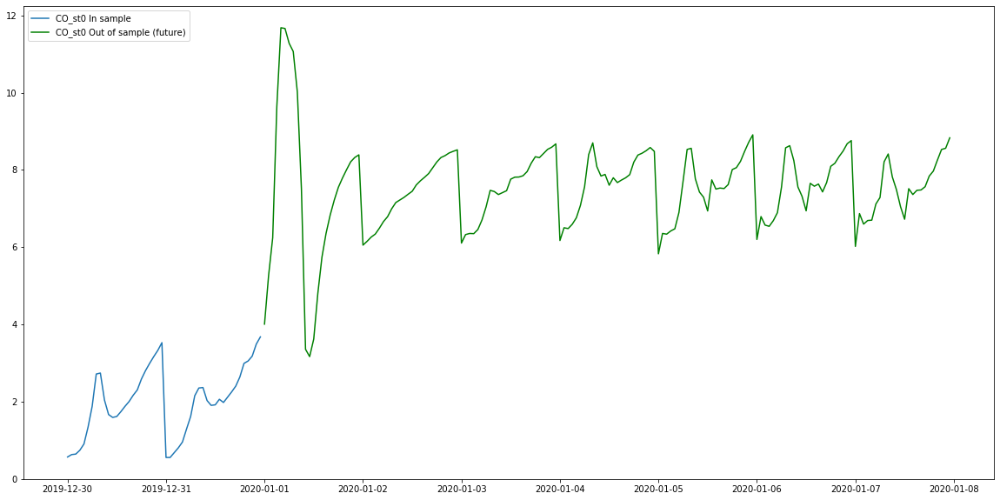

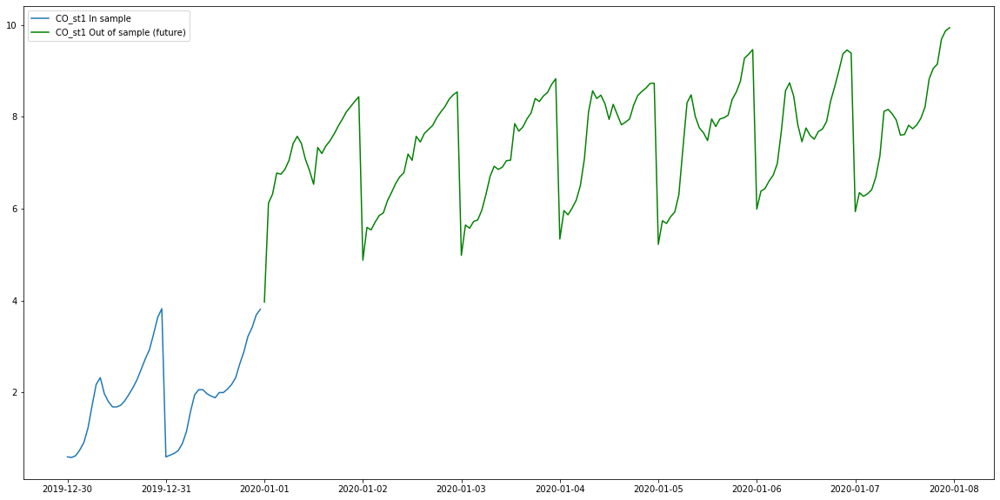

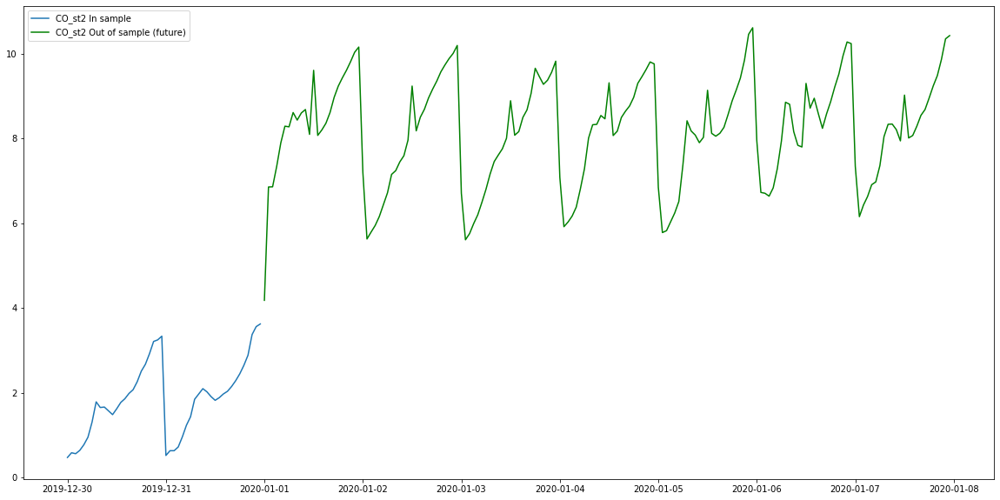

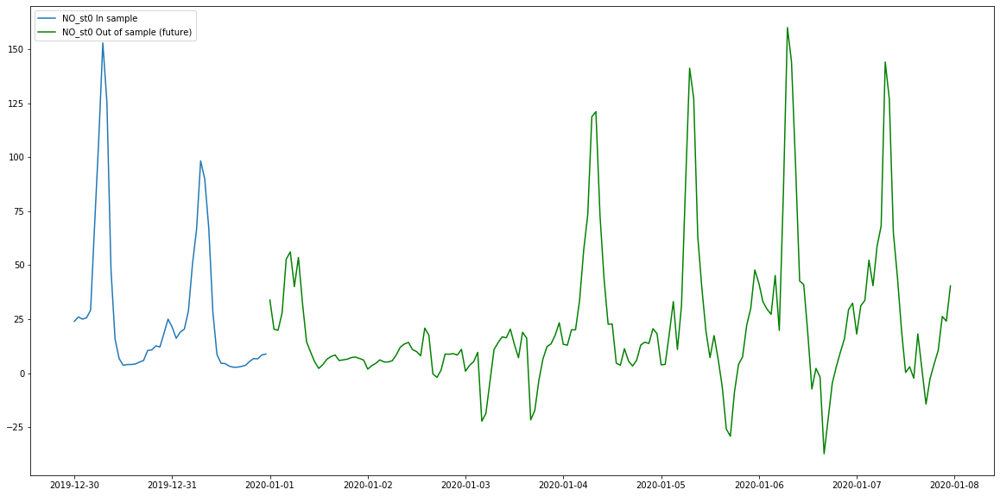

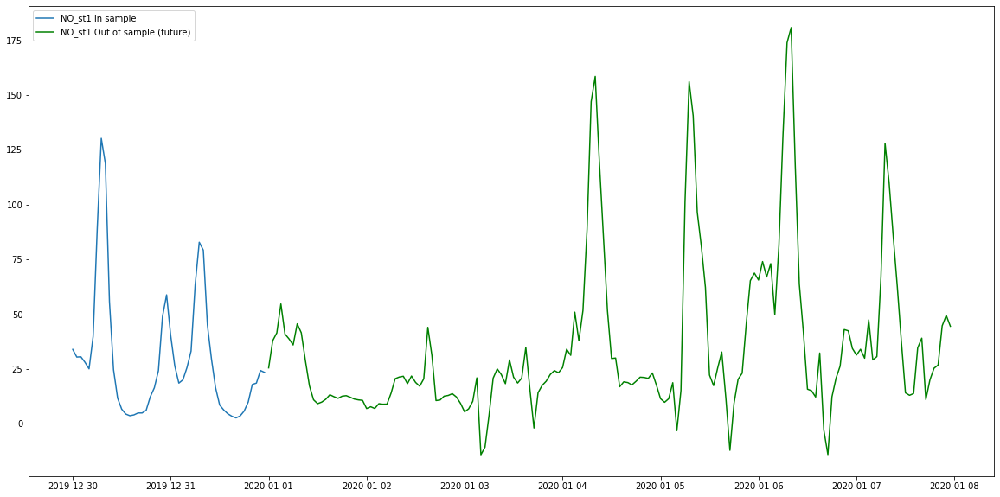

...

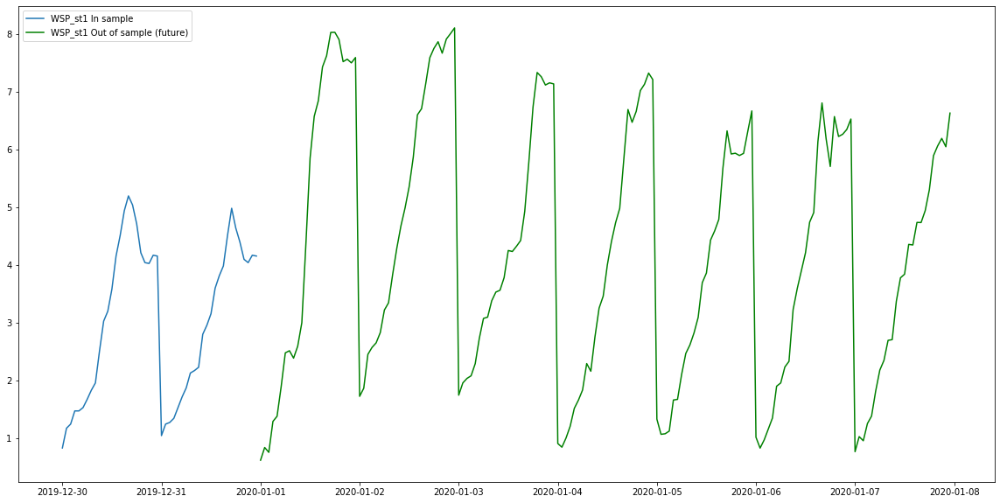

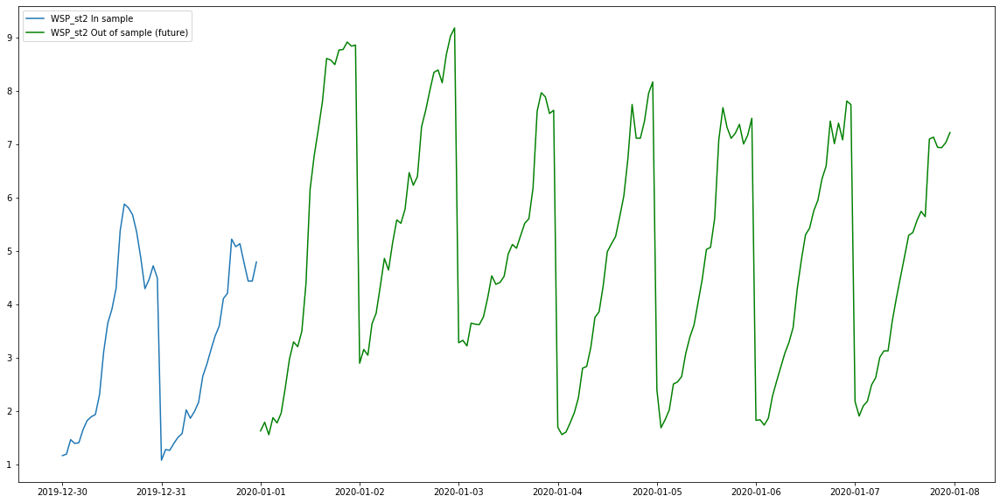

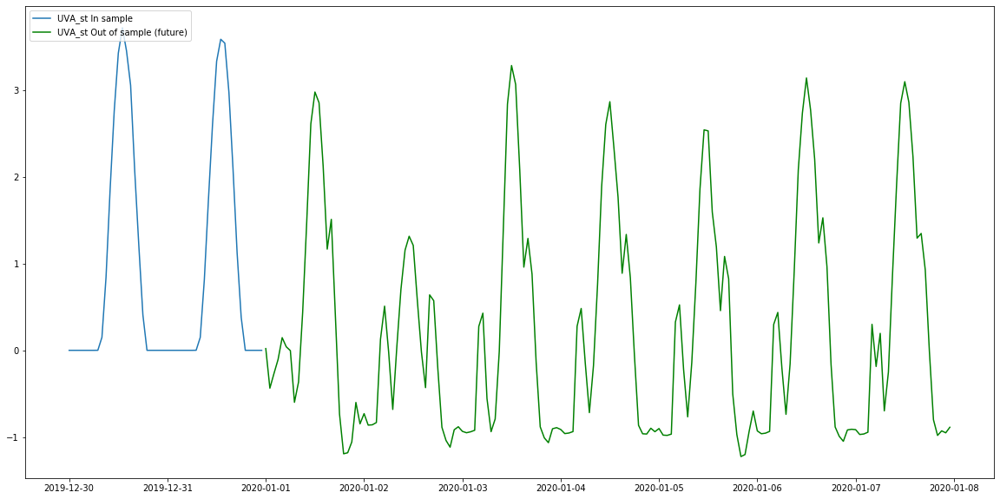

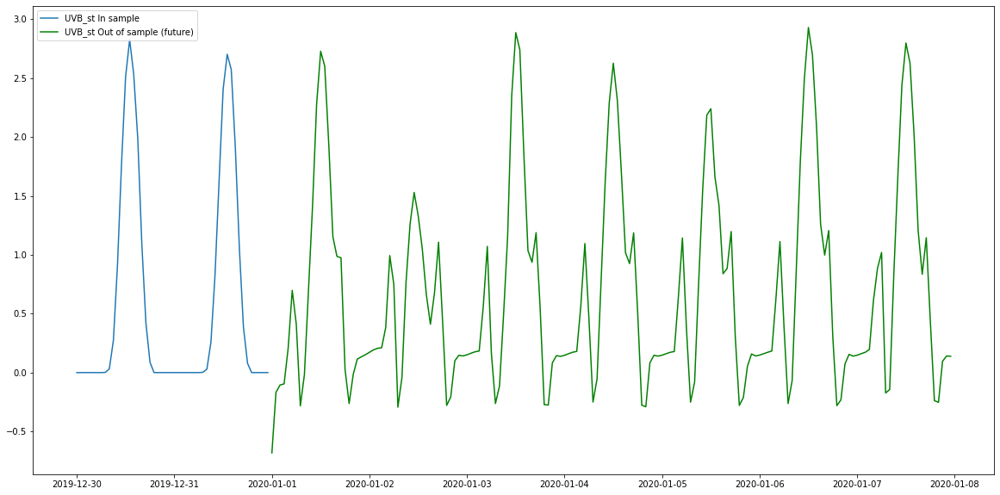

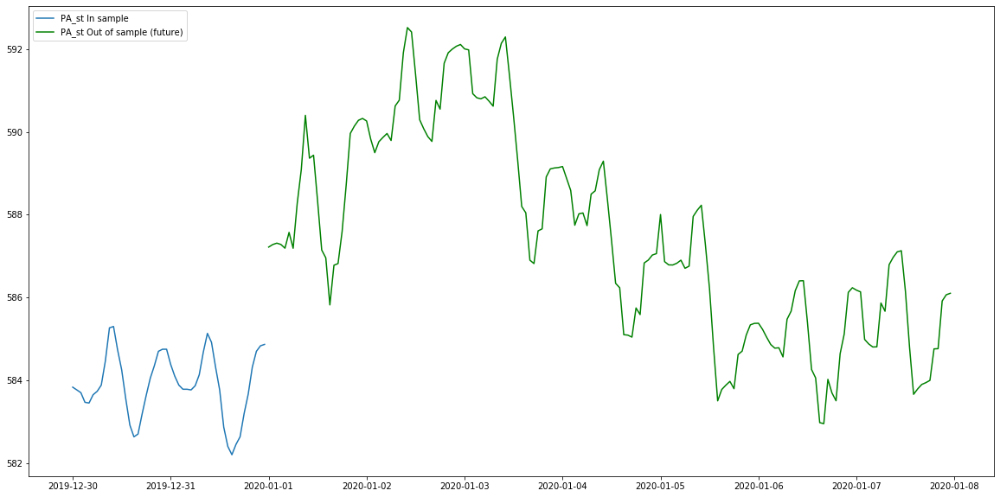

In [22]:
from keras.models import load_model
#do prediction for all data we have, for all 3 stations

future_starting_date = '2020-01-01 00:00:00'
days_in_the_future = 7
hours_in_the_future = 24 * days_in_the_future 

model_feature_dictionary = { "lstm_u_model_CO_st0":    ['CO_st0',   'CO_st1',   'CO_st2'],
                             "lstm_u_model_NO_st0":    ['NO_st0',   'NO_st1',   'NO_st2'],
                             "lstm_u_model_NO2_st0":   ['NO2_st0',  'NO2_st1',  'NO2_st2'],
                             "lstm_u_model_NOX_st0":   ['NOX_st0',  'NOX_st1',  'NOX_st2'],
                             "lstm_u_model_O3_st0" :   ['O3_st0',   'O3_st1',   'O3_st2'],
                             "lstm_u_model_PM10_st0" : ['PM10_st0', 'PM10_st1', 'PM10_st2'],
                             "lstm_u_model_PM25_st0" : ['PM25_st0', 'PM25_st1', 'PM25_st2'],
                             "lstm_u_model_PMCO_st0" : ['PMCO_st0', 'PMCO_st1', 'PMCO_st2'],
                             "lstm_u_model_SO2_st0"  : ['SO2_st0',  'SO2_st1',  'SO2_st2'],
                             "lstm_u_model_RH_st0"   : ['RH_st0',   'RH_st1',   'RH_st2'],
                             "lstm_u_model_TMP_st0"  : ['TMP_st0',  'TMP_st1',  'TMP_st2'],
                             "lstm_u_model_WDR_st0"  : ['WDR_st0',  'WDR_st1',  'WDR_st2'],
                             "lstm_u_model_WSP_st0"  : ['WSP_st0',  'WSP_st1',  'WSP_st2'],
                             "lstm_u_model_UVA_st"   : ['UVA_st'],
                             "lstm_u_model_UVB_st"   : ['UVB_st'],
                             "lstm_u_model_PA_st"    : ['PA_st']
                           }


for m_feature in model_feature_dictionary:
    #load pkl 
    model_file_name = str("batch1-epochs30-neurons-8/"+m_feature+".pkl")
    loaded_model = load_model(model_file_name)
    
    for feature in model_feature_dictionary[m_feature] : 
        
        future_univariate_lstm = univariate_lstm_future(loaded_model, 
                                   future_starting_date, 
                                   df_workspace[feature].values[0:train_hours_u_lstm+1], 
                                   hours_in_the_future)

        plt.figure(figsize=(20,10))
        
        plt.plot(df_workspace[feature]['2019-12-30 00:00:00':'2019-12-31 23:00:00'], label= feature + " In sample")
        plt.plot(future_univariate_lstm, color='green', label= feature + " Out of sample (future)")
        plt.legend(loc="upper left")
        plt.show()

In [ ]:
''' '''